# MRI Based Tumor Images

#### Background Content:
##### Data source: https://www.kaggle.com/datasets/mhantor/mri-based-brain-tumor-images, License: CC BY-NC-SA 4.0, Python Image handling Tutorial Video: Rob Mullen, source: https://www.youtube.com/watch?v=kSqxn6zGE0c, Modelling Guidance Video: https://www.youtube.com/watch?v=il8dMDlXrIE

## Content:
### 1) Imported Packages and Common Use Functions
### 2) Exploration of Data
### 3) Data Pre-Processing 
### 4) Modelling and Evaluation
### 5) Optimum Hyper-Parameters (GidSearchCV)
### 6) Performance Investigation and Increasing Transparency

## 1) Importing Packages and Common Use Functions

In [1]:
#!pip install opencv-python

In [115]:
### Imported packages

## Basic data manipulation and exploration
import pandas as pd

## Glob for image presentation
from glob import glob

## For taking samples of data
import random

## matplotlib.pyplot for graphical presentation, cv2 for image processing, resize for image downsizing
import matplotlib.pylab as plt
import cv2
from skimage.transform import resize

## Checking directory: needed for glob to work with your files (unless you know the path!)
import os

## Modelling tools: this project focuses only on the Multi-Layer Perceptron Classifier
## train_test_split, metrics for model analysis
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve
from itertools import chain #https://www.geeksforgeeks.org/python-ways-to-flatten-a-2d-list/. For data investigation

In [3]:
### Common use functions

### Plotting ROC curve and getting area under the curve
#### Code partly adapted from: https://www.w3schools.com/python/python_ml_auc_roc.asp
def roc_auc(y_real,y_pred,title):
    fpr, tpr, thresholds = roc_curve(y_real, y_pred)
    plt.plot(fpr, tpr)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(title)
    plt.show()
    print('Area under the above curve is: ',roc_auc_score(y_real, y_pred))
    
### Changing the labels of target class
def label_change(label_list):
    for i in label_list:
        for x in range(len(i)):
            if i[x]=='normal':
                i[x]=0
            else:
                i[x]=1
    return label_list[0],label_list[1]

In [4]:
### Checking current working directory
### os.getcwd()

## 2) Exploration of Data

In [5]:
## Glob creates a list of images that we can loop through
normal = glob('C://Users//Jan//Digital Futures Data Spell/Brain_tumor_images/Normal/*.jpg')
tumor = glob('C://Users//Jan//Digital Futures Data Spell/Brain_tumor_images/Tumor/*.jpg')

In [6]:
### There are two ways to open images, we will use both since the cv2 has a handy method for changing the image into gray 
### scale.
img_plt = plt.imread(normal[0])
img_cv2 = cv2.imread(normal[0])

In [7]:
img_plt

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)

In [8]:
### Note the shape: (height,width,channel). Channel is RGB (Red,Green,Blue).
### plt. method
print('Type: ',type(img_plt))
print('Shape: ',img_plt.shape)

Type:  <class 'numpy.ndarray'>
Shape:  (256, 256, 3)


In [9]:
### cv2. method
print('Type: ',type(img_cv2))
print('Shape: ',img_cv2.shape)

Type:  <class 'numpy.ndarray'>
Shape:  (256, 256, 3)


##### Maximum value
Based on this information, we could scale the data using a simple division (e.g. pixel value / 255). However, I opt to use MinMax scaler which brings avout the same result in terms of affecting the cost function for the model to converge (Sebastian Raschka?).

In [10]:
img_plt.max()

255

##### Distribution of Pixel Intensities (Pixel Values)

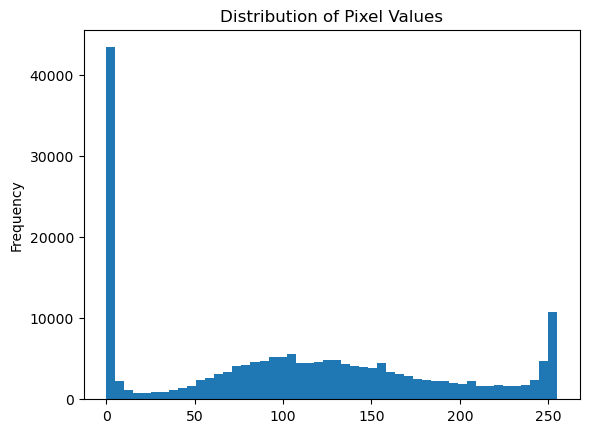

In [11]:
### We can visualise the pixel distribution for each image. I will use this later on to try and understand where the model
### makes errors.
pd.Series(img_plt.flatten()).plot(kind='hist', bins=50, title='Distribution of Pixel Values')
plt.show()

#### Displaying the Images

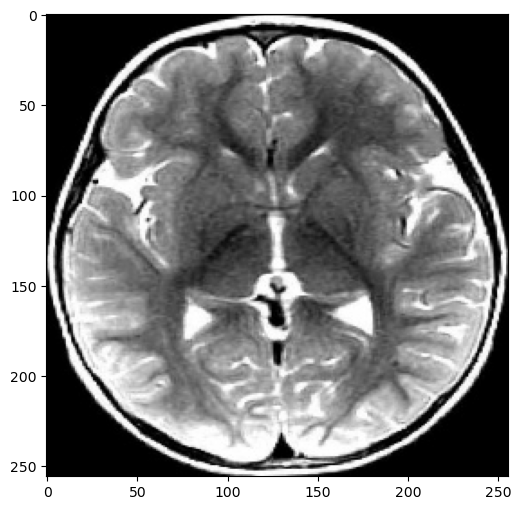

In [12]:
fig, ax = plt.subplots(figsize=(6,6))
ax.imshow(img_plt)
#ax.axis('off')
plt.show()

#### Visualising the Colour Channels

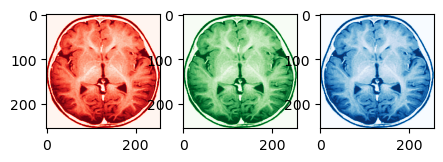

In [13]:
fig, axs = plt.subplots(1,3,figsize=(5,3)) #creating a plot grid of 1 by 3
axs[0].imshow(img_plt[:,:,0],cmap='Reds')
axs[1].imshow(img_plt[:,:,1],cmap='Greens')
axs[2].imshow(img_plt[:,:,2],cmap='Blues')
plt.show()

### Data Balance

In [14]:
len(normal)

170

In [15]:
len(tumor)

230

There is a slight imbalance between the normal sample and the tumor sample. However, the proportion of normal/tumor is not extreme so this small imbalance should not be problem.

### Investigating differences between tumor and normal

NORMAL MRI


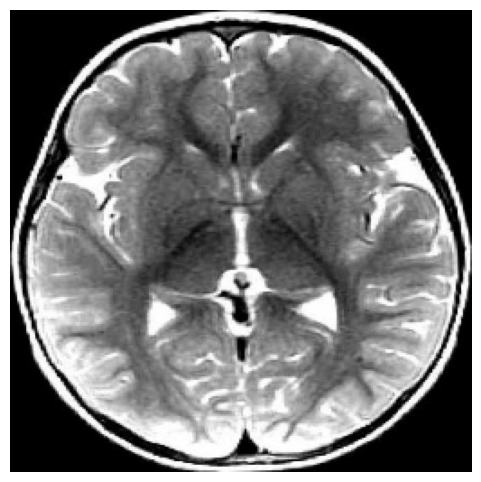

TUMOR MRI


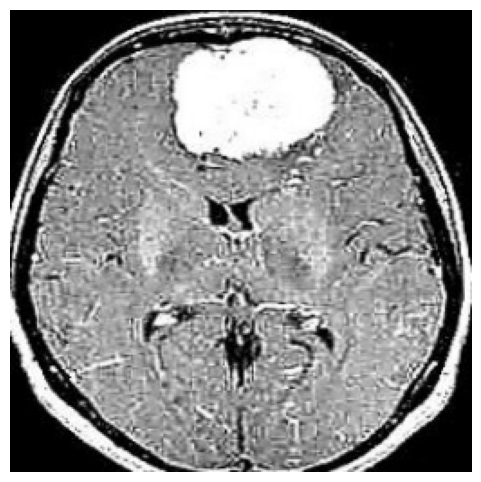

NORMAL MRI


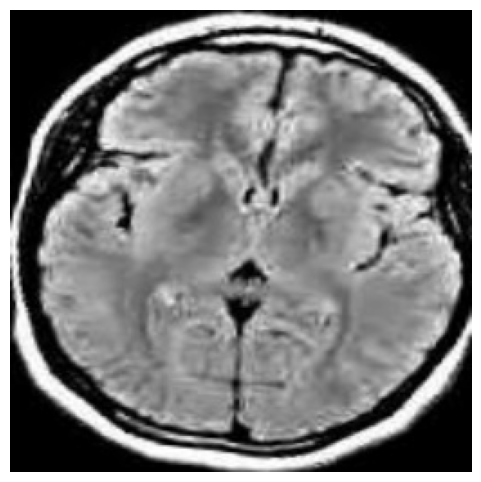

TUMOR MRI


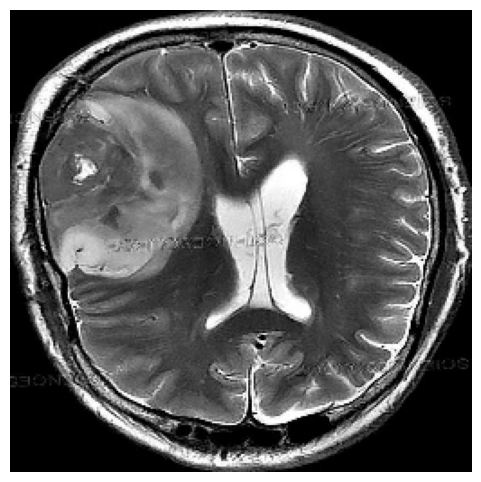

NORMAL MRI


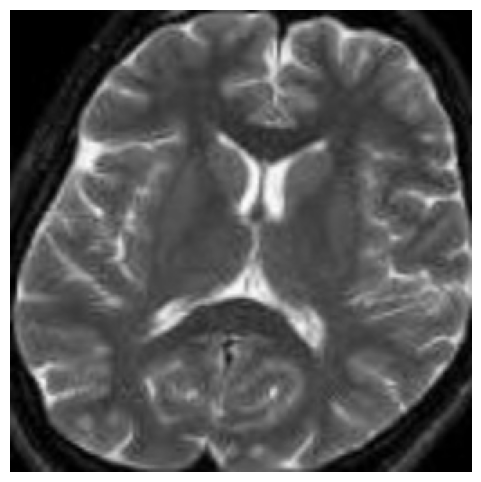

TUMOR MRI


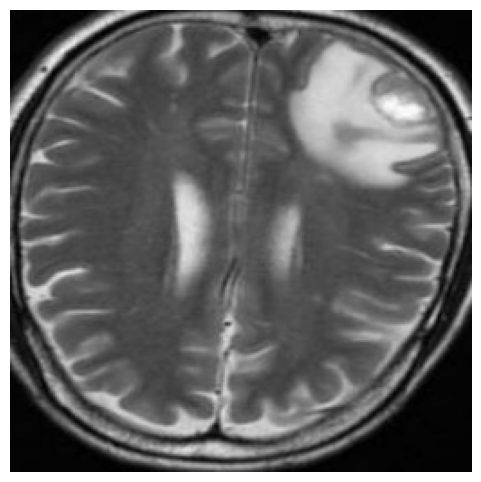

NORMAL MRI


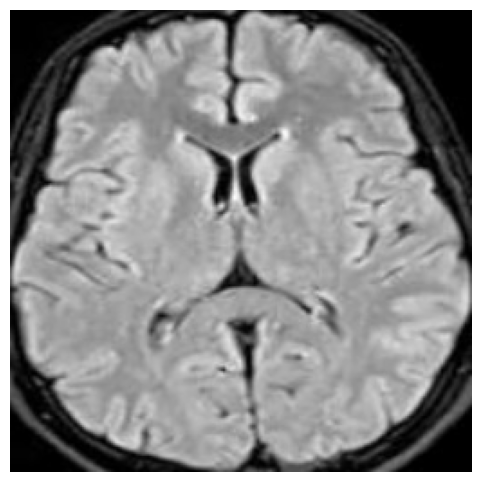

TUMOR MRI


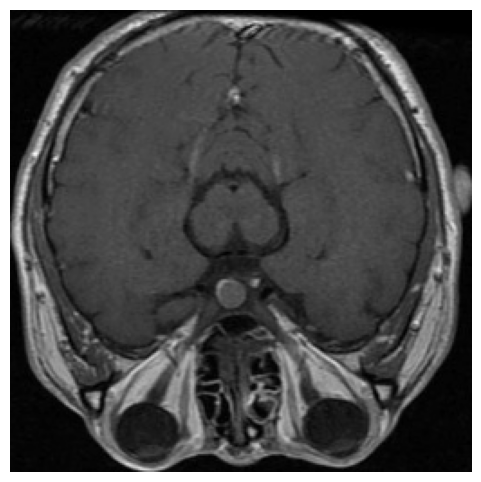

NORMAL MRI


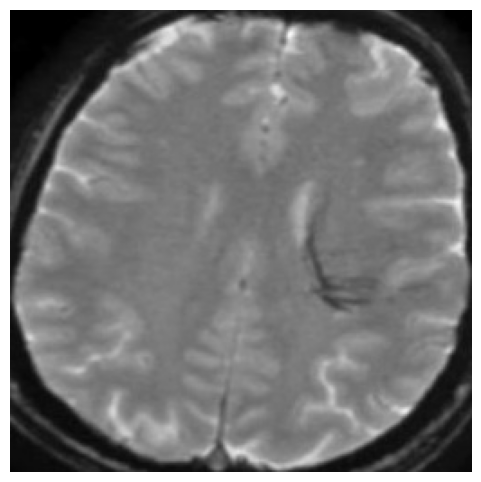

TUMOR MRI


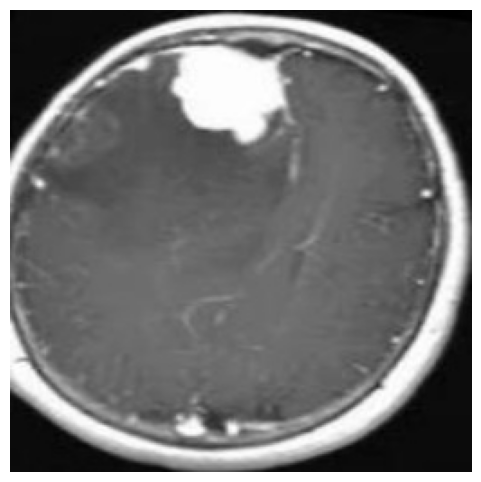

NORMAL MRI


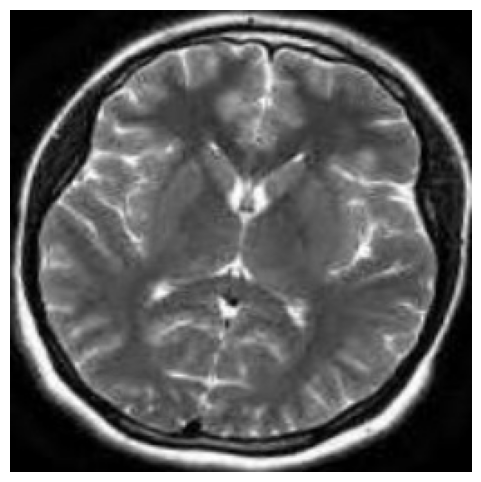

TUMOR MRI


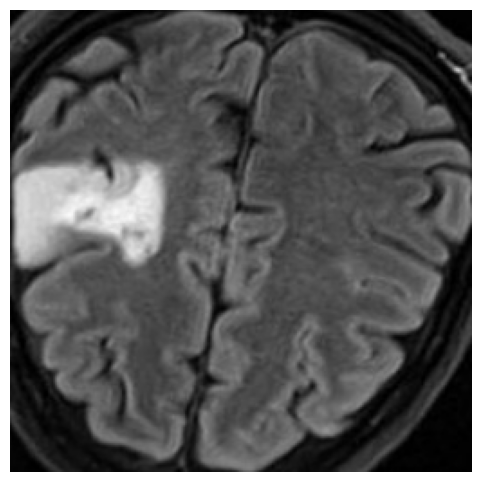

NORMAL MRI


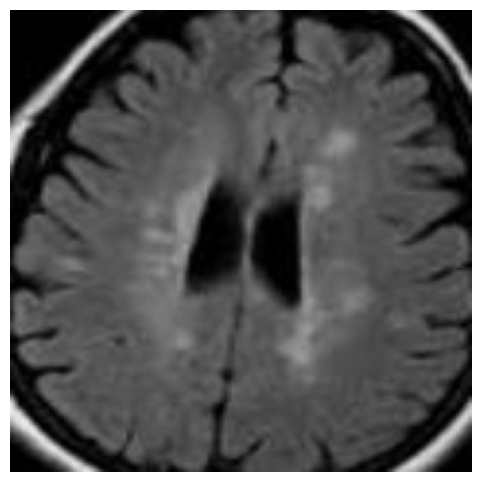

TUMOR MRI


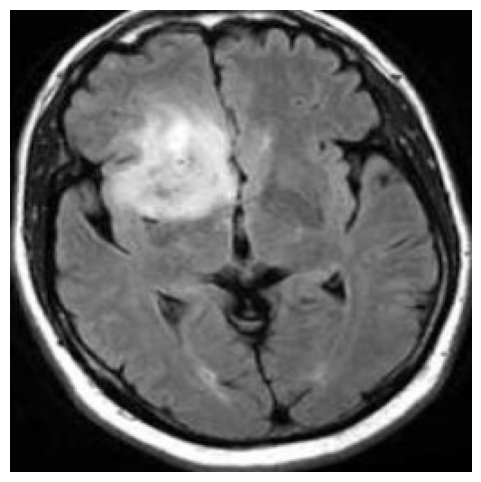

NORMAL MRI


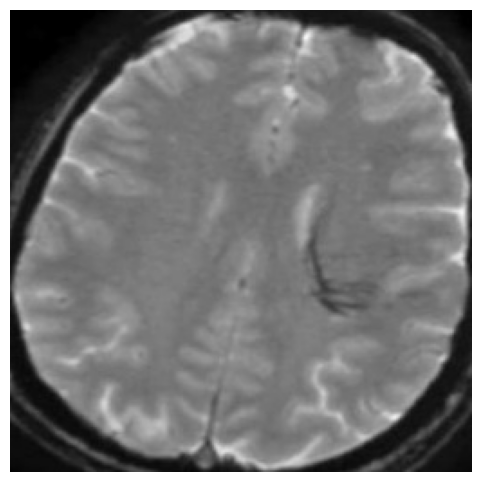

TUMOR MRI


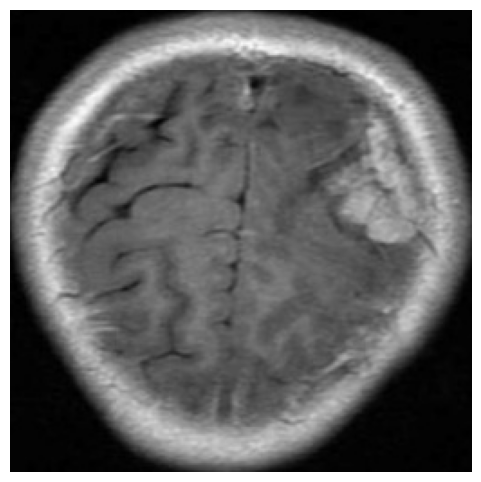

NORMAL MRI


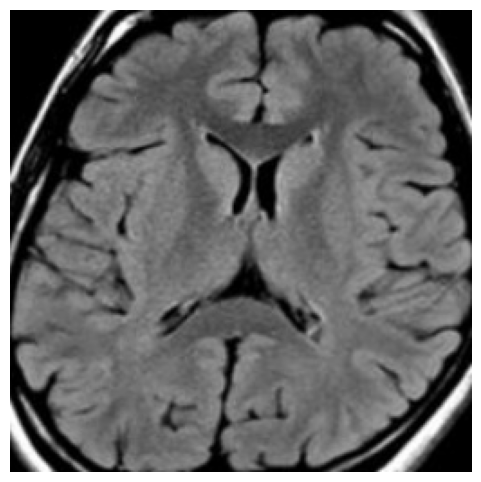

TUMOR MRI


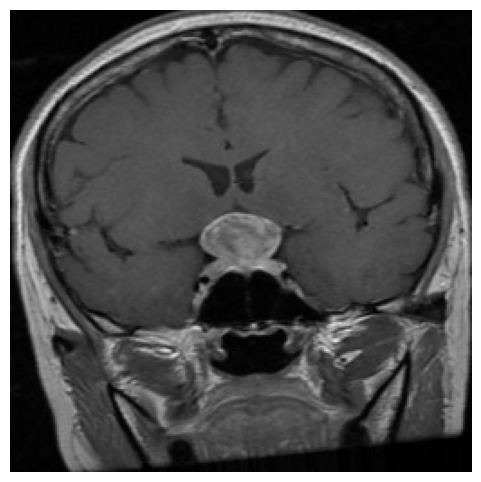

NORMAL MRI


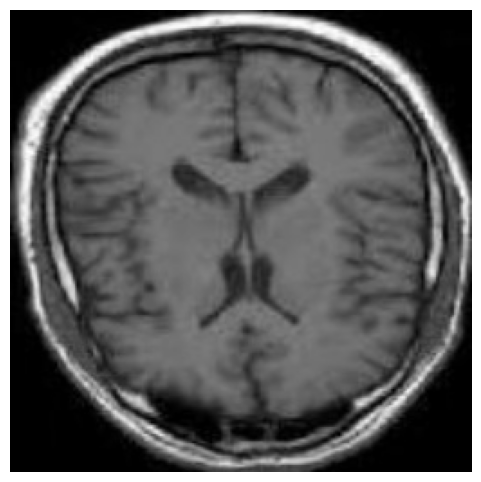

TUMOR MRI


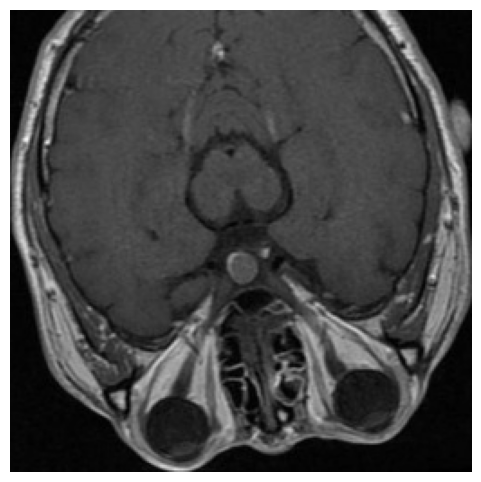

In [16]:
for i in range(10):
    print('NORMAL MRI')
    fig, ax = plt.subplots(figsize=(6,6))
    ax.imshow(plt.imread(normal[i]))
    ax.axis('off')
    plt.show()
    
    print('TUMOR MRI')
    fig, ax = plt.subplots(figsize=(6,6))
    ax.imshow(plt.imread(tumor[i]))
    ax.axis('off')
    plt.show()

### End of Section Discussion
#### From the three above images we can see significant differences between normal and tumor scans. Tumors appear as white OR light gray masses in the image for the majority of the 10 sampled above. Also, between images, some brain images are lighter than others. Since the tumor appears as a white/light gray mass, a case where the brain mass in general is lighter may be a problem for the model to distinguish between tumor and normal.

#### Also, notice that the plane of these images is different in certain cases, some are transverse and others are coronal (e.g. 9th tumor image is coronal whilst all other above are transverse). This would possibly make it harder for the model to generate reliable values of hyper-parameters for the model. By my view it would be more beneficial if there was only one type of plane used. This is becasue there are many features in a normal MRI (white/light gray spots) that could resemble tumors when seen from the coronal view as compared to the transverse view and vice versa.

## 3) Pre-Processing Data

### Processing Base Data
#### Here, I purposely left and unprocessed version of the data. This is becasue I would like to investigate the misclassified images. "Un-processing" the data cannot be done so in order to view the images of the correct index later we create a X_train_nr (non-resized) and X_train_nr_g ("X_train_nr_g" if reffering to the gray scale data).

In [17]:
data = []
labels = []
for i in normal:
    img = plt.imread(i)
    data.append(img)
    labels.append('normal')

for i in tumor:
    img = plt.imread(i)
    data.append(img)
    labels.append('tumor')

In [18]:
data

[array([[[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        ...,
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]]], dtype=uint8),
 array([[[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 

### Train Test Splitting
#### 1) Base Data

In [19]:
X_train_nr, X_test_nr, y_train, y_test = train_test_split(data,labels,test_size=0.2,stratify=labels,random_state=42)

for i in [X_train_nr,X_test_nr,y_train,y_test]:
    print(len(i))

320
80
320
80


In [20]:
### Checking
#X_train_nr

#### Resizing Base Data

In [21]:
X_train = []
X_test = []
for i in range(len(X_train_nr)):
    imgr = resize(X_train_nr[i],(10,10))
    X_train.append(imgr.flatten())
    
for i in range(len(X_test_nr)):
    imgr = resize(X_test_nr[i],(10,10))
    X_test.append(imgr.flatten())

In [22]:
### Checking 
#X_train_nr

In [23]:
#X_train

In [24]:
#X_test_nr

In [25]:
#X_test

### Processing Gray Scale Data

In [26]:
data_gray = []
labels_gray = []
for i in normal:
    img = plt.imread(i)
    img = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    data_gray.append(img)
    labels_gray.append('normal')

for i in tumor:
    img = plt.imread(i)
    img = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    data_gray.append(img)
    labels_gray.append('tumor')

In [27]:
X_train_nr_g, X_test_nr_g, y_train_g, y_test_g = train_test_split(data_gray,labels_gray,test_size=0.2,stratify=labels,
                                                          random_state=42)

for i in [X_train_nr_g,X_test_nr_g,y_train_g,y_test_g]:
    print(len(i))

320
80
320
80


#### Resizing Gray Scale Data

In [28]:
X_train_g = []
X_test_g = []
for i in range(len(X_train_nr_g)):
    img = resize(X_train_nr_g[i],(10,10))
    X_train_g.append(img.flatten())
    
for i in range(len(X_test_nr_g)):
    img = resize(X_test_nr_g[i],(10,10))
    X_test_g.append(img.flatten())

In [29]:
##checking
#X_train_g

In [30]:
#X_test_g

In [31]:
#X_train_nr_g

In [32]:
#X_test_nr_g

### Changing the Target Labels: "normal" -> 0 and "tumor" -> 1

#### Base Data Target Variable

In [33]:
#y_train

In [34]:
#y_test

In [35]:
y_train,y_test = label_change([y_train,y_test])

In [36]:
#y_train

In [37]:
#y_test

#### Gray Scale Data Target Variable

In [38]:
#y_train_g

In [39]:
#y_test_g

In [40]:
y_train_g,y_test_g = label_change([y_train_g,y_test_g])

In [41]:
#y_train_g

In [42]:
#y_test_g

### Scaling: Min Max Scaling

In [43]:
from sklearn.preprocessing import MinMaxScaler
### https://towardsdatascience.com/all-about-feature-scaling-bcc0ad75cb35
### Sebastian Raschka p.444?
mm = MinMaxScaler()

#### Base Data Min Max Scaling

In [44]:
X_trainmm = mm.fit_transform(X_train)

In [45]:
#X_trainmm

In [46]:
X_testmm = mm.transform(X_test)

In [47]:
#X_testmm

#### Gray Scale Data Min Max Scaling

In [48]:
X_trainmm_g = mm.fit_transform(X_train_g)

In [49]:
#X_trainmm_g

In [50]:
X_testmm_g = mm.transform(X_test_g)

In [51]:
#X_testmm_g

## 4) Modelling
### Multi-Layer-Perceptron Classifier

### Base Model

In [52]:
clf = MLPClassifier(max_iter=50000,random_state=42)

In [53]:
clf.fit(X_train,y_train)

MLPClassifier(max_iter=50000, random_state=42)

In [54]:
clf.score(X_train,y_train)

0.98125

In [55]:
clf.score(X_test,y_test)

0.875

#### ROC and AUC for Base Model: Train Data

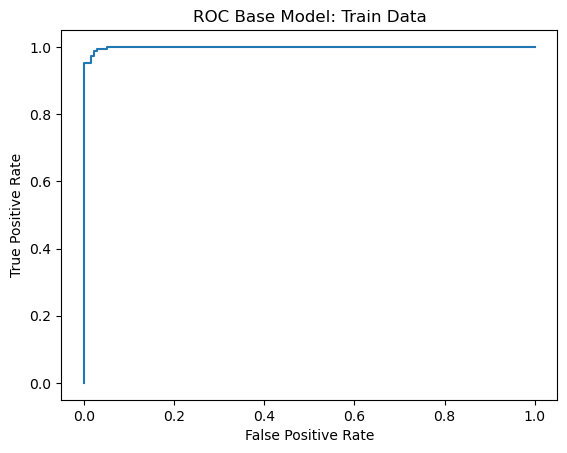

Area under the above curve is:  0.9988810741687979


In [56]:
roc_auc(y_train, clf.predict_proba(X_train)[:,1], "ROC Base Model: Train Data")

#### ROC and AUC for Base Model: Test Data

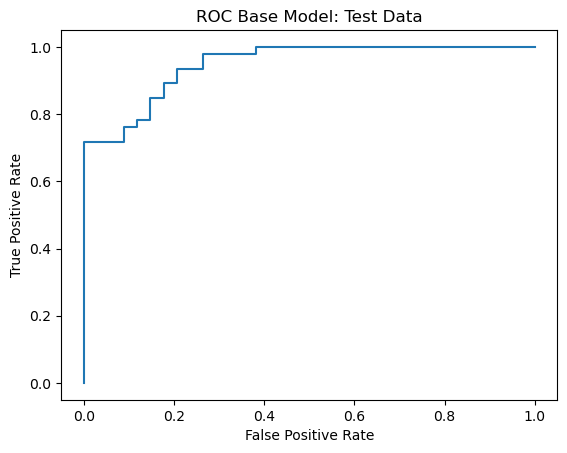

Area under the above curve is:  0.9475703324808185


In [57]:
roc_auc(y_test, clf.predict_proba(X_test)[:,1],"ROC Base Model: Test Data")

### MinMaxScaled Models (Base and Gray).
#### Base.

In [58]:
clf.fit(X_trainmm,y_train)

MLPClassifier(max_iter=50000, random_state=42)

In [59]:
clf.score(X_trainmm,y_train)

1.0

In [60]:
clf.score(X_testmm,y_test)

0.9125

#### ROC AUC for MinMax Scaled Base Model: Train Data

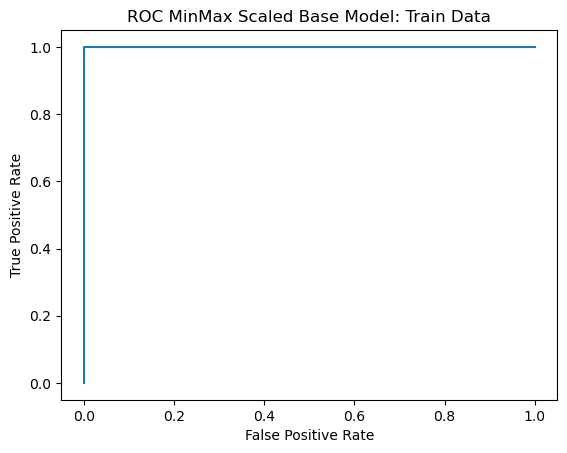

Area under the above curve is:  1.0


In [61]:
roc_auc(y_train, clf.predict_proba(X_trainmm)[:,1],"ROC MinMax Scaled Base Model: Train Data")

#### ROC and AUC for MinMax Scaled Base Model: Test Data

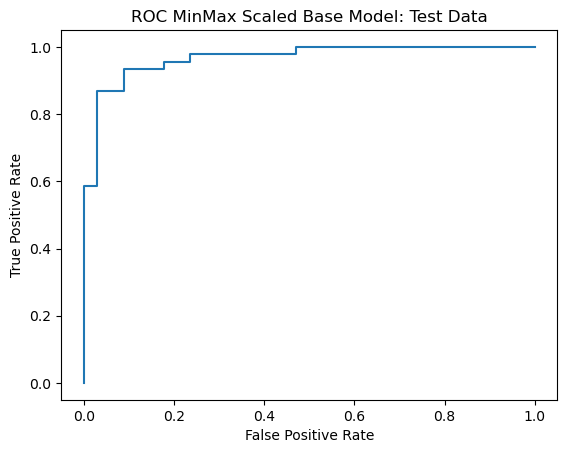

Area under the above curve is:  0.9667519181585678


In [62]:
roc_auc(y_test, clf.predict_proba(X_testmm)[:,1],"ROC MinMax Scaled Base Model: Test Data")

##### Grayscale.

In [63]:
clf.fit(X_trainmm_g,y_train_g)

MLPClassifier(max_iter=50000, random_state=42)

In [64]:
clf.score(X_trainmm_g,y_train_g)

1.0

In [65]:
clf.score(X_testmm_g,y_test_g)

0.9

#### ROC and AUC for MinMax Scaled Gray Scaled Model: Train Data

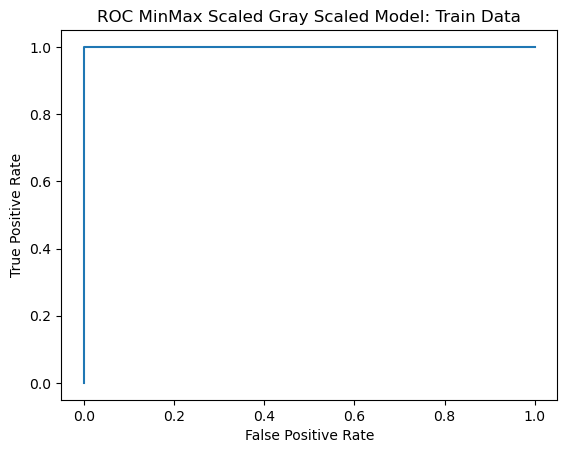

Area under the above curve is:  1.0


In [66]:
roc_auc(y_train_g, clf.predict_proba(X_trainmm_g)[:,1],"ROC MinMax Scaled Gray Scaled Model: Train Data")

#### ROC and AUC for MinMax Scaled Gray Scaled Model: Test Data

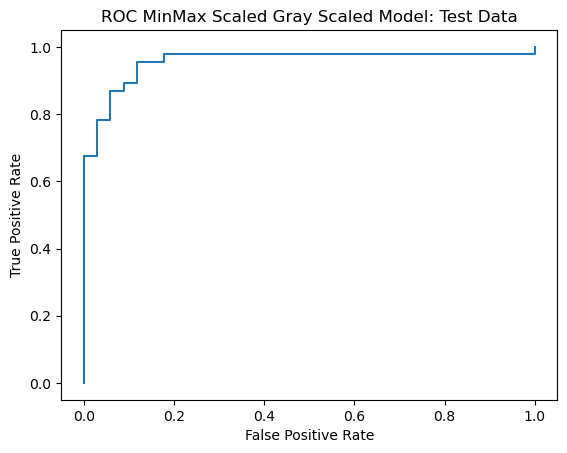

Area under the above curve is:  0.9565217391304348


In [67]:
roc_auc(y_test_g, clf.predict_proba(X_testmm_g)[:,1],"ROC MinMax Scaled Gray Scaled Model: Test Data")

##### Gray Scale Base Model.

In [68]:
clf.fit(X_train_g,y_train_g)

MLPClassifier(max_iter=50000, random_state=42)

In [69]:
clf.score(X_train_g,y_train_g)

0.978125

In [70]:
clf.score(X_test_g,y_test_g)

0.8625

#### ROC and AUC for Gray Scale Base Model: Train Data

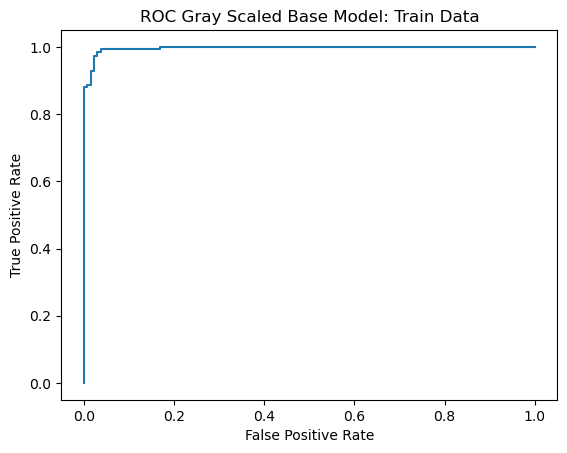

Area under the above curve is:  0.9967231457800512


In [71]:
roc_auc(y_train_g, clf.predict_proba(X_train_g)[:,1],"ROC Gray Scaled Base Model: Train Data")

#### ROC and AUC for Gray Scale Base Model: Test Data

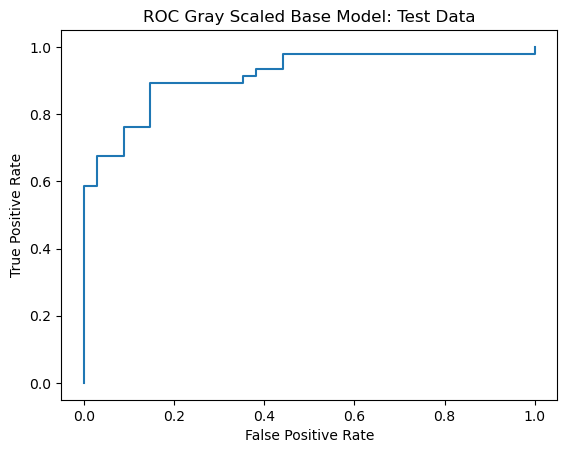

Area under the above curve is:  0.913682864450128


In [72]:
roc_auc(y_test_g, clf.predict_proba(X_test_g)[:,1],"ROC Gray Scaled Base Model: Test Data")

### Discussion

We have a 0.0875 decrease between the train data and the test data: the model is overfitting the train datahe but on the other hand the scores are quite good. However, not good enough for any serious medical application. We would be needing test accuracies within the 95% - 99% or higher range.

If we think about the application. We do care about telling someone that they HAVE a brain tumour whilst they DO NOT HAVE a brain tumour (false-positive) as this has an impact on their mental health further down the line. Additionally various therapies that aim to treat cancers may be toxic to a healthy individual. We also care about telling someone that they DO NOT HAVE a brain tumour whilst they HAVE a brain tumour. Therapies aiming to treat this individual would not be applied, only when it is too late and the tumour spreads and enlarges. I believe both cases are equally as important and so maintaining a good f1-score whilst maximising accuracy is important for this application.

### f1-score x_train and y_train

In [73]:
clf.fit(X_train,y_train)

MLPClassifier(max_iter=50000, random_state=42)

In [74]:
df_train = pd.DataFrame({'y_pred_train':list(clf.predict(X_train)),
                  'y_true_train':y_train})
### Checking
#df_train.head()

In [75]:
metrics.f1_score(df_train['y_true_train'], df_train['y_pred_train'],average = 'binary')

0.9838709677419355

### f1-score x_test and y_test 

In [76]:
### For x_test and y_test 
df_test = pd.DataFrame({'y_pred_test':list(clf.predict(X_test)),
                  'y_true_test':y_test})
#Checking
#df_test.head()

In [77]:
metrics.f1_score(df_test['y_true_test'], df_test['y_pred_test'],average = 'binary')

0.8958333333333334

### f1-score x_train and y_train gray-scale

In [78]:
clf.fit(X_train_g,y_train_g)

MLPClassifier(max_iter=50000, random_state=42)

In [79]:
df_train_g = pd.DataFrame({'y_pred_train':list(clf.predict(X_train_g)),
                  'y_true_train':y_train_g})
#Checking
#df_train_g.head()

In [80]:
metrics.f1_score(df_train_g['y_true_train'], df_train_g['y_pred_train'],average = 'binary')

0.981132075471698

### f1-score x_test and y_test gray-scale

In [81]:
df_test_g = pd.DataFrame({'y_pred_test':list(clf.predict(X_test_g)),
                  'y_true_test':y_test_g})
#Checking
#df_test_g.head()

In [82]:
metrics.f1_score(df_test_g['y_true_test'], df_test_g['y_pred_test'],average = 'binary')

0.8791208791208792

### f1-score x_train and y_train MinMaxScaled

In [83]:
clf = MLPClassifier(max_iter=50000,random_state=42)

In [84]:
clf.fit(X_trainmm,y_train)

MLPClassifier(max_iter=50000, random_state=42)

In [85]:
df_trainmms = pd.DataFrame({'y_pred_train':list(clf.predict(X_trainmm)),
                  'y_true_train':y_train})
#Checking
#df_trainmms.head()

In [86]:
metrics.f1_score(df_trainmms['y_true_train'], df_trainmms['y_pred_train'],average = 'binary')

1.0

### f1-score x_test and y_test MinMaxScaled

In [87]:
df_testmms = pd.DataFrame({'y_pred_test':list(clf.predict(X_testmm)),
                  'y_true_test':y_test})
#Checking
#df_testmms.head()

In [88]:
metrics.f1_score(df_testmms['y_true_test'], df_testmms['y_pred_test'],average = 'binary')

0.9230769230769231

### Discussion

It seems to be holding up quite well in terms of absolute scores but not to the practical standard. However there is still a slight problem with the overfitting onto the train data. We could use a simpler model by resizing the image to a smaller size, this could be added as an iteration to this project.

Comparing the gray scale versus normal, the normal data seems to be doing better so we will stick with that. Additionally comparing scaled versus non-scaled shows that SCALED is better in reaching a better accuracy score and smaller drop of, as is expected.

## 5) Optimum Hyper-Parameters (GridSearchCV)
Here I have tested options of hyperparameters to grid search which combination gives the best accuracy but also considering a realtively good f1 score. Due to the continuous nature of the 'alpha' hyper-parameter I initially tested 'alpha' values that were more spaced out (e.g. 0.0002,0.0003,0.0001..., not shown here) to crudely gauge where the optimum value could be. I found that 0.0001 was the optimum in that case, and so on this grid search iteration (see below) I selected values that were close to 0.0001.

In [89]:
from sklearn.model_selection import GridSearchCV

In [90]:
### This code takes a while on a mediocre setup (11 Hours)
params = {'alpha':[0.00011,0.00012,0.00013,0.00014,0.00015,0.00009,0.00008,0.00007],
         'hidden_layer_sizes':[100,90,80,110,120],
         'activation':['identity','logistic','tanh','relu'],
         'solver':['sgd','adam'],
         'learning_rate':['constant', 'invscaling', 'adaptive'],
         #'warm_start':[True,False]
         }
def grid_search(param_dict, classifier_object, folds, X, y):
    """Grid search finding the best parameters. Requires gridsearch package."""
    gs = GridSearchCV(classifier_object, param_grid=param_dict, cv=folds, verbose=2, scoring=['accuracy', 'f1'],
                      refit='accuracy')
    gs.fit(X, y)
    print(gs.best_score_)
    print(gs.best_params_)
    
### momentum, shuffle,beta_2,beta_1,n_iter_no_change, float can only be set when the solvers are specific..
### if these solvers are good then use!

In [91]:
## This code took 11 hours to run on my machine.
##grid_search(param_dict=params, classifier_object=clf, folds=10, X=X_trainmm, y=y_train)

In [92]:
#{'activation': 'relu', 'alpha': 0.00014, 'hidden_layer_sizes': 120, 'learning_rate': 'constant', 'solver': 'adam'}
clf = MLPClassifier(max_iter=50000, activation='relu', alpha=0.00014, hidden_layer_sizes=120, 
                    learning_rate='constant', solver='adam', random_state=42)

In [93]:
clf.fit(X_trainmm,y_train)

MLPClassifier(alpha=0.00014, hidden_layer_sizes=120, max_iter=50000,
              random_state=42)

In [94]:
clf.score(X_trainmm,y_train)

1.0

In [95]:
clf.score(X_testmm,y_test)

0.9125

### Model Hyper-Parameters

In [96]:
clf.get_params()

{'activation': 'relu',
 'alpha': 0.00014,
 'batch_size': 'auto',
 'beta_1': 0.9,
 'beta_2': 0.999,
 'early_stopping': False,
 'epsilon': 1e-08,
 'hidden_layer_sizes': 120,
 'learning_rate': 'constant',
 'learning_rate_init': 0.001,
 'max_fun': 15000,
 'max_iter': 50000,
 'momentum': 0.9,
 'n_iter_no_change': 10,
 'nesterovs_momentum': True,
 'power_t': 0.5,
 'random_state': 42,
 'shuffle': True,
 'solver': 'adam',
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': False,
 'warm_start': False}

### f1_scores X_train Scaled using Optimum Model

In [97]:
df_train_mm = pd.DataFrame({'y_pred_train':list(clf.predict(X_trainmm)),
                  'y_true_train':y_train})
#Checking
#df_train_mm.head()

In [98]:
metrics.f1_score(df_train_mm['y_true_train'], df_train_mm['y_pred_train'],average = 'binary')

1.0

### ROC and AUC for Optimum Model Train Data, MinMax Scaled

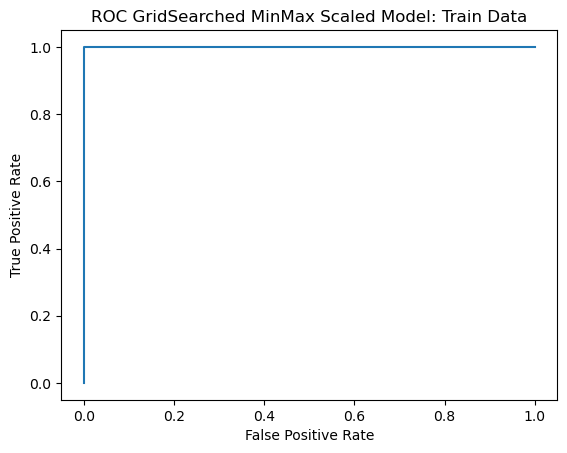

Area under the above curve is:  1.0


In [99]:
roc_auc(y_train, clf.predict_proba(X_trainmm)[:,1],"ROC GridSearched MinMax Scaled Model: Train Data")

### Confusion Matrix of Optimum Model for Train Data, MinMax Scaled
##### Code adapted from: https://www.w3schools.com/python/python_ml_confusion_matrix.asp

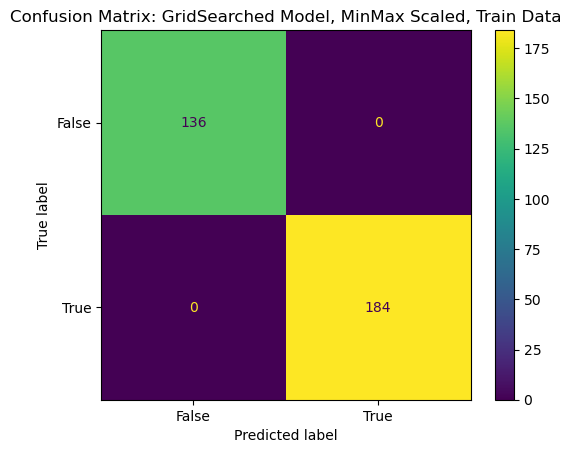

In [100]:
cm = metrics.confusion_matrix(y_train, clf.predict(X_trainmm))
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = [False, True])

cm_display.plot()
plt.title('Confusion Matrix: GridSearched Model, MinMax Scaled, Train Data')
plt.show()

### f1_scores X_test Scaled Using Optimum Model

In [101]:
df_test_mm = pd.DataFrame({'y_pred_test':list(clf.predict(X_testmm)),
                  'y_true_test':y_test})
#Checking
#df_test_mm.head()

In [102]:
metrics.f1_score(df_test_mm['y_true_test'], df_test_mm['y_pred_test'],average = 'binary')

0.9230769230769231

### ROC and AUC for Optimum Model Test Data, MinMax Scaled

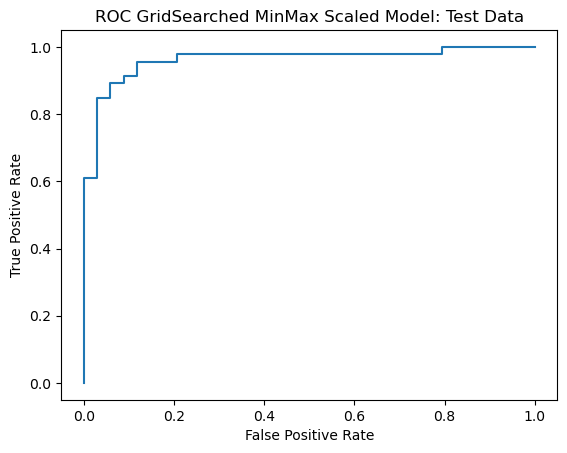

Area under the above curve is:  0.9616368286445013


In [103]:
roc_auc(y_test,clf.predict_proba(X_testmm)[:,1],"ROC GridSearched MinMax Scaled Model: Test Data")

### Confusion Matrix of Optimum Model Test Data, MinMax Scaled

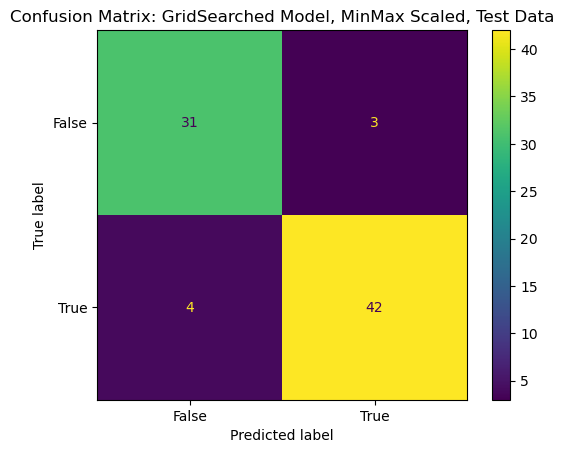

In [104]:
cm = metrics.confusion_matrix(y_test, clf.predict(X_testmm))
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = [False, True])

cm_display.plot()
plt.title('Confusion Matrix: GridSearched Model, MinMax Scaled, Test Data')
plt.show()

### Discussion
The selected model does not do better than the base model presented earlier in terms of accuracy scores, they were the same. Perhaps the difference of the model could show better if the sample size was larger resulting in more test samples to test.

The optimum model has achieved a very good accuracy and f1_score for the test data. There is some amount of drop off (accuracy: 0.0875 & f1_score: 0.058) between the train and test data for both metrics. Although this dataset is not very large by any means, this work show that we can achieve quite good accuracies for prediciting brain tumours from MRI images. In the future I want to test this model out on another dataset to see how it does. Possibly apply this code on a larger dataset (above 1000 samples), although compute times would be very long.

Additionally, to deal with the overfitting, I would be thinking about downsizing the images in the pre-processing stage even more. This would cause the model to be simpler and overfit less onto the training data.

## 6) Investigation of Correctly and Incorrectly Classified Images of the Test Data

### Pixel Distribution of the Images of the Test Data

In [105]:
### Investigating pixel distributions on examples that have not been classified correctly
def predstat(x,y):
    if (x==y):
        return 1
    else:
        return 0
    

df_test_mm['Pred Status'] = df_test_mm.apply(lambda x: predstat(x.y_true_test,x.y_pred_test),axis=1)
#Checking
#df_test_mm.head()

In [106]:
### Now we need to grab the index of all the ones that are correctly classiffied and incorrectly classified examples

cindex = df_test_mm.index[df_test_mm['Pred Status']==1]
incindex = df_test_mm.index[df_test_mm['Pred Status']==0]
        
    ### join the dataframes together and then perform this!

Correctly classified scan number  0 . Pixel distribution plot.


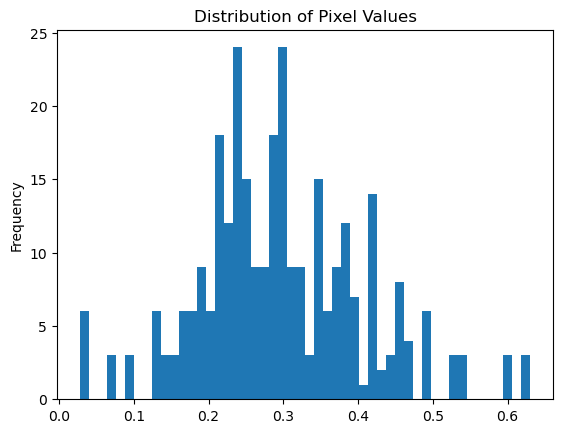

Correctly classified scan number  1 . Pixel distribution plot.


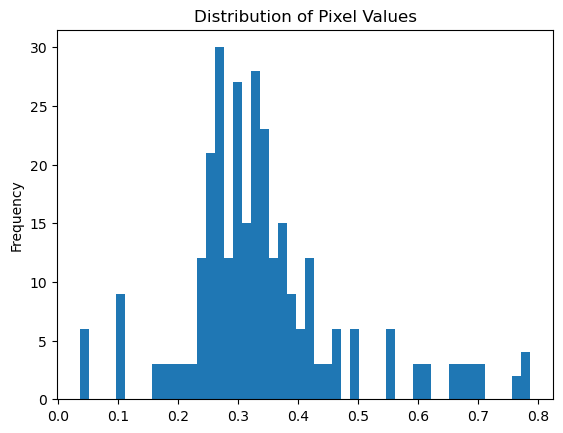

Correctly classified scan number  3 . Pixel distribution plot.


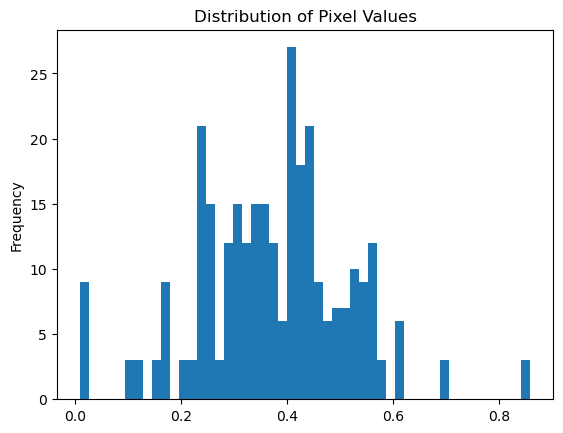

Correctly classified scan number  4 . Pixel distribution plot.


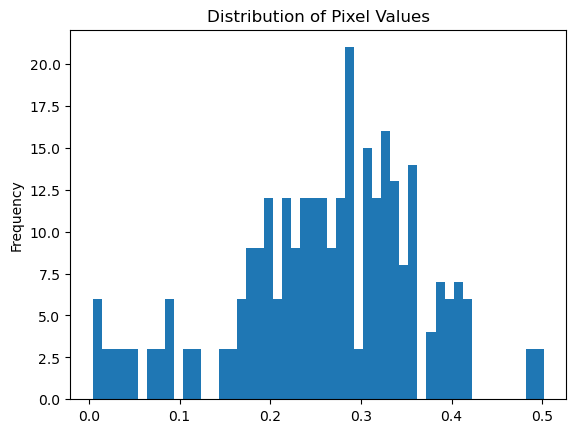

Correctly classified scan number  5 . Pixel distribution plot.


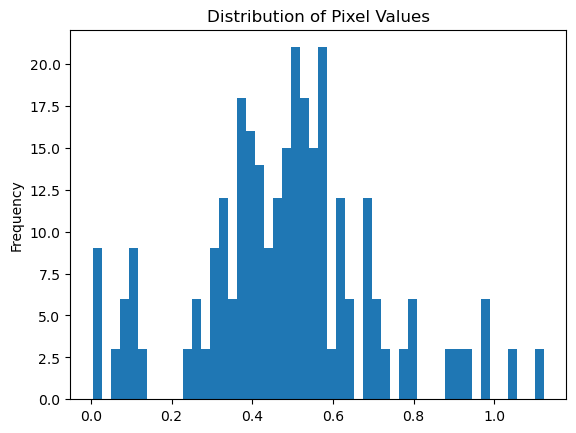

Correctly classified scan number  6 . Pixel distribution plot.


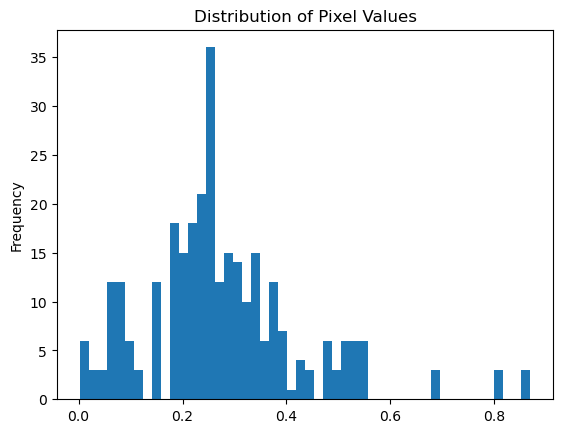

Correctly classified scan number  7 . Pixel distribution plot.


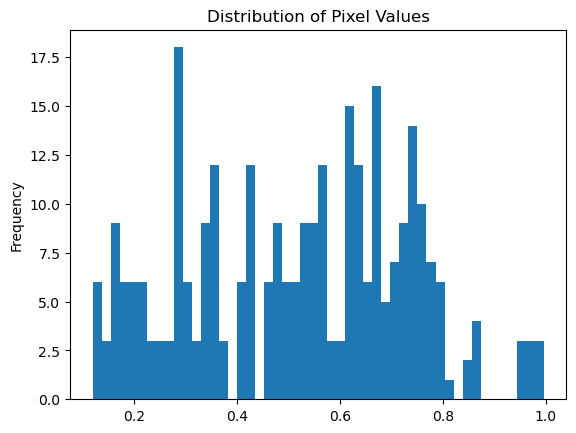

Correctly classified scan number  10 . Pixel distribution plot.


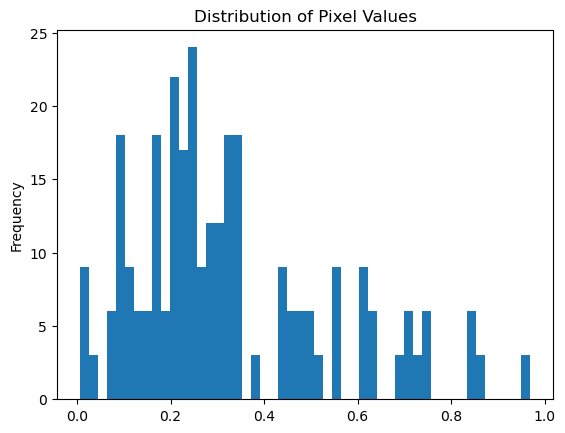

Correctly classified scan number  11 . Pixel distribution plot.


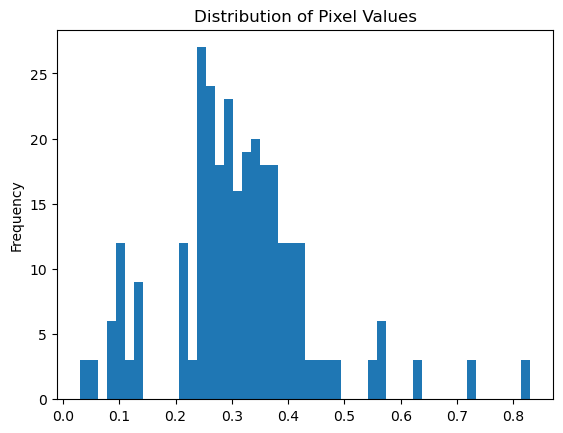

Correctly classified scan number  12 . Pixel distribution plot.


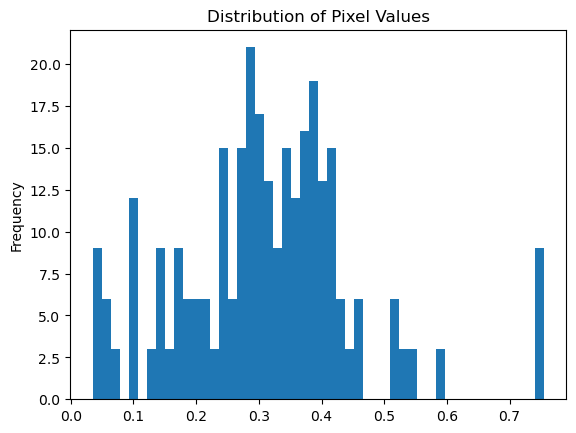

Correctly classified scan number  13 . Pixel distribution plot.


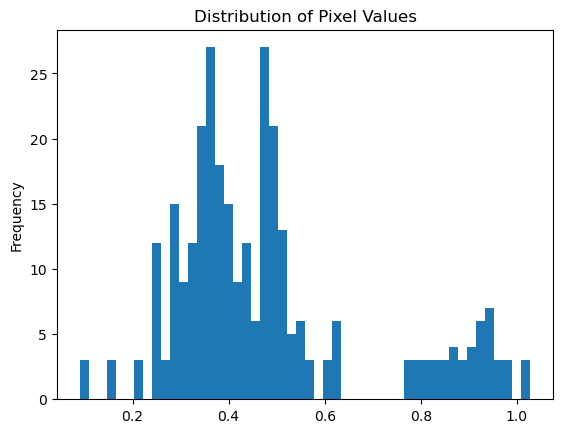

Correctly classified scan number  15 . Pixel distribution plot.


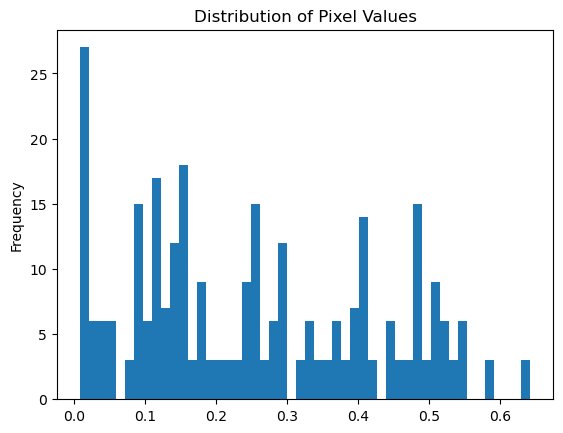

Correctly classified scan number  16 . Pixel distribution plot.


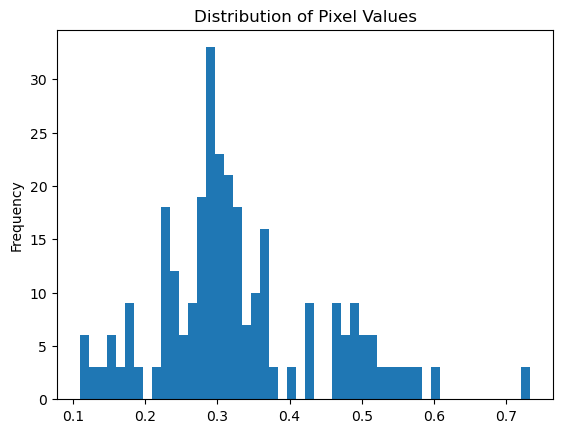

Correctly classified scan number  17 . Pixel distribution plot.


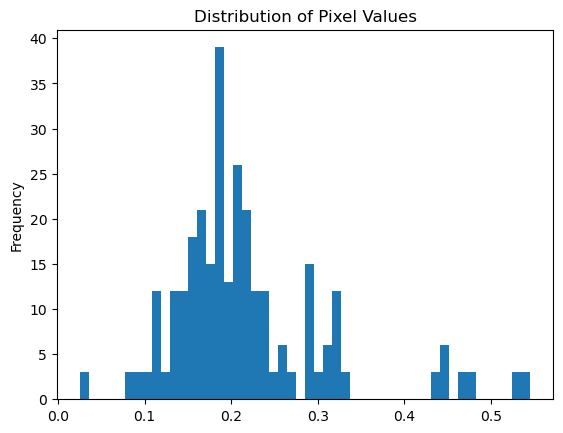

Correctly classified scan number  18 . Pixel distribution plot.


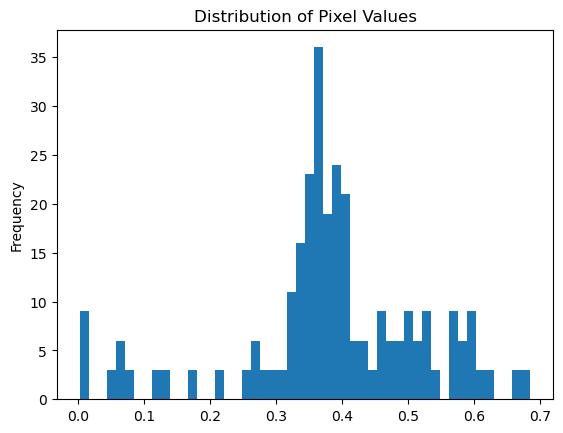

Correctly classified scan number  19 . Pixel distribution plot.


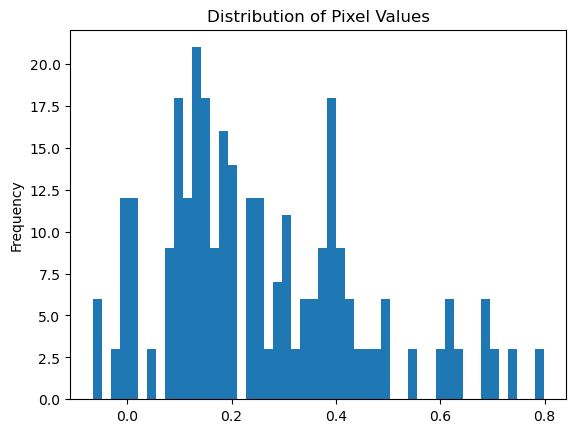

Correctly classified scan number  20 . Pixel distribution plot.


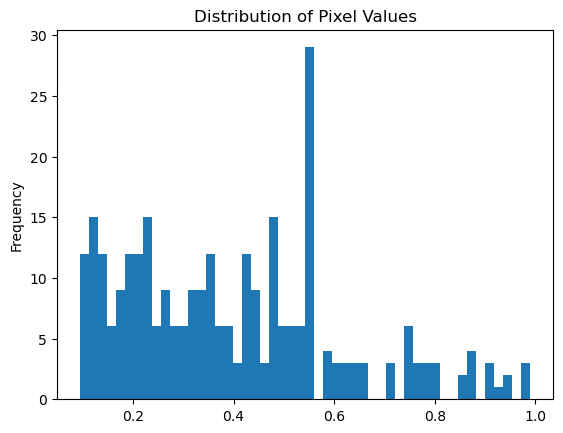

Correctly classified scan number  21 . Pixel distribution plot.


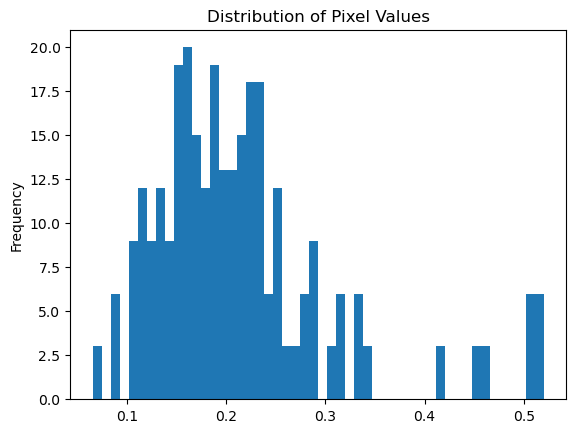

Correctly classified scan number  22 . Pixel distribution plot.


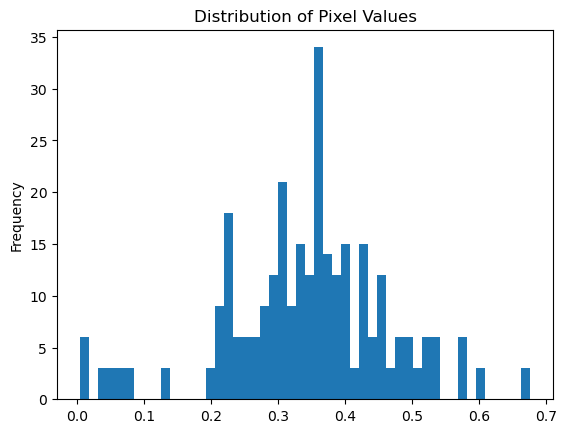

Correctly classified scan number  23 . Pixel distribution plot.


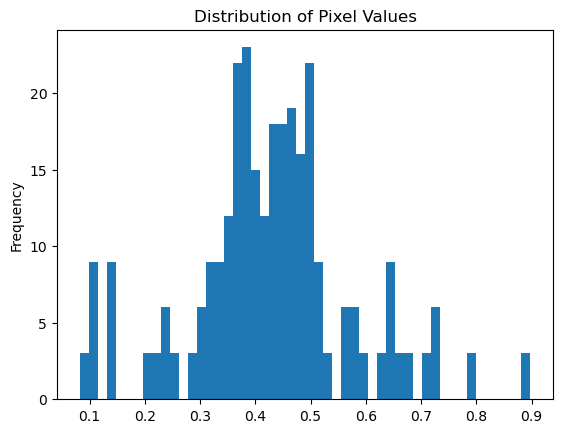

Correctly classified scan number  24 . Pixel distribution plot.


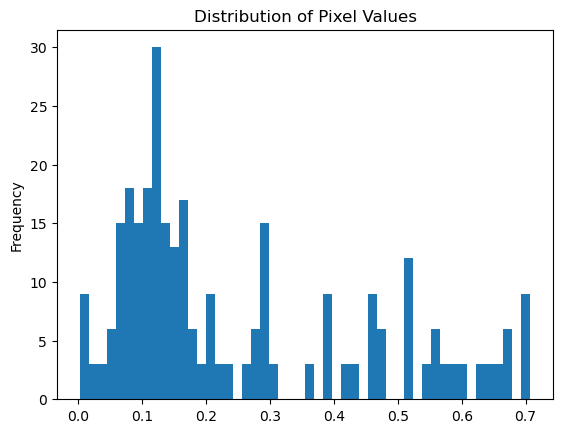

Correctly classified scan number  25 . Pixel distribution plot.


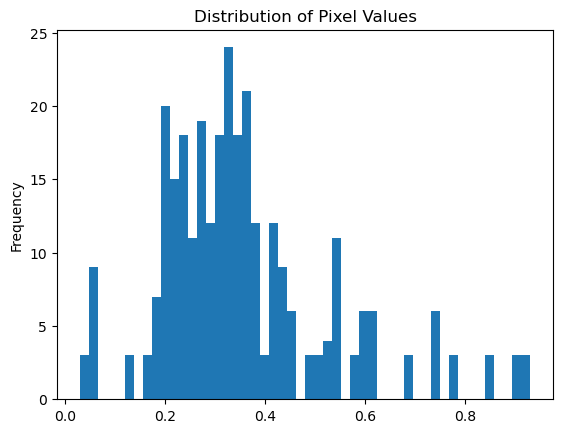

Correctly classified scan number  26 . Pixel distribution plot.


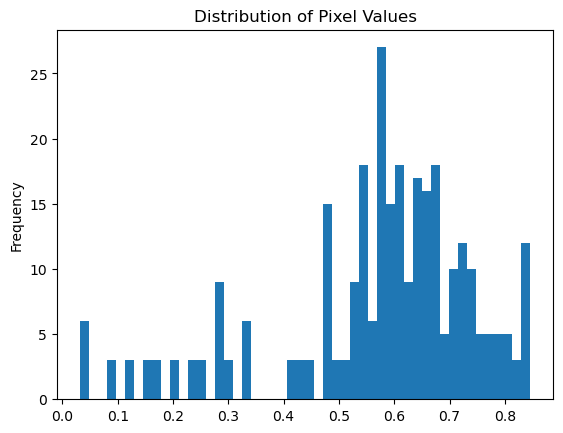

Correctly classified scan number  27 . Pixel distribution plot.


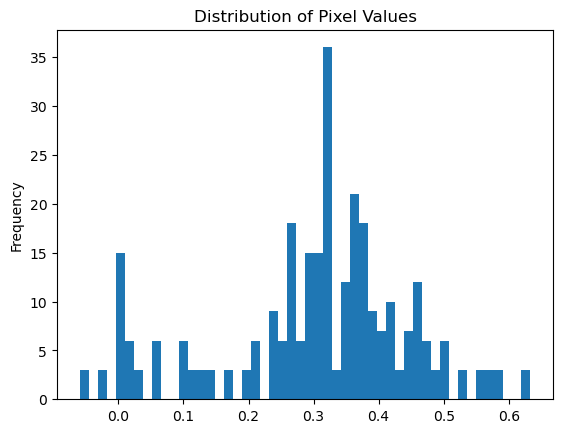

Correctly classified scan number  28 . Pixel distribution plot.


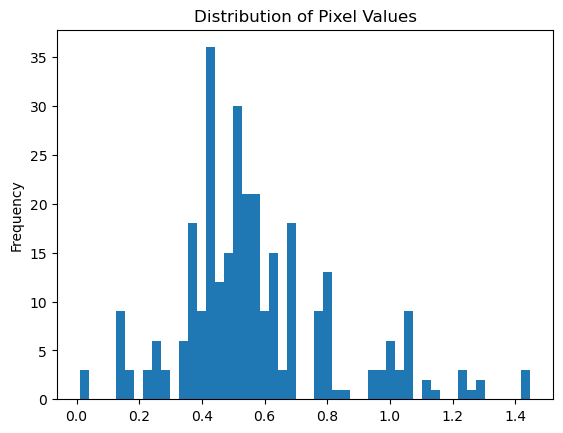

Correctly classified scan number  29 . Pixel distribution plot.


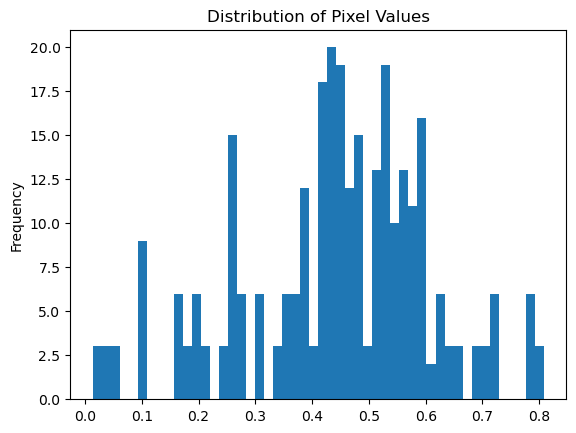

Correctly classified scan number  30 . Pixel distribution plot.


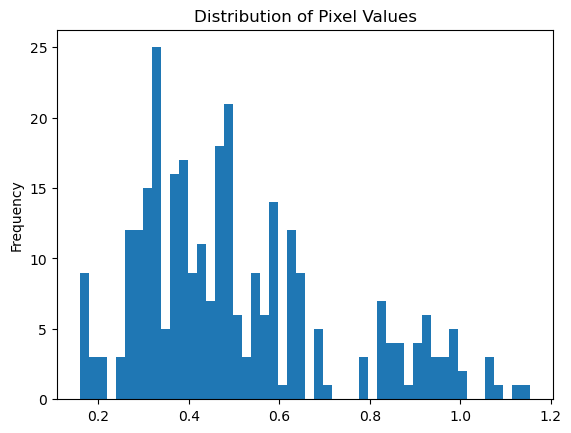

Correctly classified scan number  31 . Pixel distribution plot.


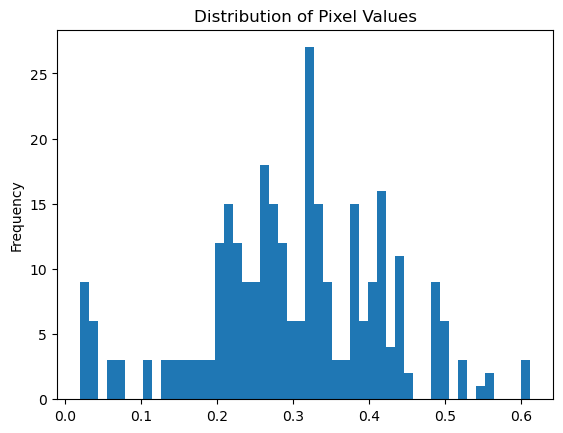

Correctly classified scan number  32 . Pixel distribution plot.


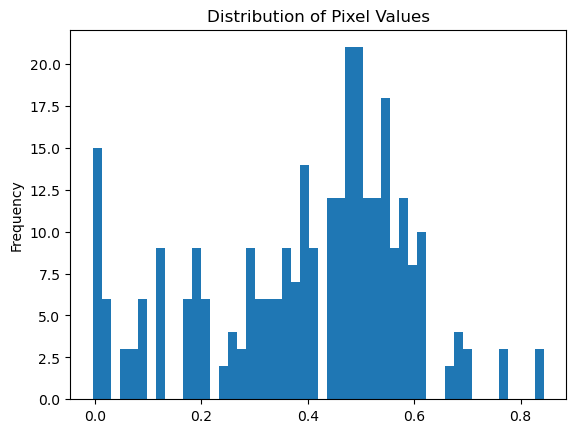

Correctly classified scan number  33 . Pixel distribution plot.


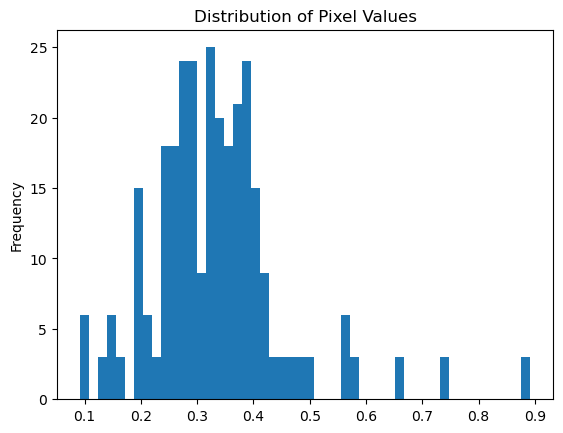

Correctly classified scan number  34 . Pixel distribution plot.


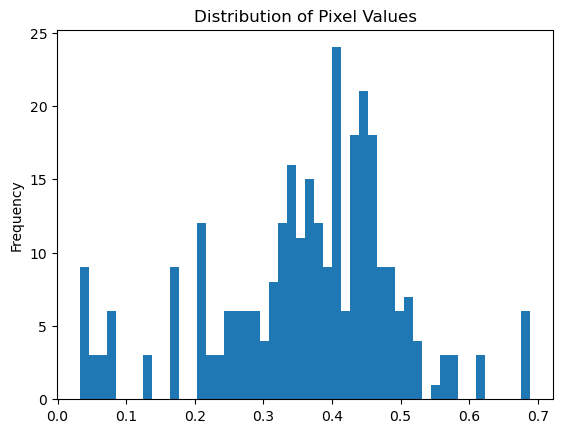

Correctly classified scan number  35 . Pixel distribution plot.


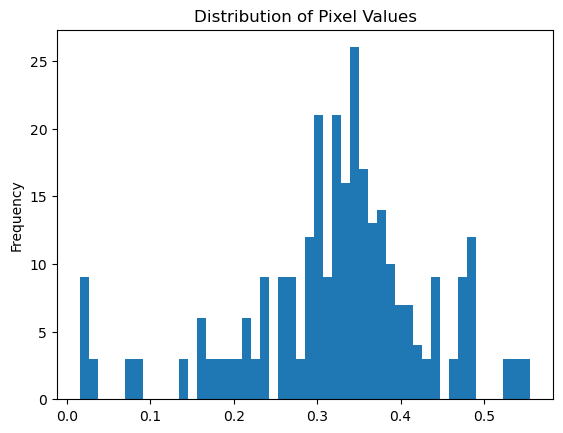

Correctly classified scan number  36 . Pixel distribution plot.


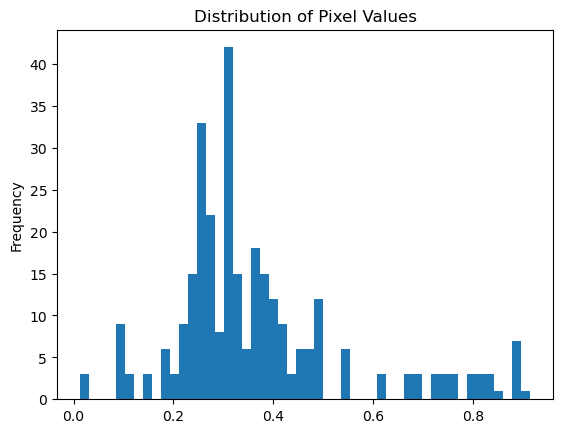

Correctly classified scan number  37 . Pixel distribution plot.


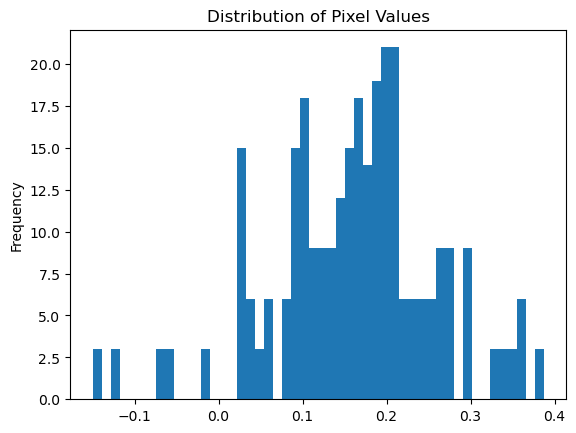

Correctly classified scan number  38 . Pixel distribution plot.


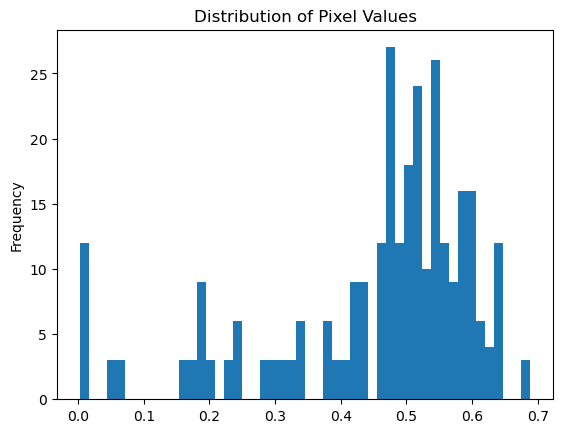

Correctly classified scan number  39 . Pixel distribution plot.


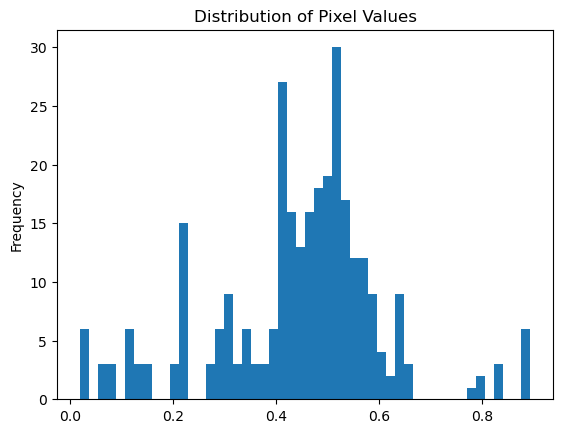

Correctly classified scan number  40 . Pixel distribution plot.


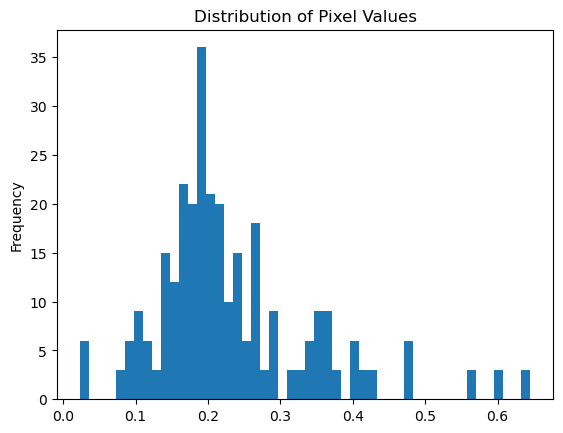

Correctly classified scan number  41 . Pixel distribution plot.


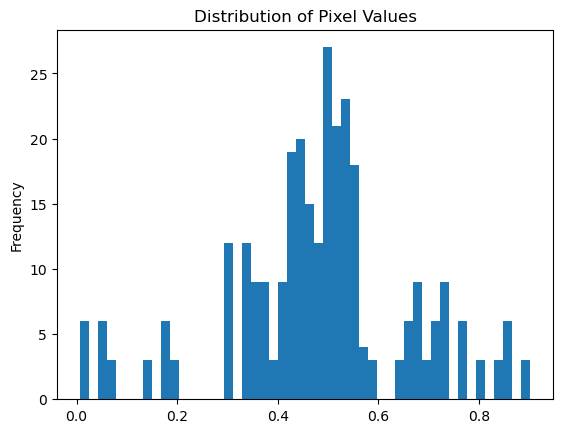

Correctly classified scan number  42 . Pixel distribution plot.


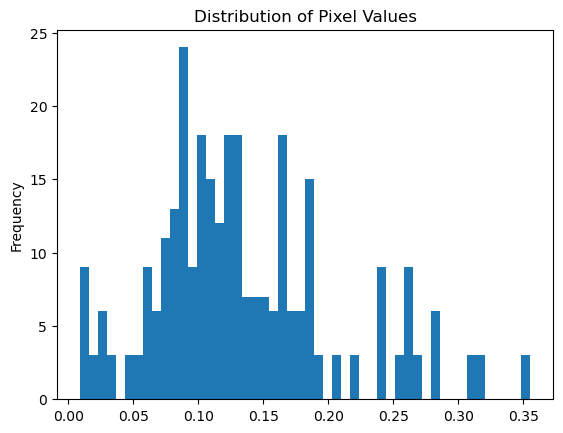

Correctly classified scan number  43 . Pixel distribution plot.


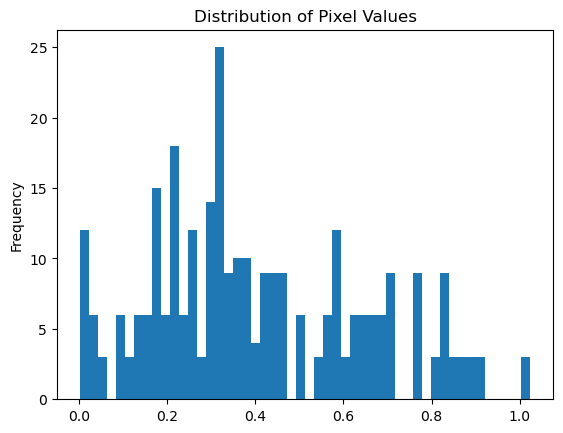

Correctly classified scan number  44 . Pixel distribution plot.


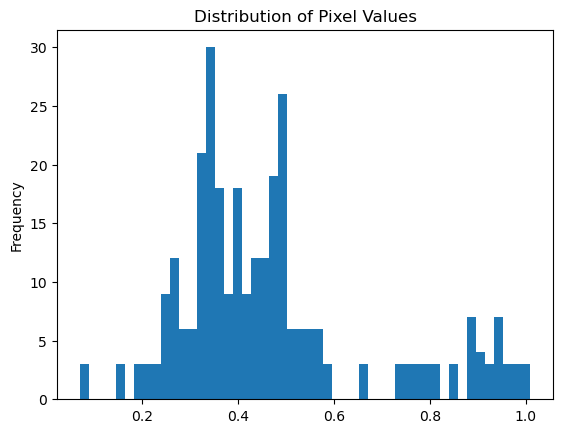

Correctly classified scan number  45 . Pixel distribution plot.


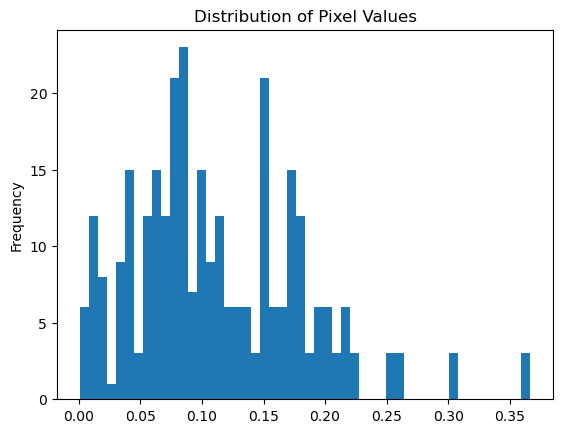

Correctly classified scan number  46 . Pixel distribution plot.


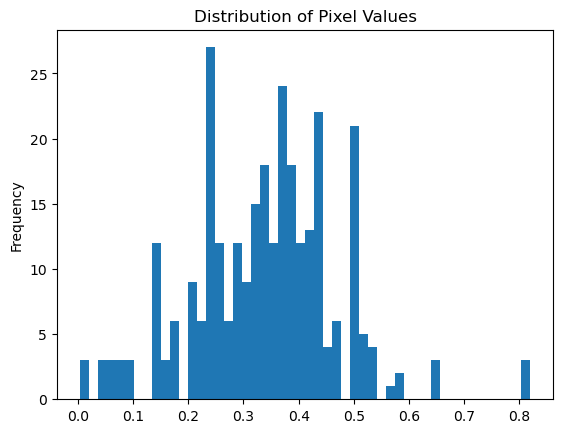

Correctly classified scan number  47 . Pixel distribution plot.


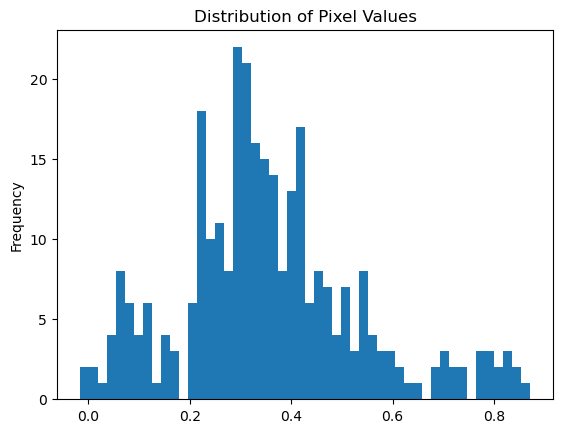

Correctly classified scan number  48 . Pixel distribution plot.


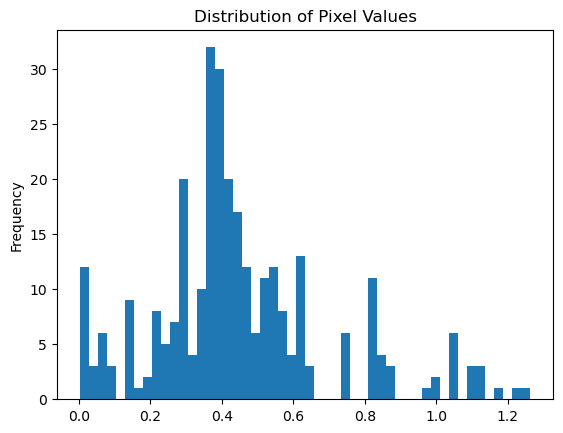

Correctly classified scan number  50 . Pixel distribution plot.


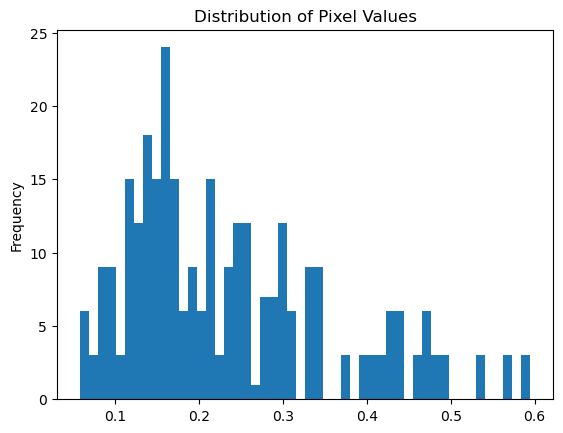

Correctly classified scan number  51 . Pixel distribution plot.


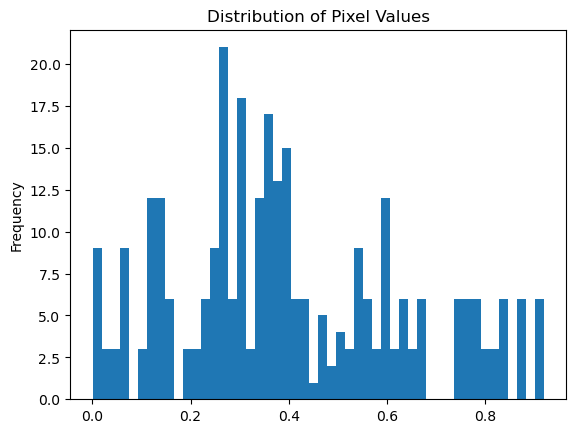

Correctly classified scan number  52 . Pixel distribution plot.


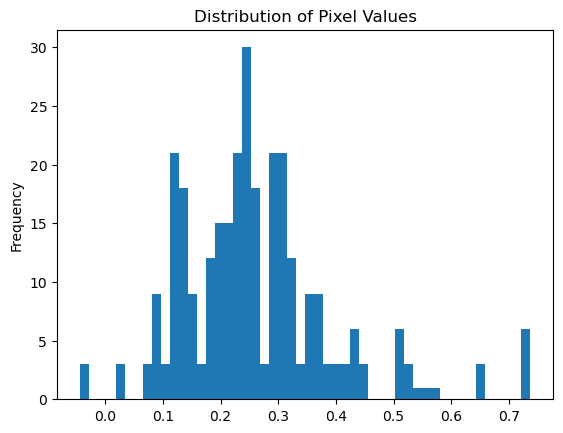

Correctly classified scan number  54 . Pixel distribution plot.


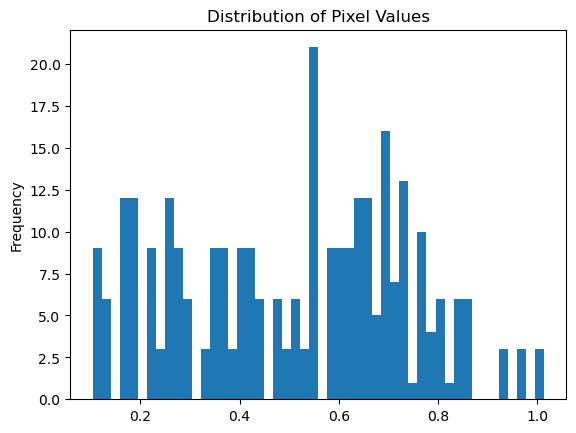

Correctly classified scan number  55 . Pixel distribution plot.


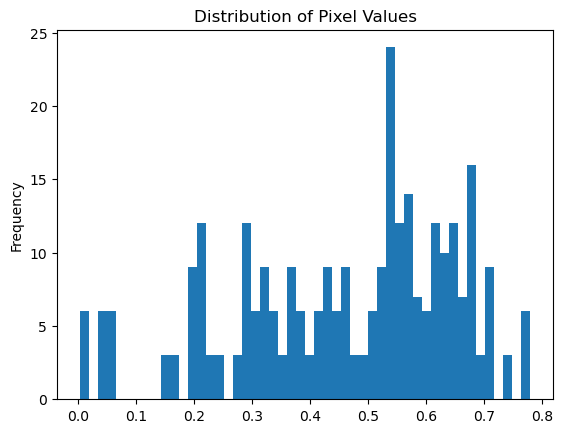

Correctly classified scan number  56 . Pixel distribution plot.


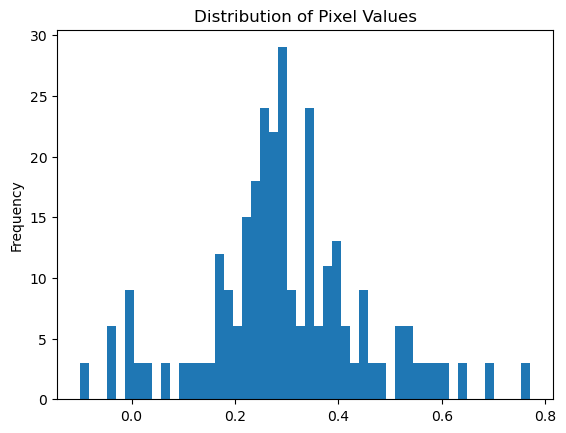

Correctly classified scan number  57 . Pixel distribution plot.


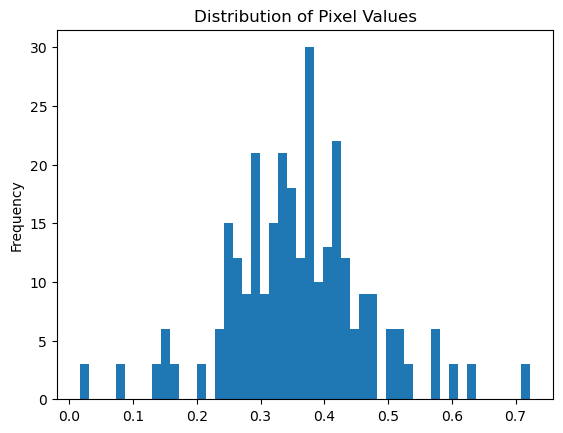

Correctly classified scan number  58 . Pixel distribution plot.


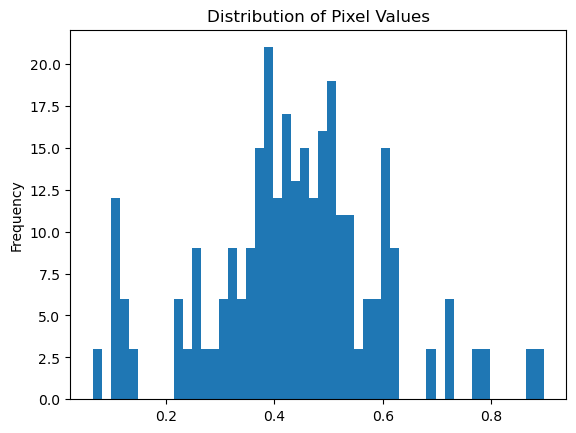

Correctly classified scan number  59 . Pixel distribution plot.


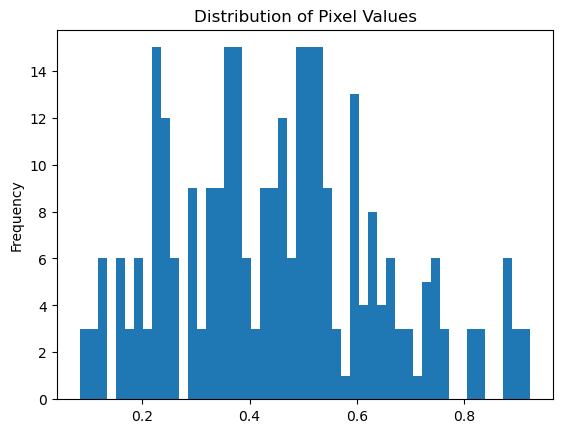

Correctly classified scan number  60 . Pixel distribution plot.


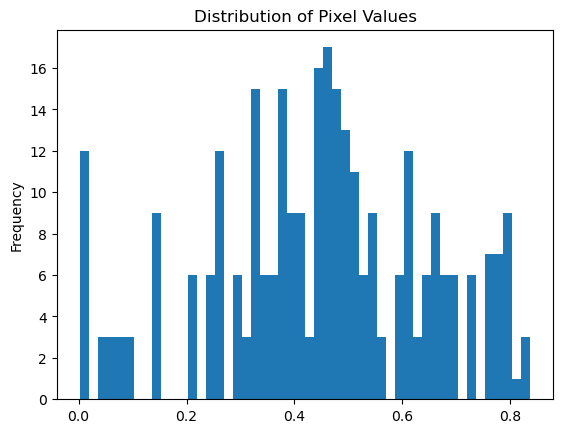

Correctly classified scan number  61 . Pixel distribution plot.


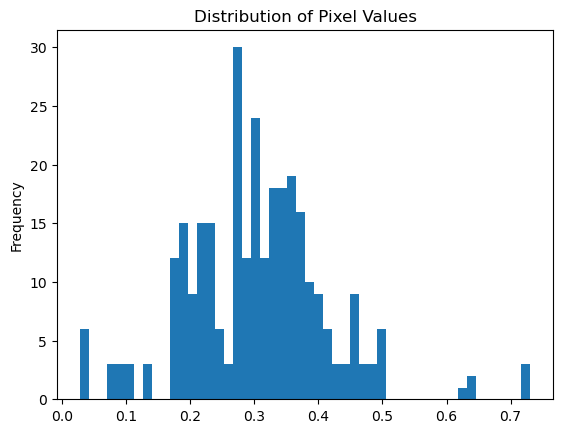

Correctly classified scan number  62 . Pixel distribution plot.


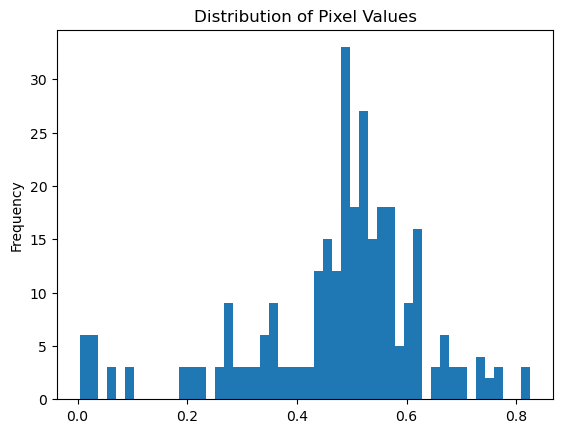

Correctly classified scan number  64 . Pixel distribution plot.


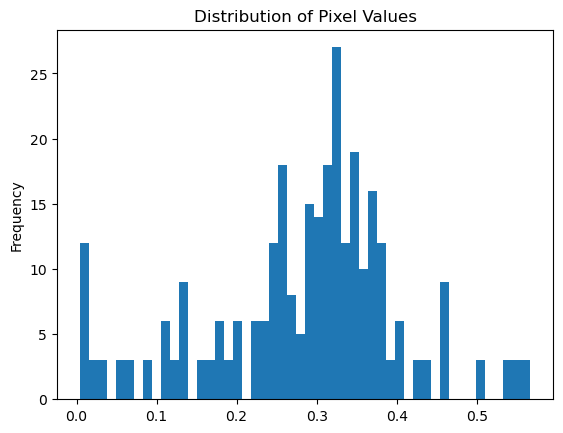

Correctly classified scan number  65 . Pixel distribution plot.


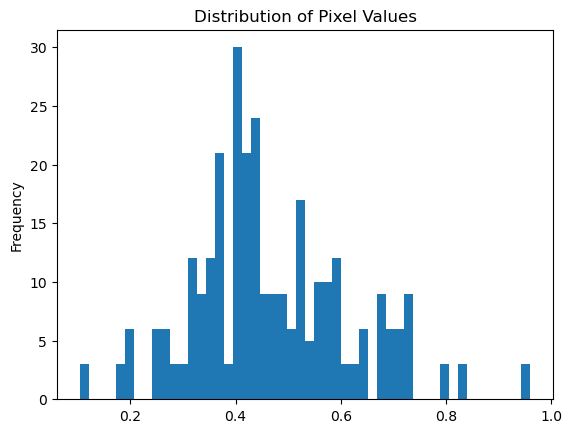

Correctly classified scan number  66 . Pixel distribution plot.


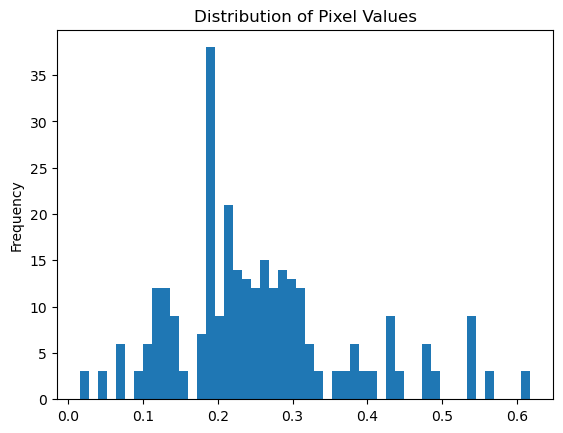

Correctly classified scan number  67 . Pixel distribution plot.


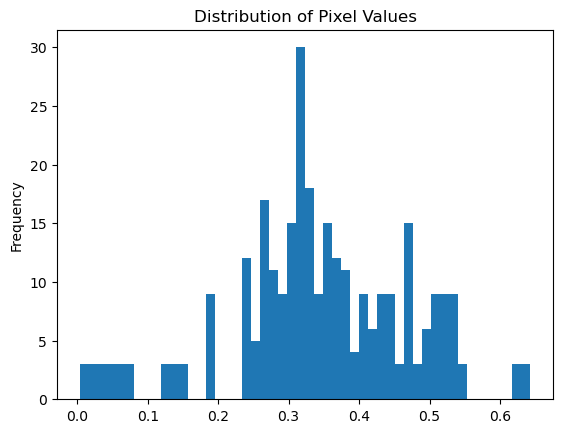

Correctly classified scan number  68 . Pixel distribution plot.


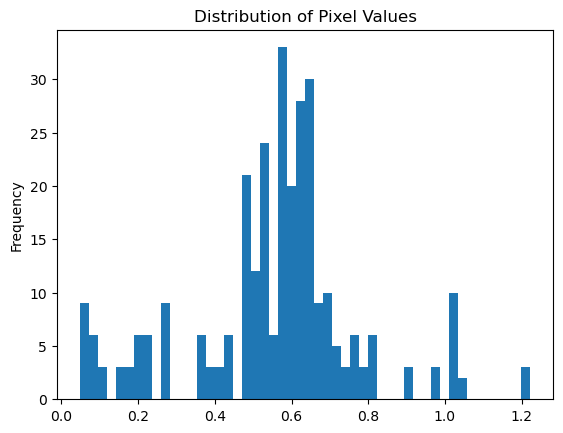

Correctly classified scan number  69 . Pixel distribution plot.


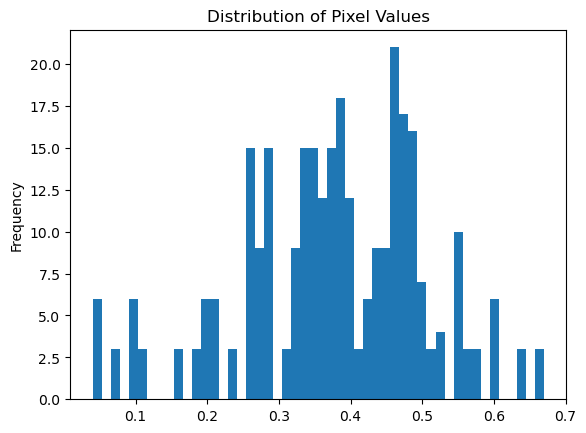

Correctly classified scan number  70 . Pixel distribution plot.


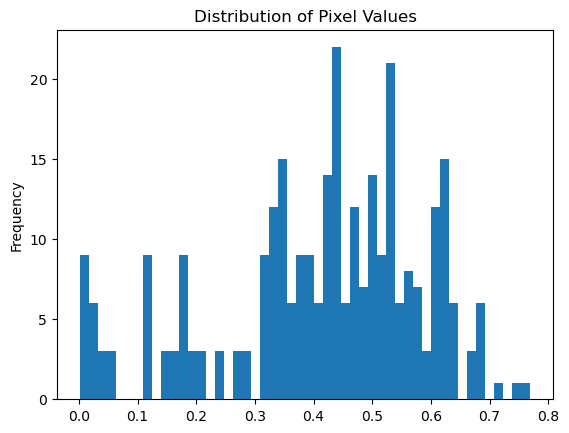

Correctly classified scan number  71 . Pixel distribution plot.


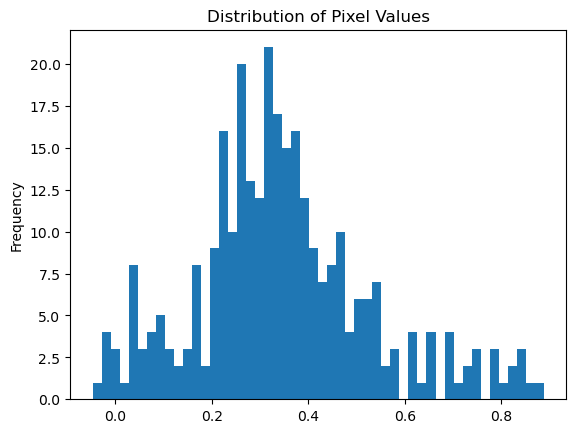

Correctly classified scan number  72 . Pixel distribution plot.


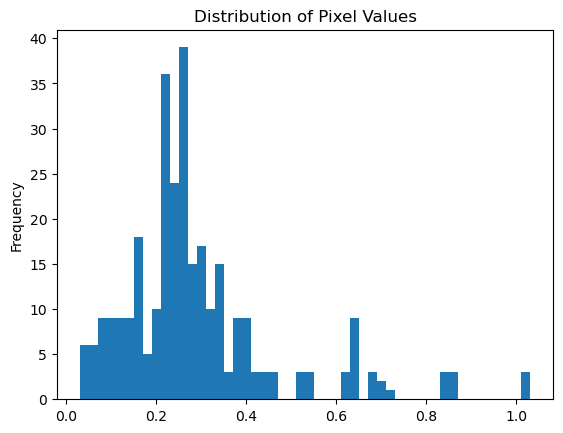

Correctly classified scan number  73 . Pixel distribution plot.


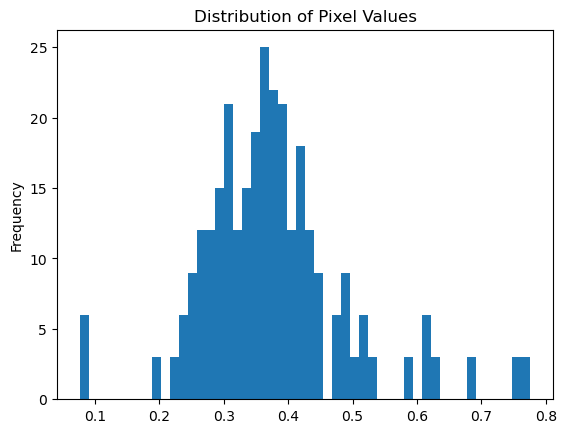

Correctly classified scan number  74 . Pixel distribution plot.


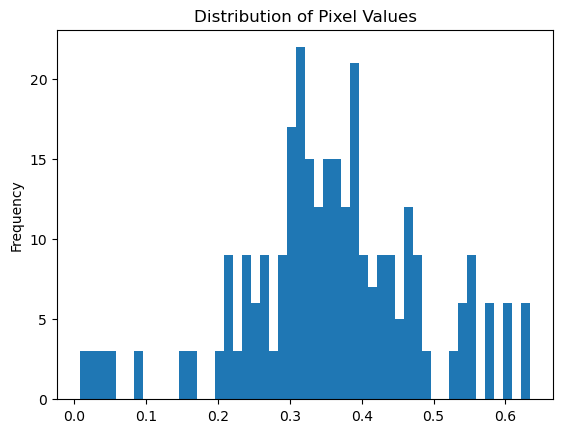

Correctly classified scan number  75 . Pixel distribution plot.


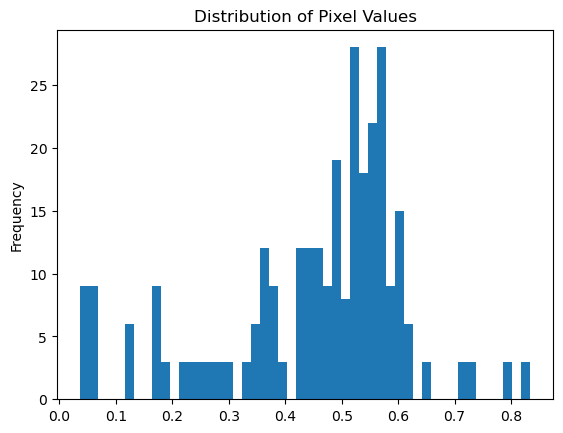

Correctly classified scan number  76 . Pixel distribution plot.


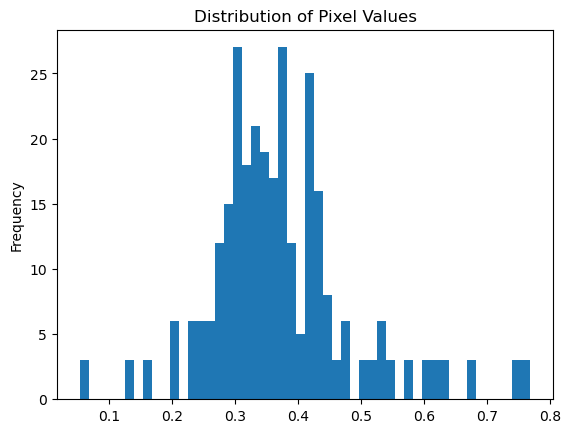

Correctly classified scan number  77 . Pixel distribution plot.


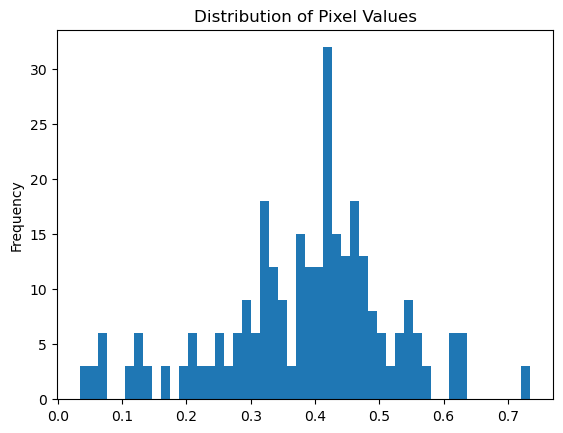

Correctly classified scan number  78 . Pixel distribution plot.


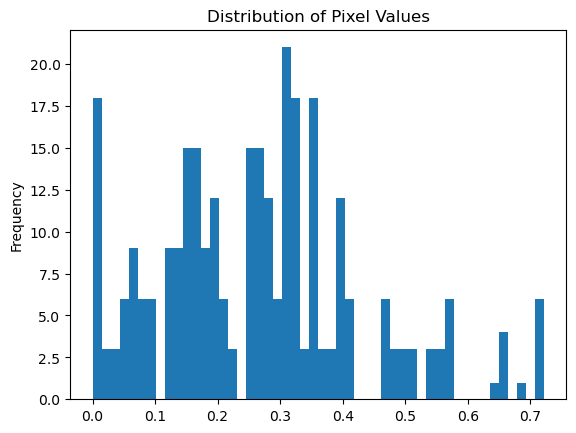

Correctly classified scan number  79 . Pixel distribution plot.


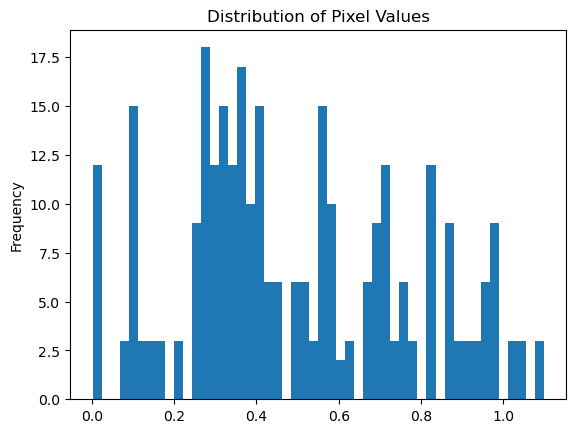

In [119]:
### Distribution plots for ALL correctly classified images
for i in cindex:
    print('Correctly classified scan number ',i,'. Pixel distribution plot.')
    pd.Series(X_testmm[i].flatten()).plot(kind='hist', bins=50, title='Distribution of Pixel Values')
    plt.show()

Incorrectly classified scan number  2 . Pixel distribution plot.


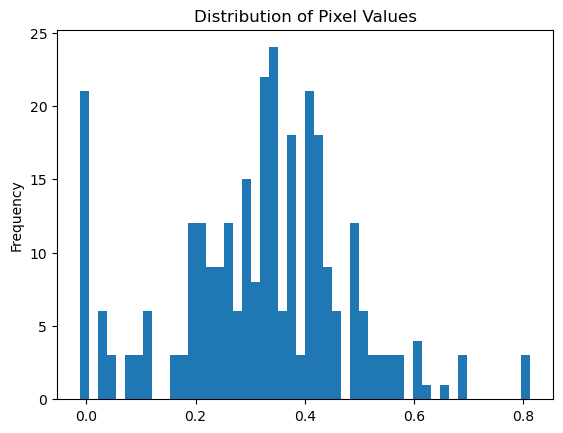

Incorrectly classified scan number  8 . Pixel distribution plot.


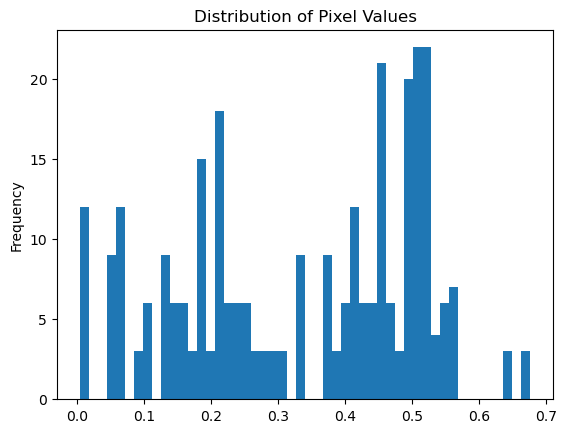

Incorrectly classified scan number  9 . Pixel distribution plot.


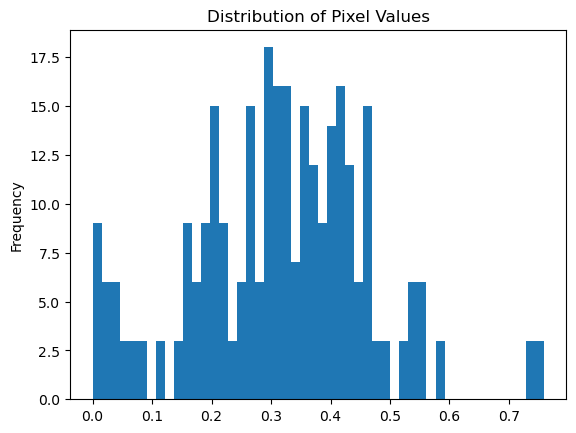

Incorrectly classified scan number  14 . Pixel distribution plot.


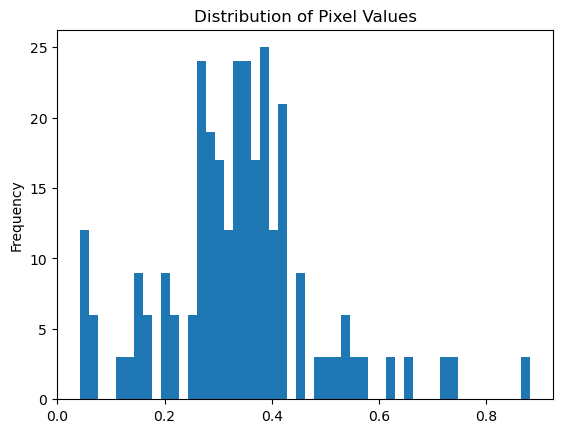

Incorrectly classified scan number  49 . Pixel distribution plot.


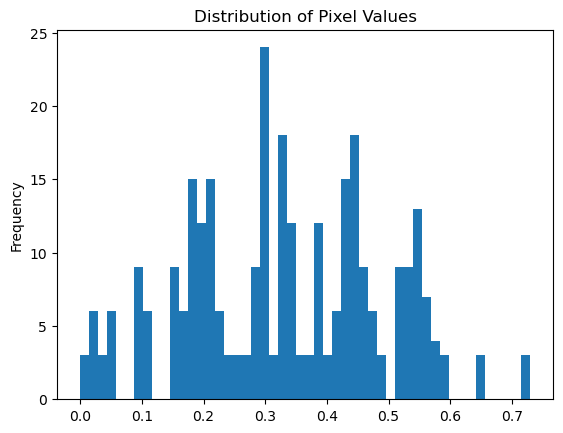

Incorrectly classified scan number  53 . Pixel distribution plot.


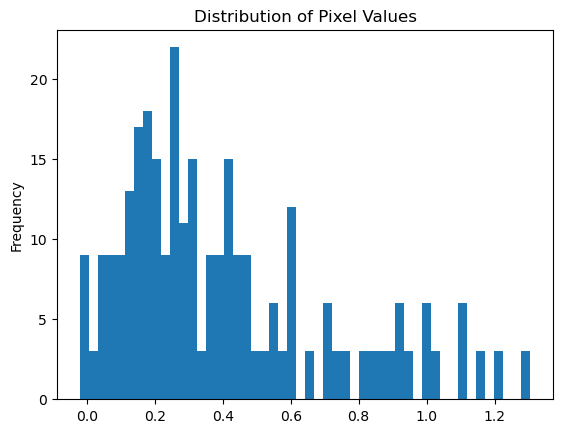

Incorrectly classified scan number  63 . Pixel distribution plot.


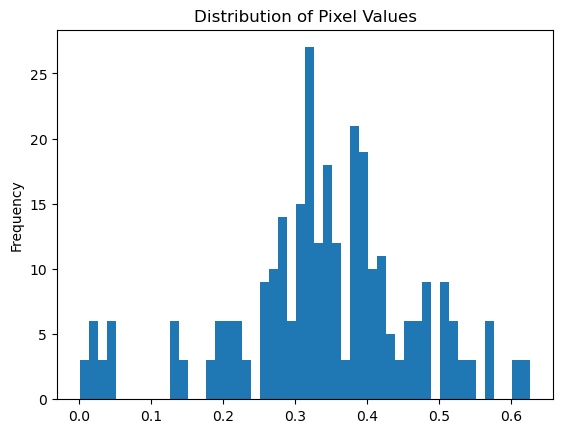

In [107]:
### Distribution plots for ALL incorrectly classified images
for i in incindex:
    print('Incorrectly classified scan number ',i,'. Pixel distribution plot.')
    pd.Series(X_testmm[i].flatten()).plot(kind='hist', bins=50, title='Distribution of Pixel Values')
    plt.show()

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  0 . Pixel distribution plot.


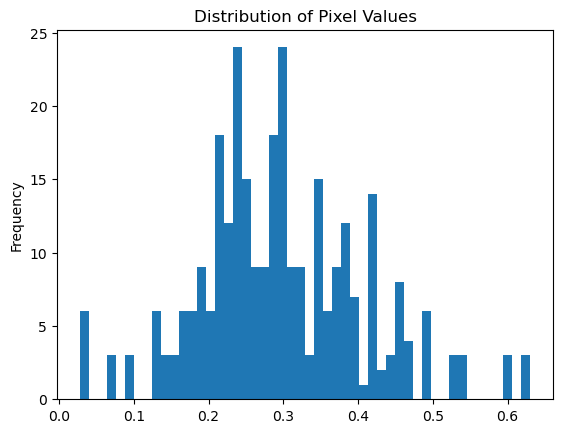

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  1 . Pixel distribution plot.


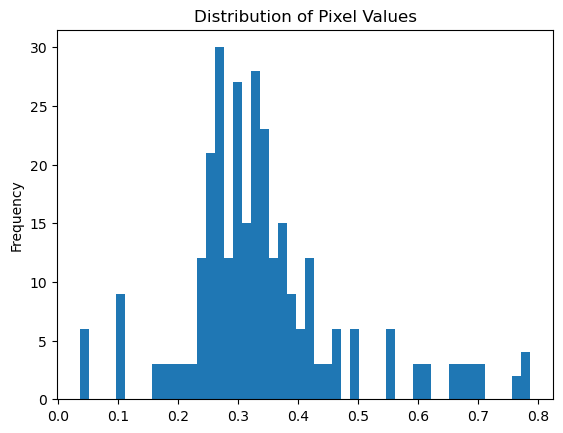

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  3 . Pixel distribution plot.


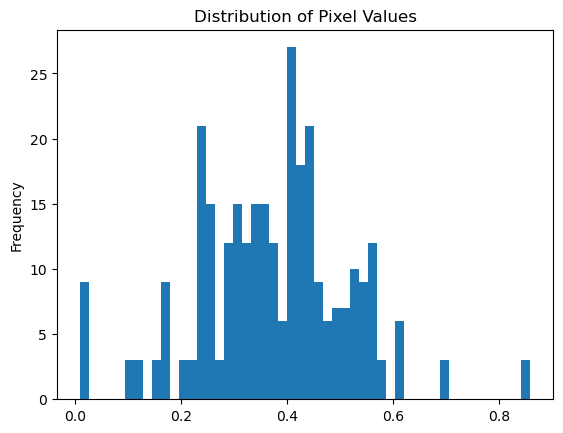

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  4 . Pixel distribution plot.


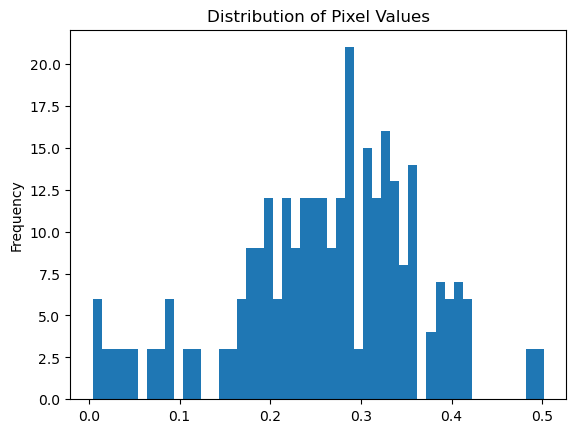

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  5 . Pixel distribution plot.


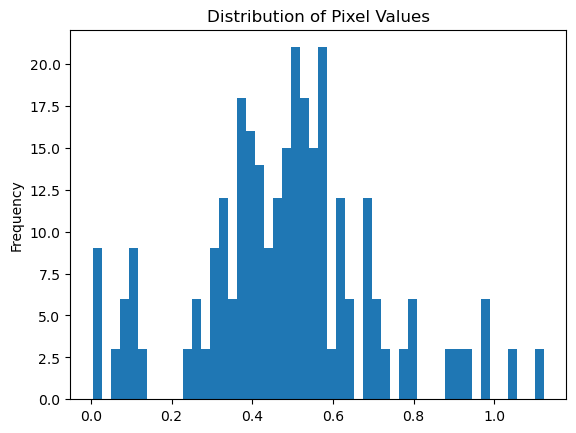

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  6 . Pixel distribution plot.


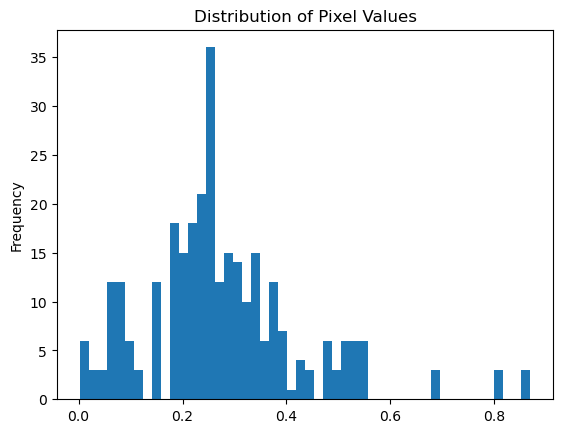

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  7 . Pixel distribution plot.


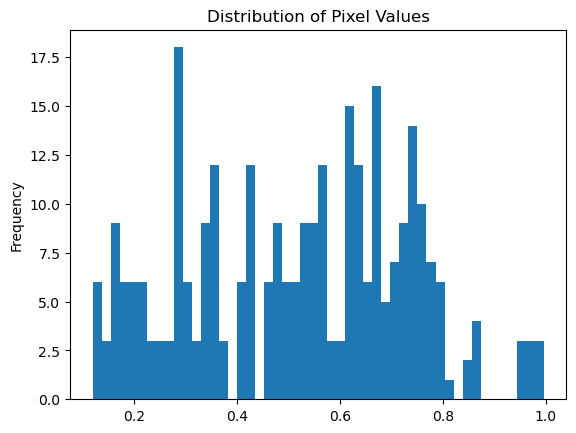

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  10 . Pixel distribution plot.


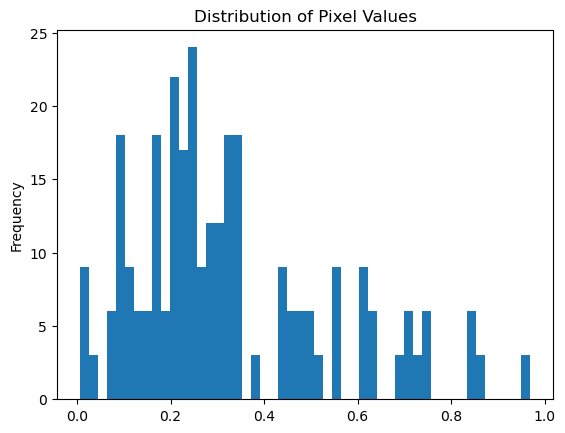

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  11 . Pixel distribution plot.


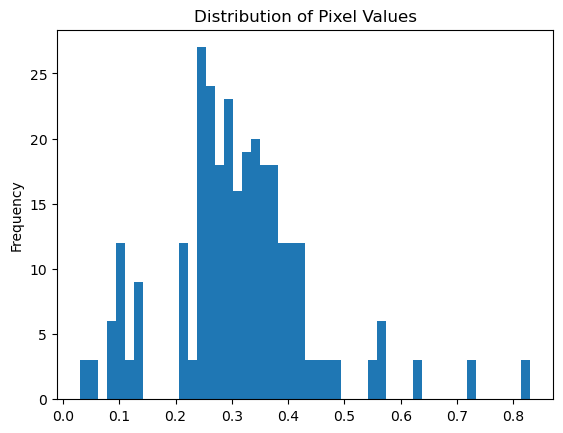

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  12 . Pixel distribution plot.


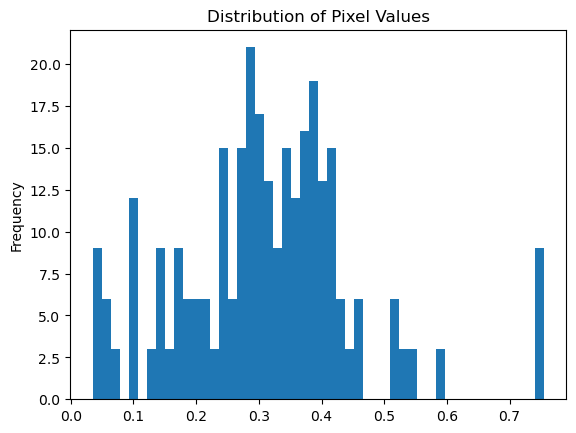

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  13 . Pixel distribution plot.


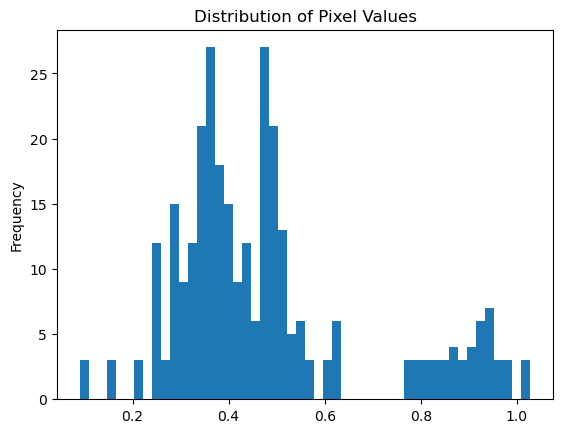

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  15 . Pixel distribution plot.


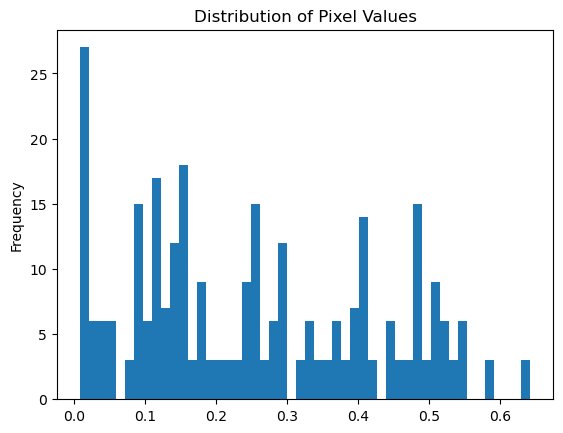

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  16 . Pixel distribution plot.


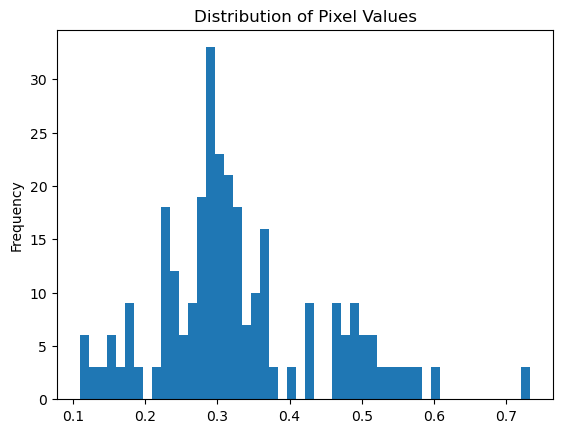

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  17 . Pixel distribution plot.


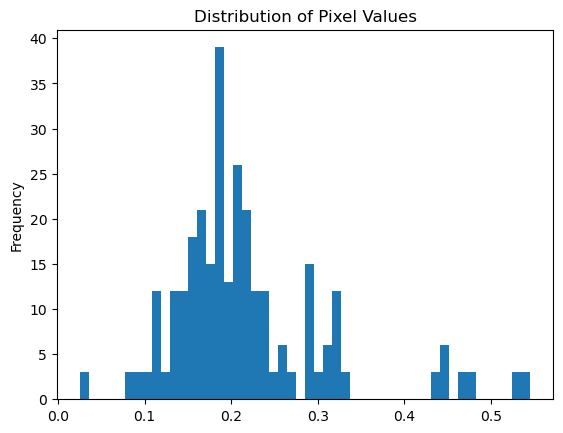

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  18 . Pixel distribution plot.


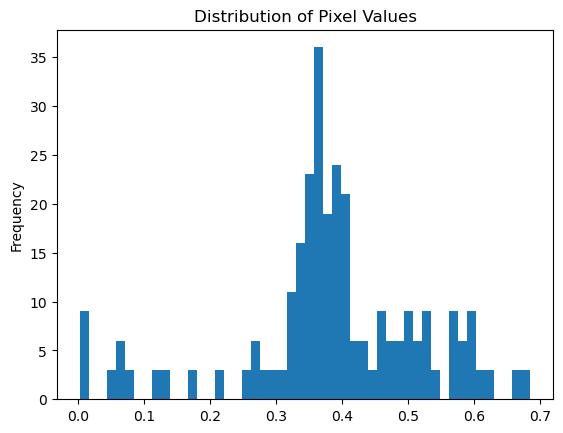

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  19 . Pixel distribution plot.


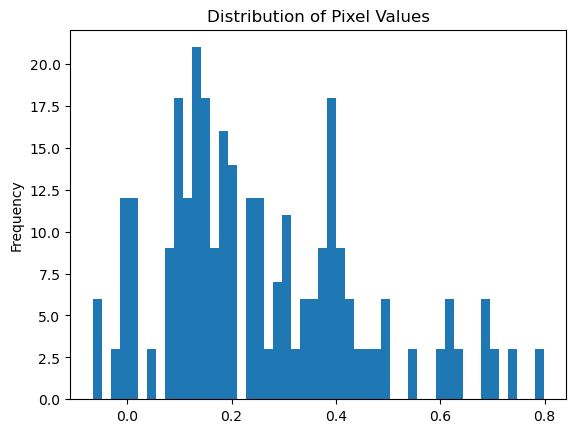

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  20 . Pixel distribution plot.


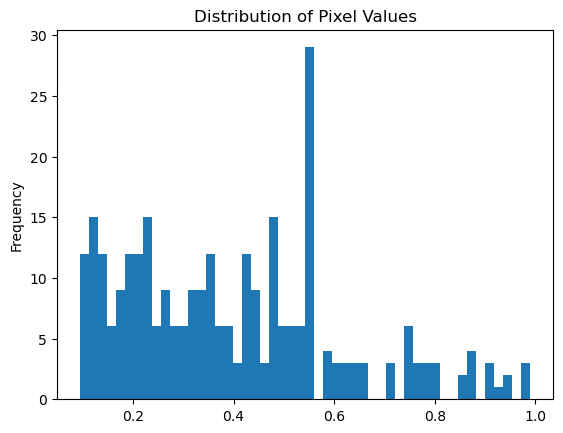

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  21 . Pixel distribution plot.


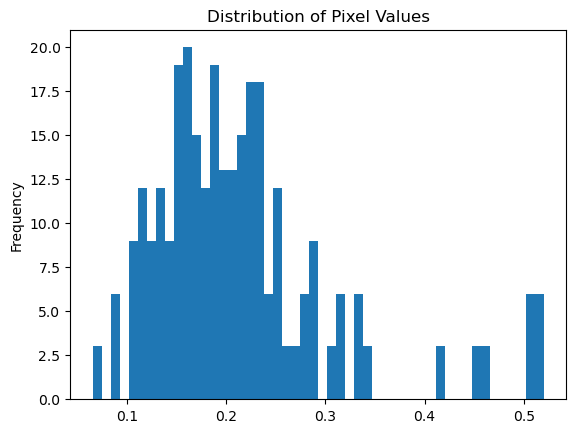

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  22 . Pixel distribution plot.


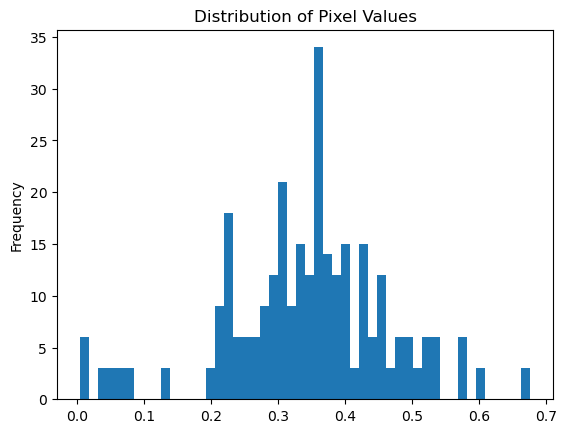

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  23 . Pixel distribution plot.


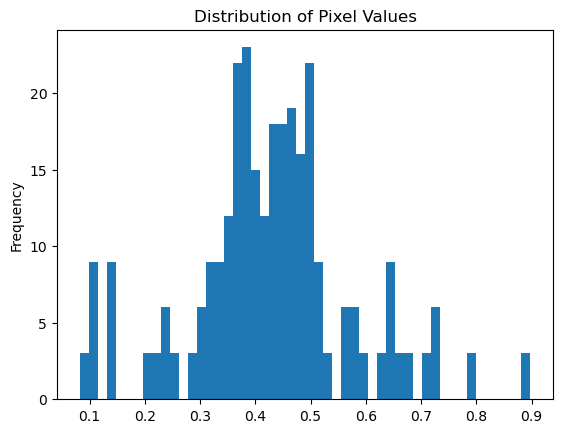

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  24 . Pixel distribution plot.


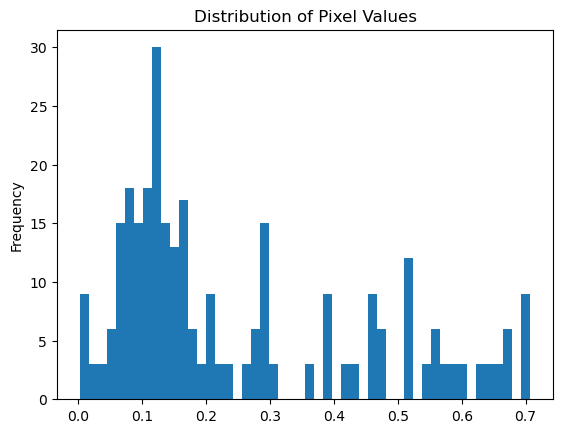

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  25 . Pixel distribution plot.


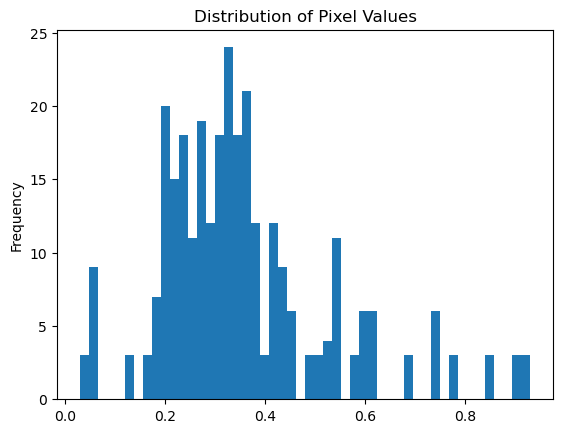

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  26 . Pixel distribution plot.


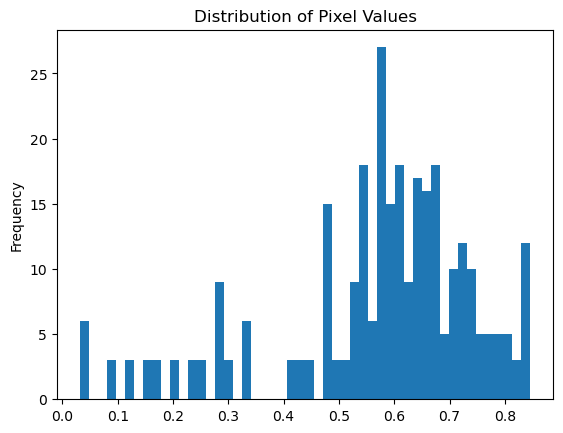

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  27 . Pixel distribution plot.


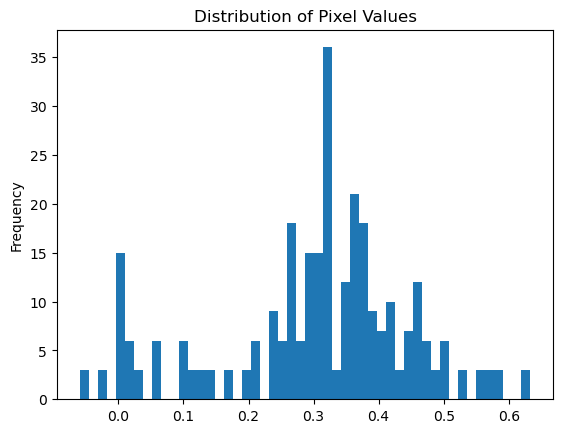

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  28 . Pixel distribution plot.


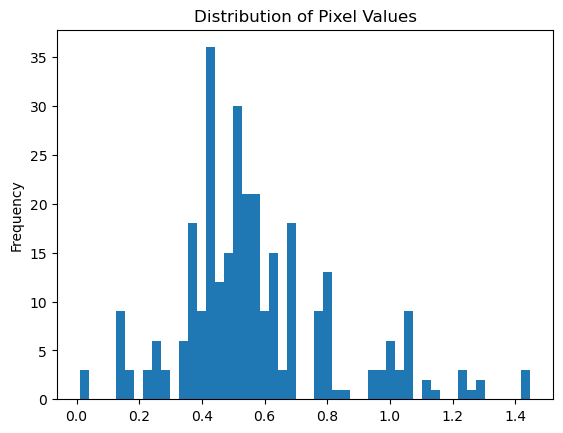

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  29 . Pixel distribution plot.


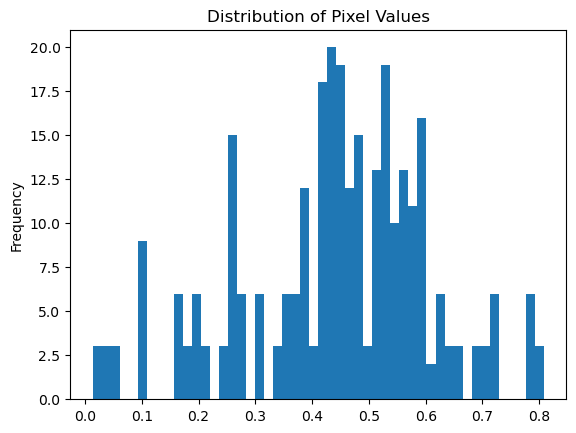

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  30 . Pixel distribution plot.


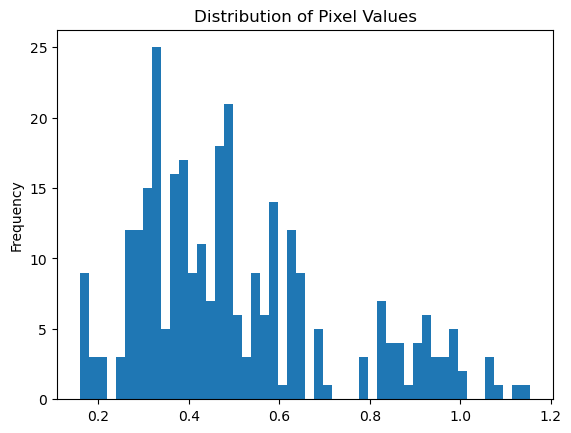

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  31 . Pixel distribution plot.


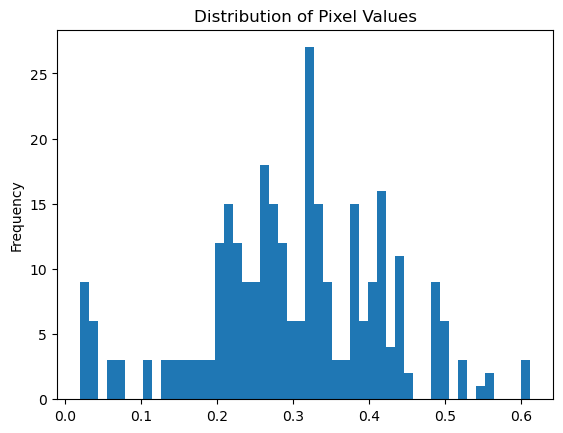

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  32 . Pixel distribution plot.


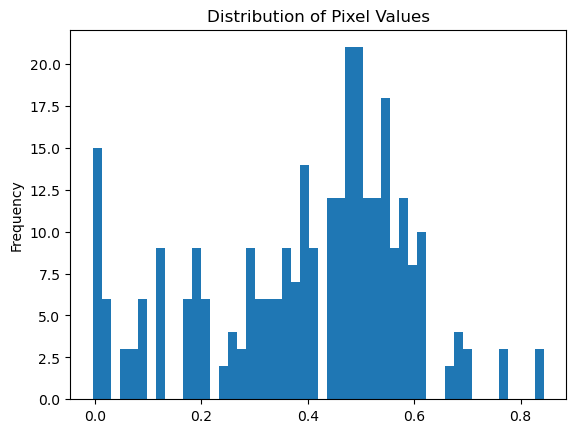

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  33 . Pixel distribution plot.


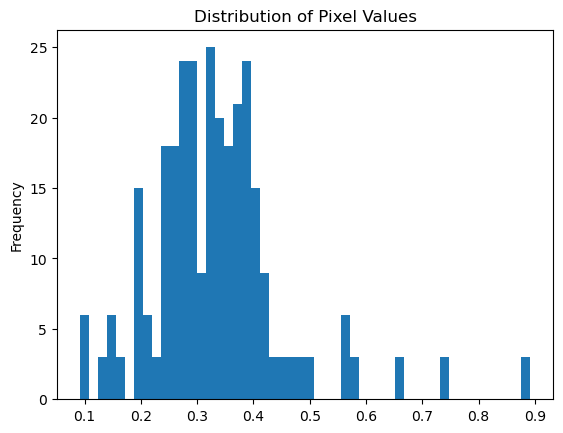

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  34 . Pixel distribution plot.


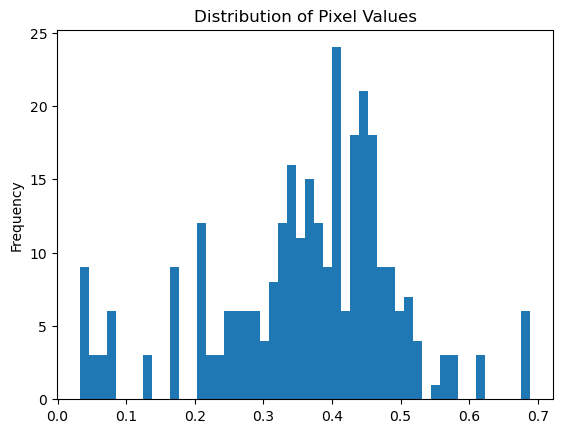

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  35 . Pixel distribution plot.


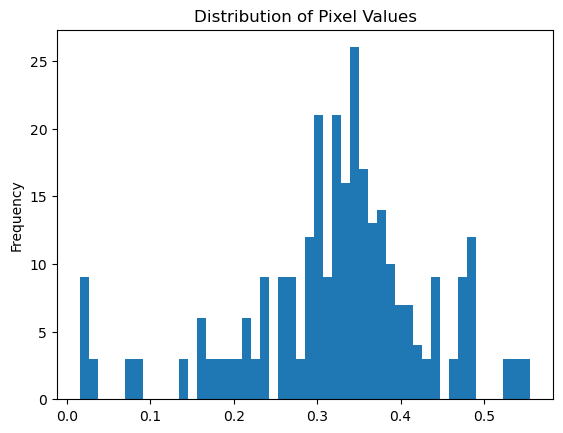

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  36 . Pixel distribution plot.


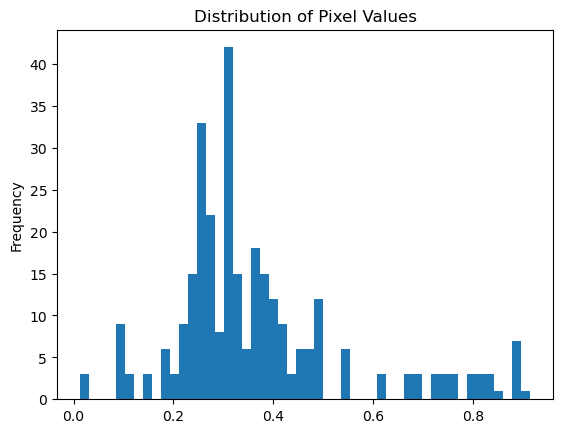

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  37 . Pixel distribution plot.


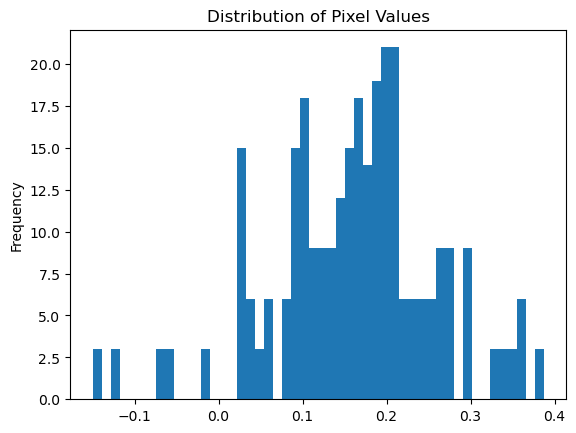

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  38 . Pixel distribution plot.


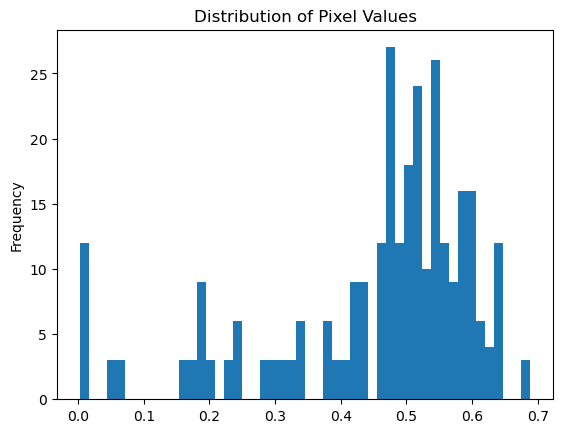

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  39 . Pixel distribution plot.


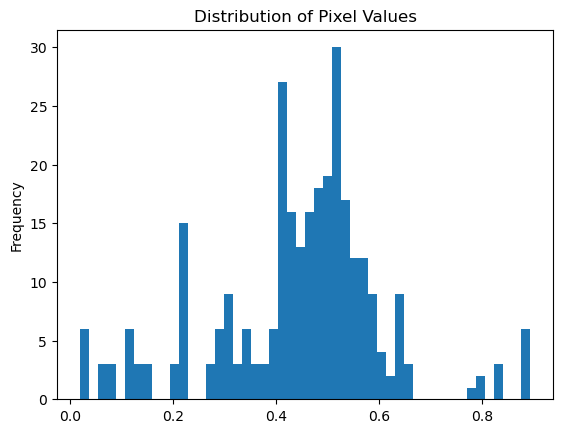

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  40 . Pixel distribution plot.


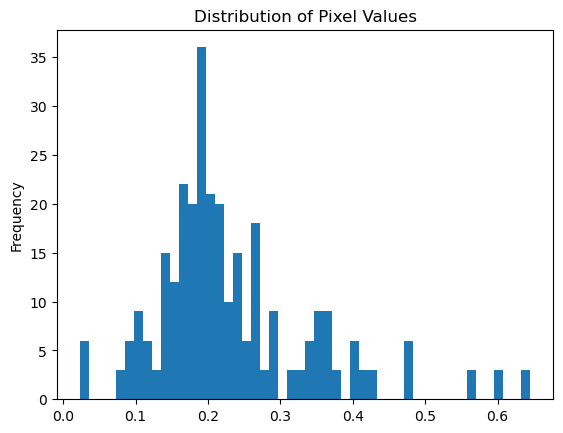

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  41 . Pixel distribution plot.


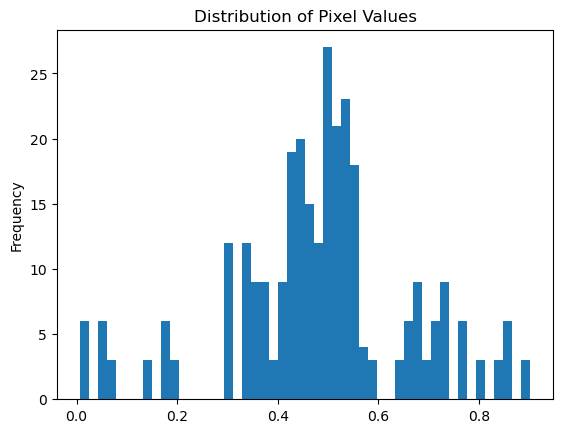

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  42 . Pixel distribution plot.


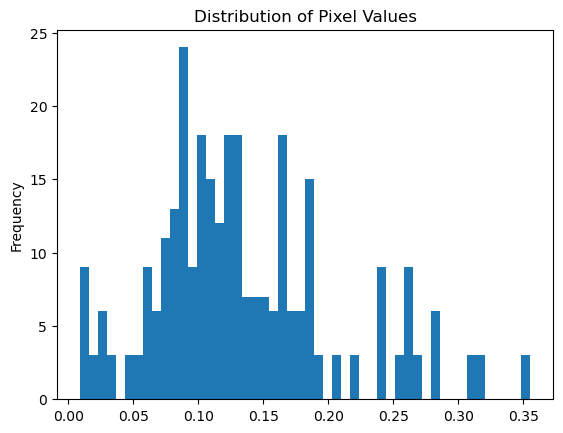

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  43 . Pixel distribution plot.


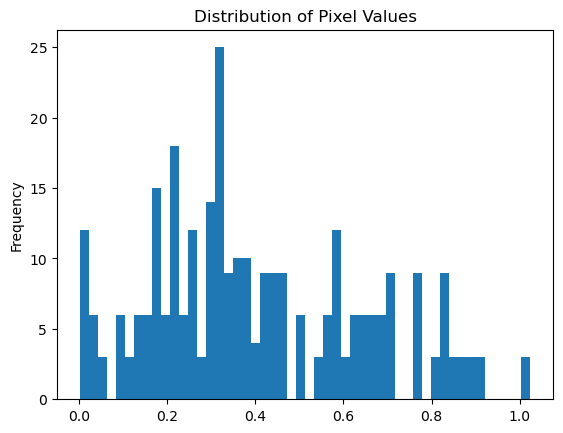

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  44 . Pixel distribution plot.


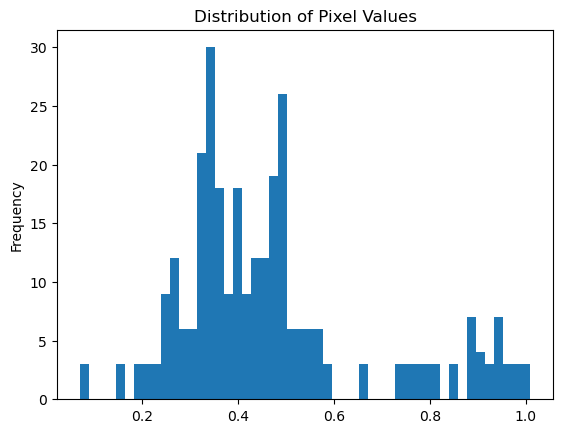

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  45 . Pixel distribution plot.


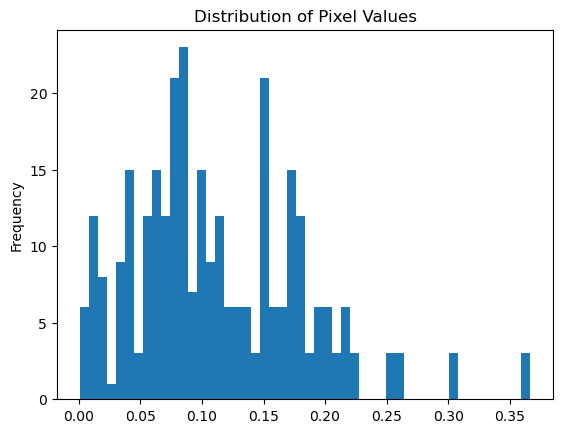

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  46 . Pixel distribution plot.


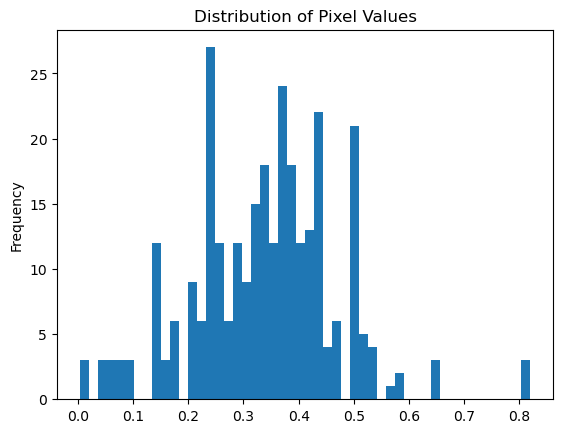

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  47 . Pixel distribution plot.


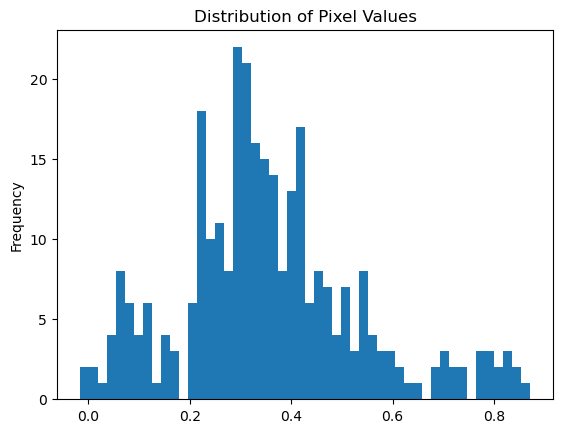

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  48 . Pixel distribution plot.


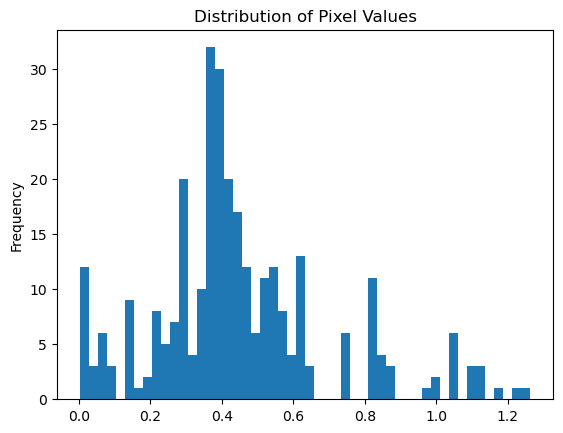

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  50 . Pixel distribution plot.


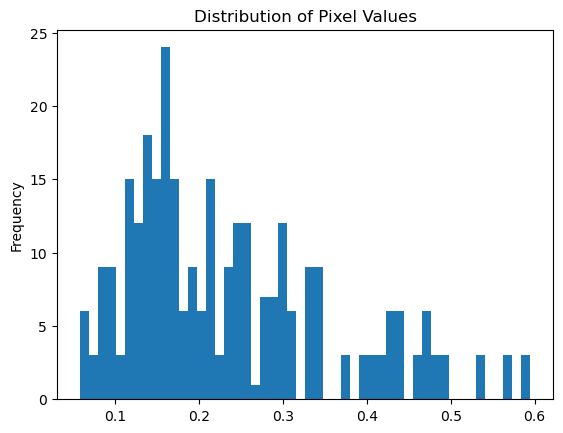

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  51 . Pixel distribution plot.


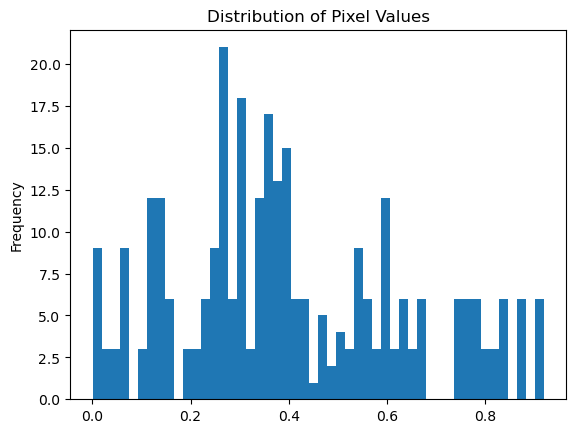

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  52 . Pixel distribution plot.


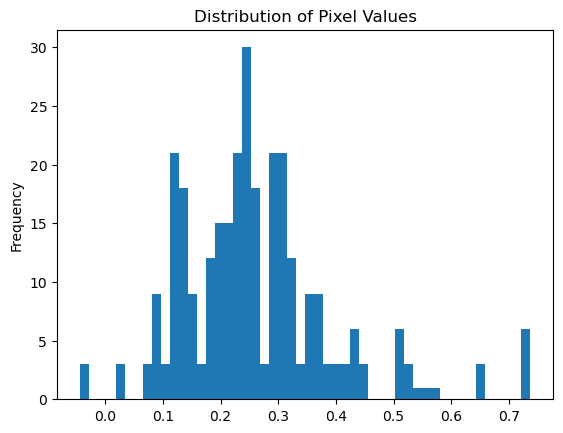

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  54 . Pixel distribution plot.


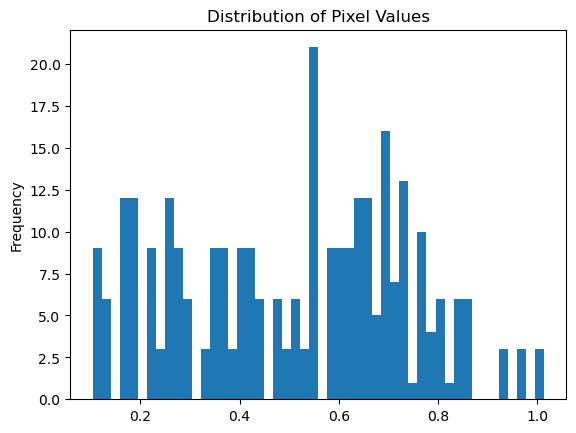

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  55 . Pixel distribution plot.


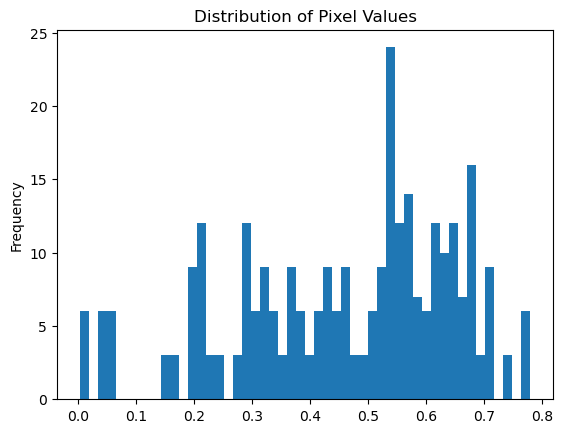

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  56 . Pixel distribution plot.


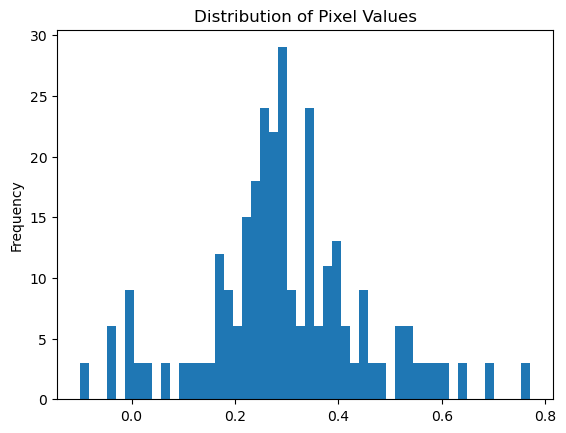

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  57 . Pixel distribution plot.


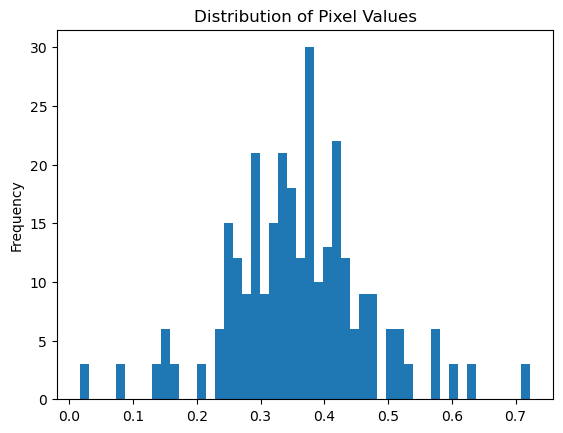

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  58 . Pixel distribution plot.


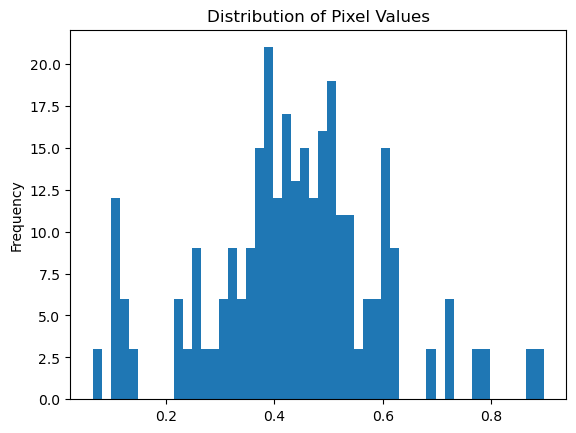

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  59 . Pixel distribution plot.


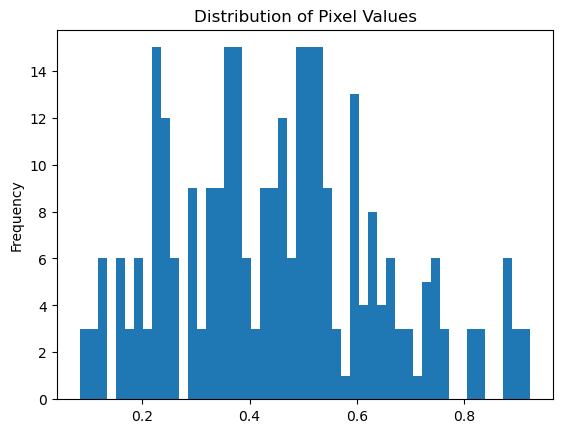

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  60 . Pixel distribution plot.


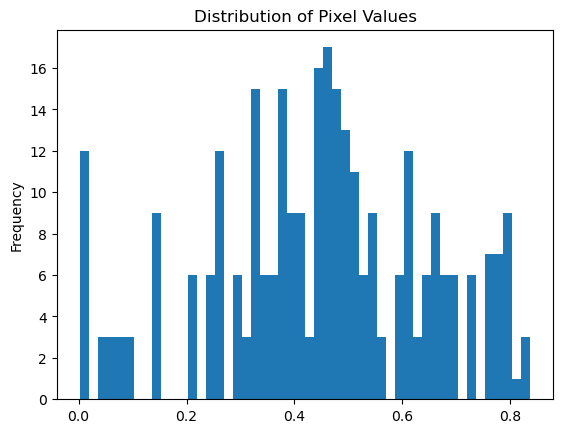

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  61 . Pixel distribution plot.


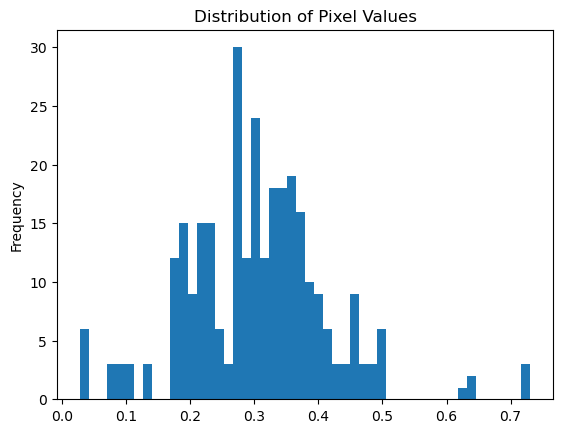

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  62 . Pixel distribution plot.


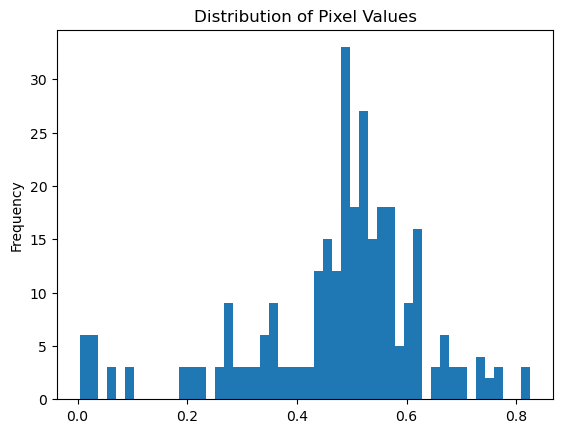

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  64 . Pixel distribution plot.


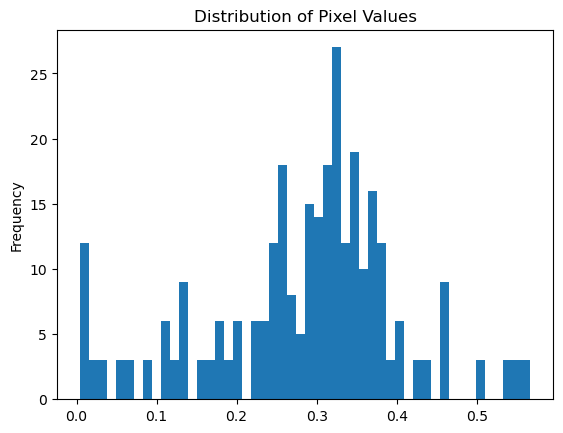

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  65 . Pixel distribution plot.


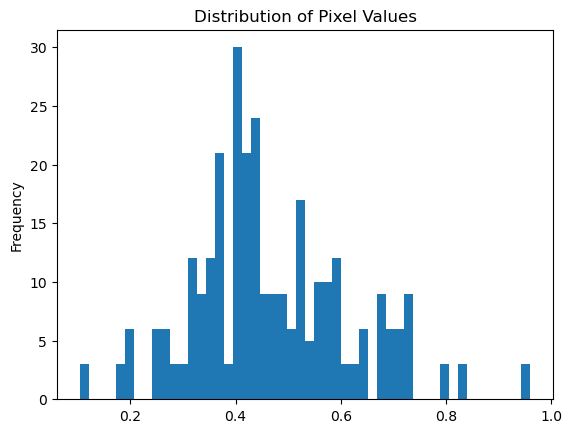

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  66 . Pixel distribution plot.


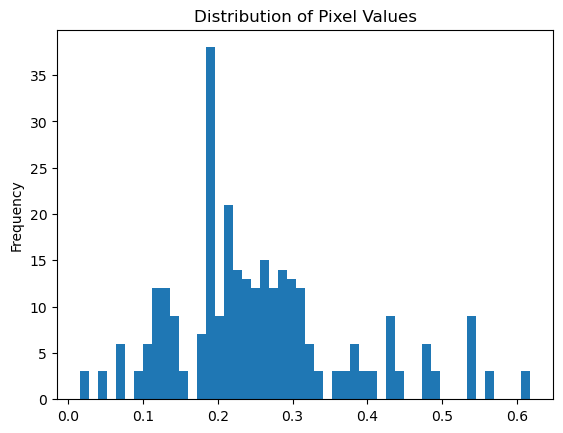

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  67 . Pixel distribution plot.


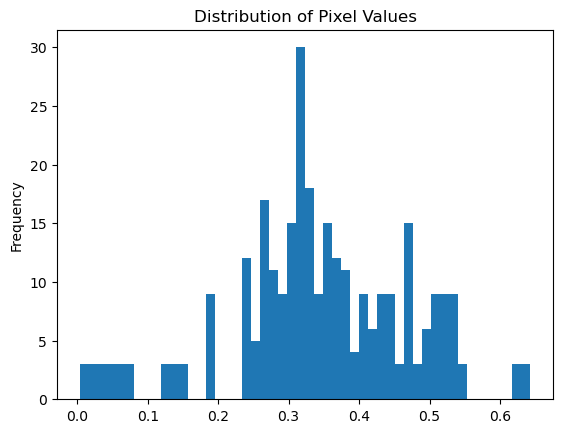

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  68 . Pixel distribution plot.


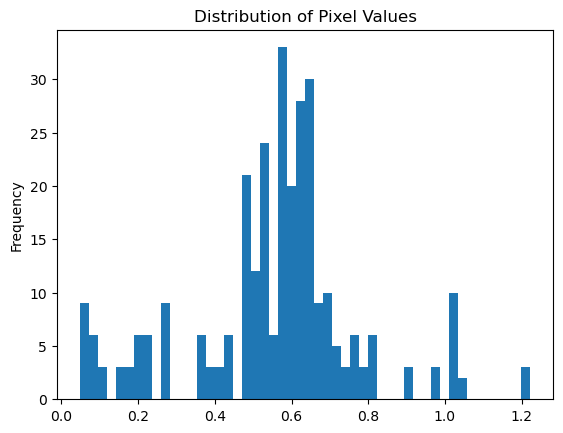

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  69 . Pixel distribution plot.


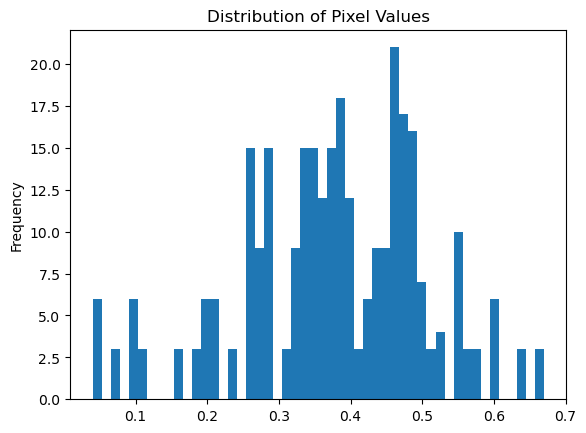

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  70 . Pixel distribution plot.


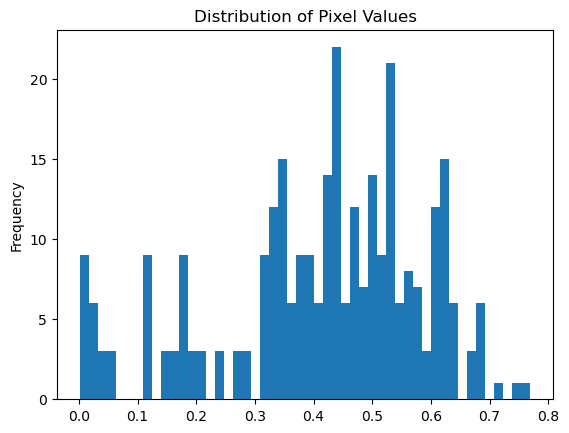

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  71 . Pixel distribution plot.


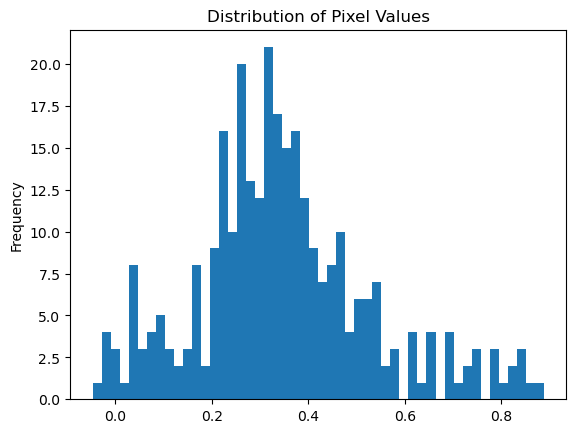

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  72 . Pixel distribution plot.


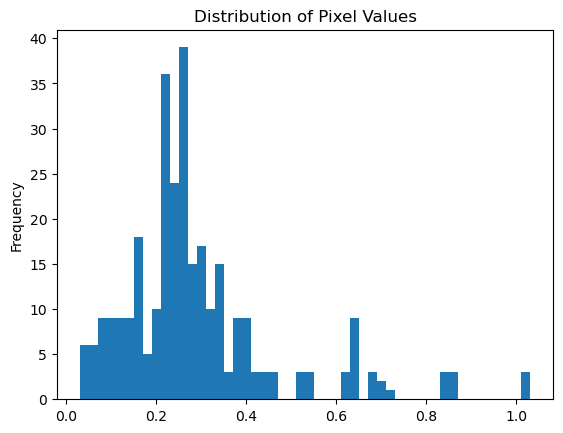

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  73 . Pixel distribution plot.


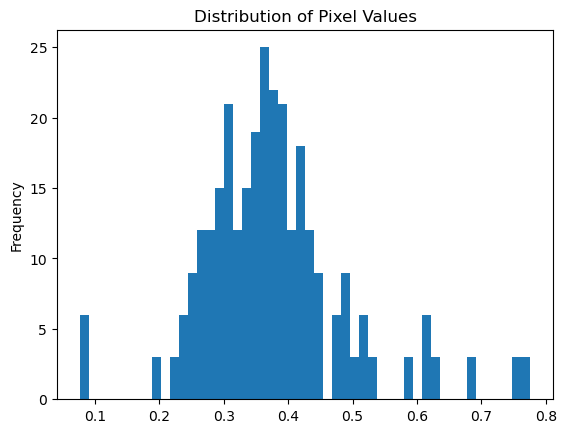

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  74 . Pixel distribution plot.


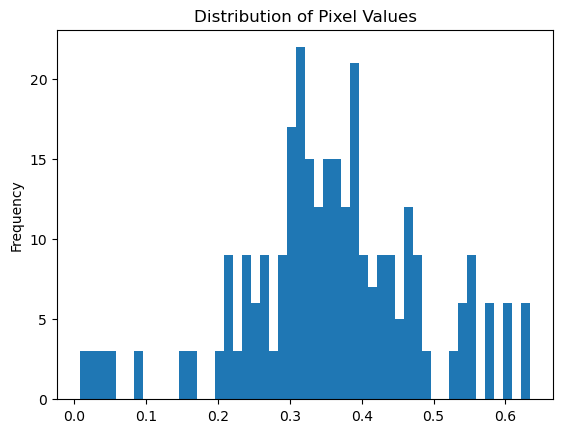

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  75 . Pixel distribution plot.


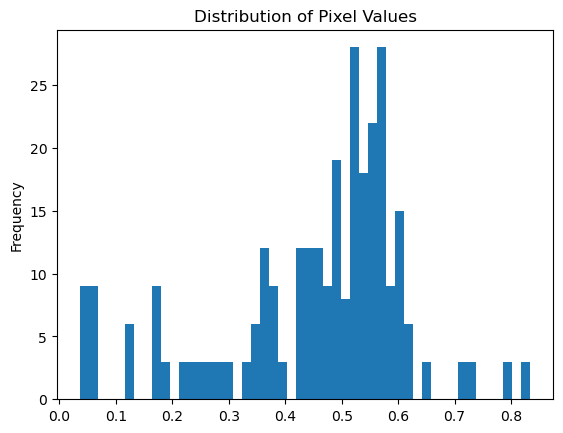

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  76 . Pixel distribution plot.


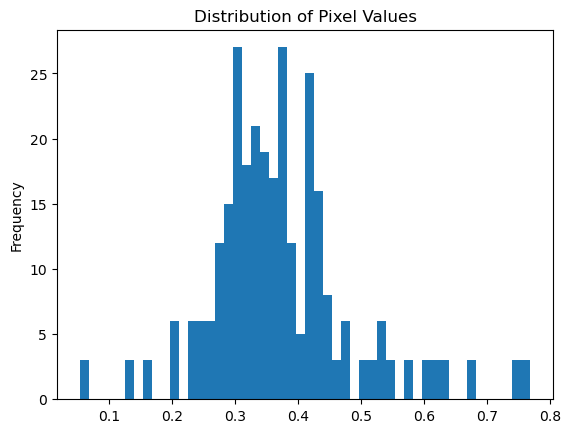

CORRECTLY CLASSIFIED TUMOR MRI
Correctly classified scan number  77 . Pixel distribution plot.


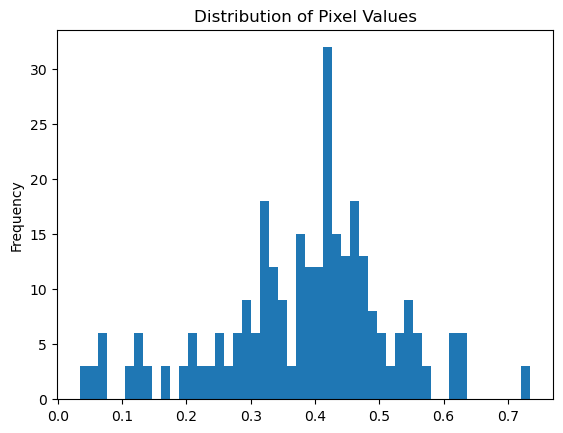

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  78 . Pixel distribution plot.


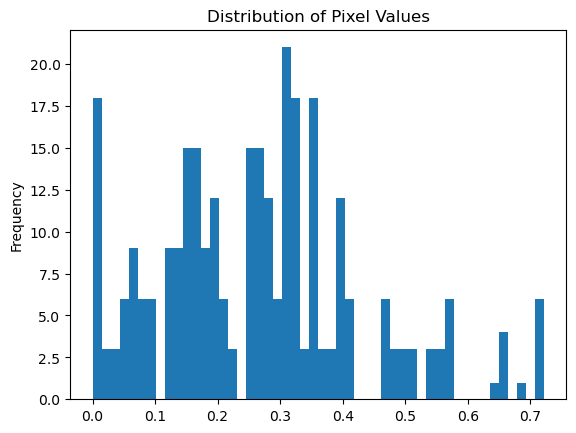

CORRECTLY CLASSIFIED NORMAL MRI
Correctly classified scan number  79 . Pixel distribution plot.


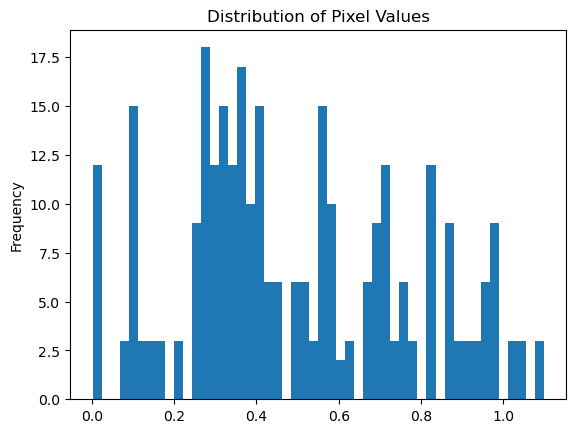

In [108]:
### Distribution plots for correctly classified NORMAL and TUMOR images
for i in cindex:
    if df_test_mm.iloc[i,1] == 0:
        print('CORRECTLY CLASSIFIED NORMAL MRI')
        print('Correctly classified scan number ',i,'. Pixel distribution plot.')
        pd.Series(X_testmm[i].flatten()).plot(kind='hist', bins=50, title='Distribution of Pixel Values')
        plt.show()
    elif df_test_mm.iloc[i,1] == 1:
        print('CORRECTLY CLASSIFIED TUMOR MRI')
        print('Correctly classified scan number ',i,'. Pixel distribution plot.')
        pd.Series(X_testmm[i].flatten()).plot(kind='hist', bins=50, title='Distribution of Pixel Values')
        plt.show()

INCORRECTLY CLASSIFIED TUMOR MRI
Incorrectly classified scan number  2 . Pixel distribution plot.


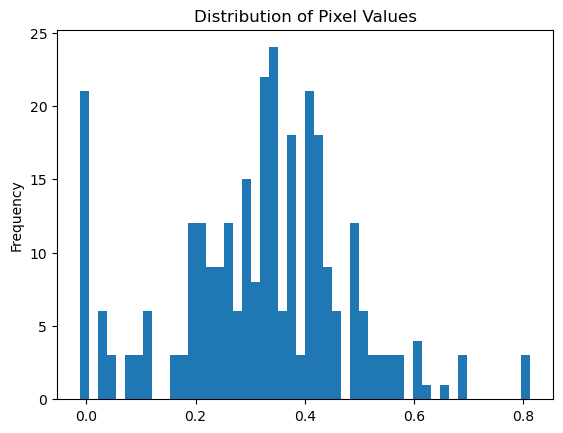

INCORRECTLY CLASSIFIED TUMOR MRI
Incorrectly classified scan number  8 . Pixel distribution plot.


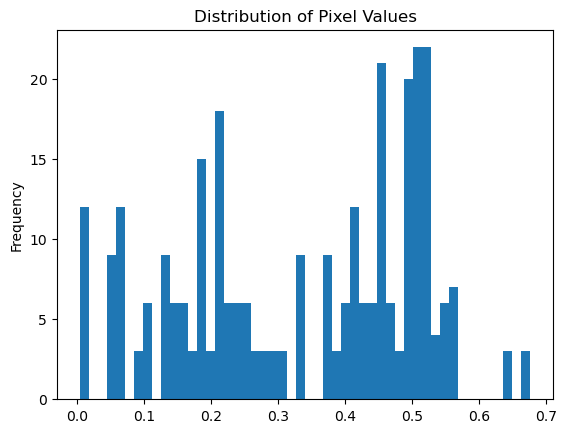

INCORRECTLY CLASSIFIED TUMOR MRI
Incorrectly classified scan number  9 . Pixel distribution plot.


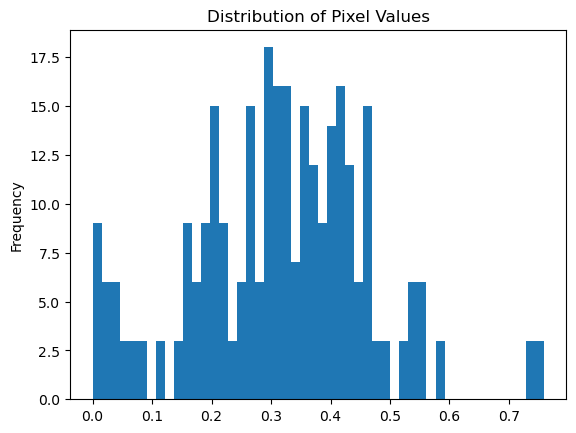

INCORRECTLY CLASSIFIED NORMAL MRI
Incorrectly classified scan number  14 . Pixel distribution plot.


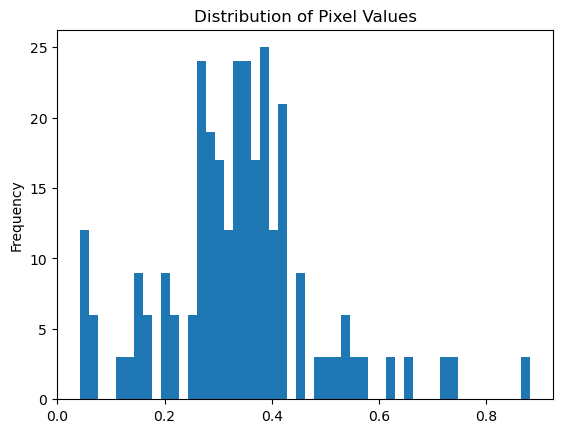

INCORRECTLY CLASSIFIED NORMAL MRI
Incorrectly classified scan number  49 . Pixel distribution plot.


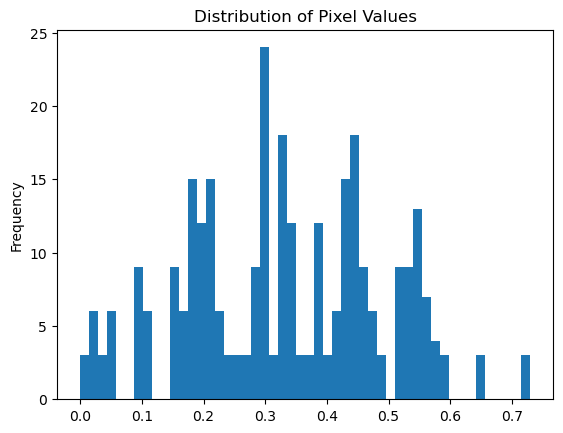

INCORRECTLY CLASSIFIED TUMOR MRI
Incorrectly classified scan number  53 . Pixel distribution plot.


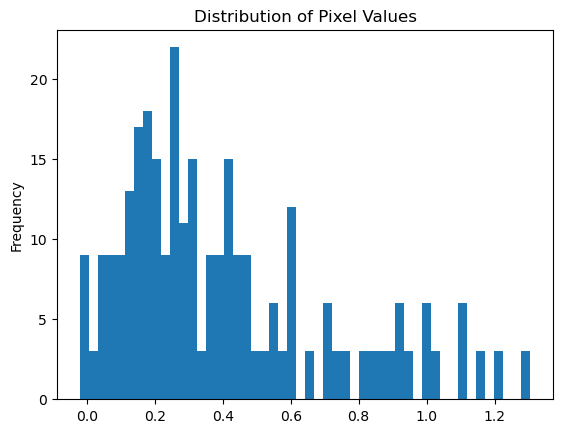

INCORRECTLY CLASSIFIED NORMAL MRI
Incorrectly classified scan number  63 . Pixel distribution plot.


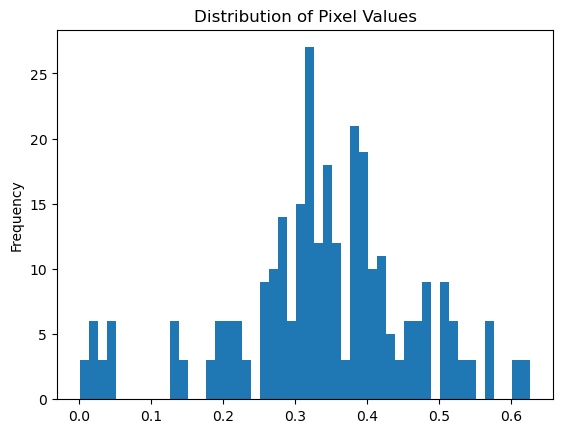

In [109]:
### Distribution plots for incorrectly classified NORMAL and TUMOR images
for i in incindex:
    if df_test_mm.iloc[i,1] == 0:
        print('INCORRECTLY CLASSIFIED NORMAL MRI')
        print('Incorrectly classified scan number ',i,'. Pixel distribution plot.')
        pd.Series(X_testmm[i].flatten()).plot(kind='hist', bins=50, title='Distribution of Pixel Values')
        plt.show()
    elif df_test_mm.iloc[i,1] == 1:
        print('INCORRECTLY CLASSIFIED TUMOR MRI')
        print('Incorrectly classified scan number ',i,'. Pixel distribution plot.')
        pd.Series(X_testmm[i].flatten()).plot(kind='hist', bins=50, title='Distribution of Pixel Values')
        plt.show()

#### Combining all the correctly classified TUMOR images and separately NORMAL images to get average pixel distribution for each

In [136]:
### Need to get 4 lists: correct_TUMOR, correct_NORMAL, incorrect_TUMOR, incorrect_NORMAL
lst_cn = []
lst_ct = []
lst_incn = []
lst_inct = []

## Explain this code!
for i in cindex:
    if df_test_mm.iloc[i,1] == 0:
        lst_cn.append(X_testmm[i].flatten().tolist())
    elif df_test_mm.iloc[i,1] == 1:
        lst_ct.append(X_testmm[i].flatten().tolist())
        
for i in incindex:
    if df_test_mm.iloc[i,1] == 0:
        lst_incn.append(X_testmm[i].flatten().tolist())
    elif df_test_mm.iloc[i,1] == 1:
        lst_inct.append(X_testmm[i].flatten().tolist())

In [137]:
### Inspect list shapes
for i in [lst_cn,lst_ct,lst_incn,lst_inct]:
    print(len(i))
### We can see that the lengths of the lists mathc the X_testmm confusion matrix data, therefore the code worked.

31
42
3
4


In [138]:
## lst_cn
## lst_incn

In [139]:
### The lists have 2 dimensions, we need to make it into 1
lst_cn = list(chain.from_iterable(lst_cn))
lst_ct = list(chain.from_iterable(lst_ct))
lst_incn = list(chain.from_iterable(lst_incn))
lst_inct = list(chain.from_iterable(lst_inct))

for i in [lst_cn,lst_ct,lst_incn,lst_inct]:
    print(len(i))

9300
12600
900
1200


### Plotting Average Pixel Distributions for Correctly and Incorrectly Classified Images of Both Groups: NORMAL and TUMOR Separately
Here I also check the kurtosis of the distribution. Positive and large kurtosis would indicate that there is a sharp contrast somewhere in the image. I hypothesize this is the case for correctly classified tumor images and incorrectly classified normal images. Correctly classififed tumor images would have a sharp contrast becasue of the presence of a white spot/light gray spot and incorrectly classified normal images would have a sharp contrast since they could have other features present (e.g. eyeballs). 

The smallest sample size is 900 (see cell above). When I plot anything that is larger I will sample 900 from that list as many times as the list lenght divided by 900. For example, lst_ct has 12600 points so I will sample it 12600/900, rounded to the integer, times.

#### Correctly Classified NORMAL

In [154]:
from scipy.stats import kurtosis
## https://www.scribbr.com/statistics/kurtosis/

0.05757995732449572


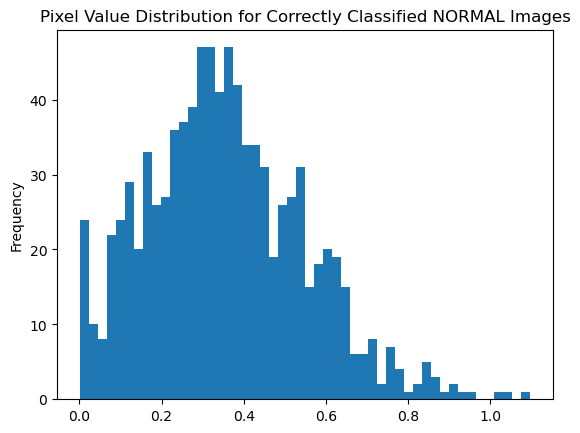

0.11638546251146664


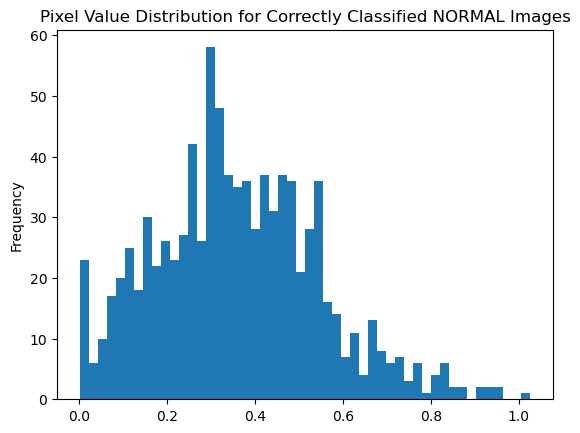

-0.16972142459049566


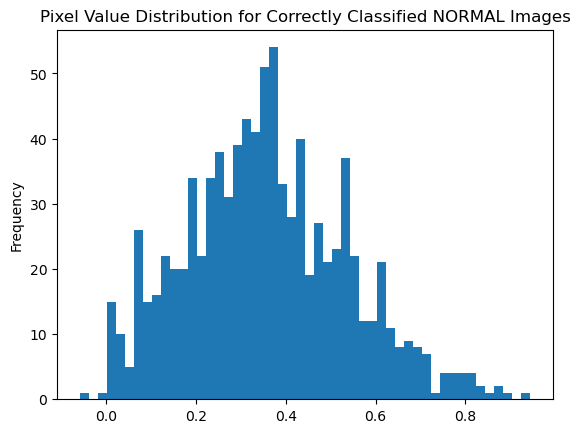

-0.199854073643281


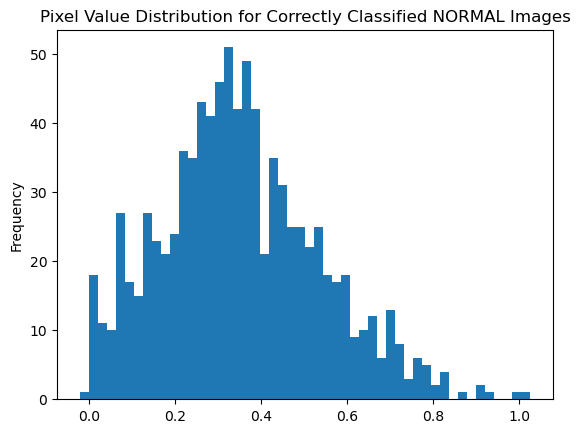

0.01322955314712626


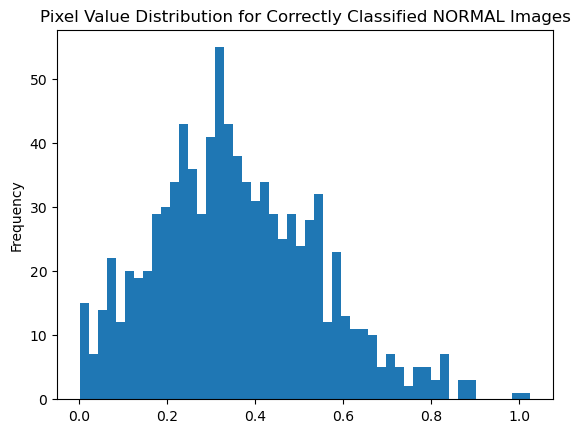

-0.018352055885151763


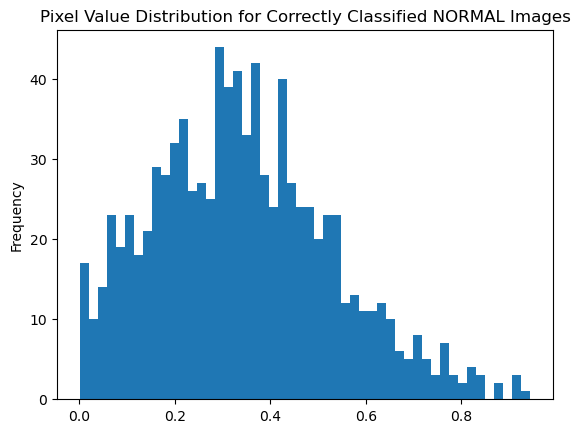

-0.1486773838364246


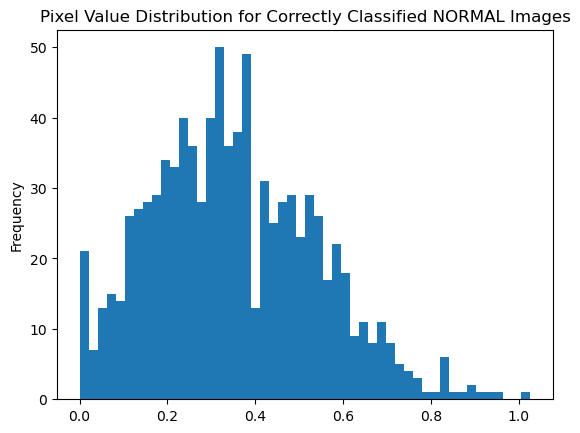

0.06450117003953215


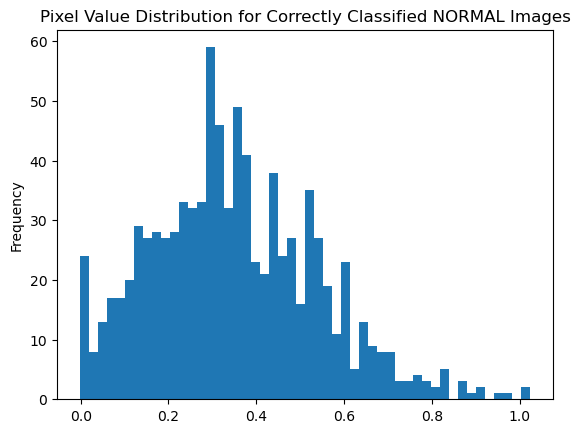

-0.11337879492222003


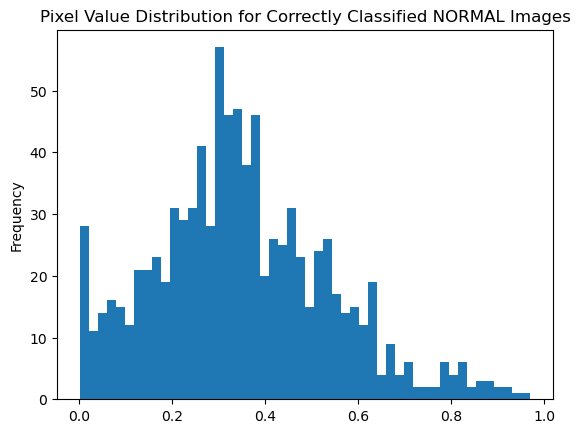

-0.08512628932996025


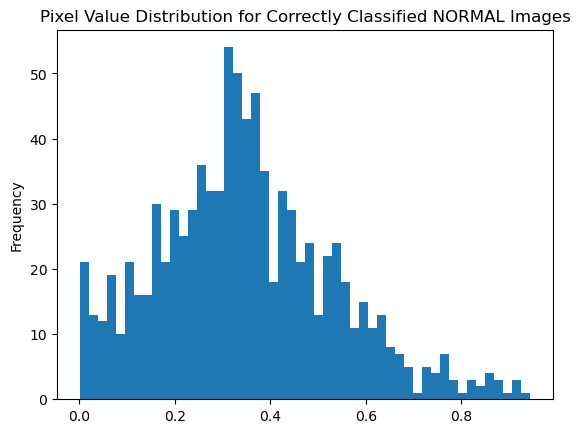

Average Fisher kurtosis:  0.08359627837474051


In [155]:
random.seed(42)
kurt = []
for i in range(10):
    print(kurtosis(random.sample(lst_cn,900), axis=0, fisher=True, bias=True))
    kurt.append(kurtosis(random.sample(lst_cn,900), axis=0, bias=True))
    pd.Series(random.sample(lst_cn,900)).plot(kind='hist', bins=50, 
                                              title='Pixel Value Distribution for Correctly Classified NORMAL Images')
    plt.show()

print('Average Fisher kurtosis: ',sum(kurt)/10)

#### Correctly Classified TUMOR

1.1369054218923793


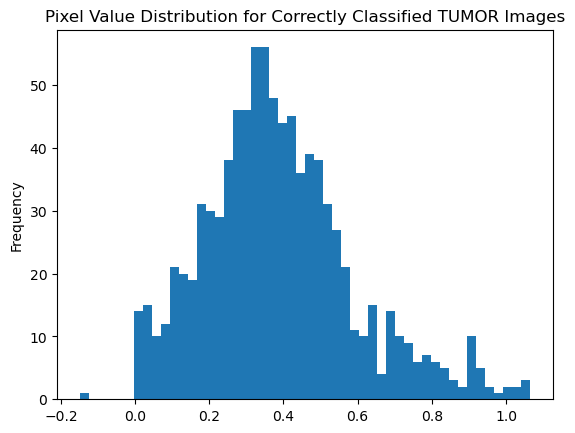

1.4174228026805649


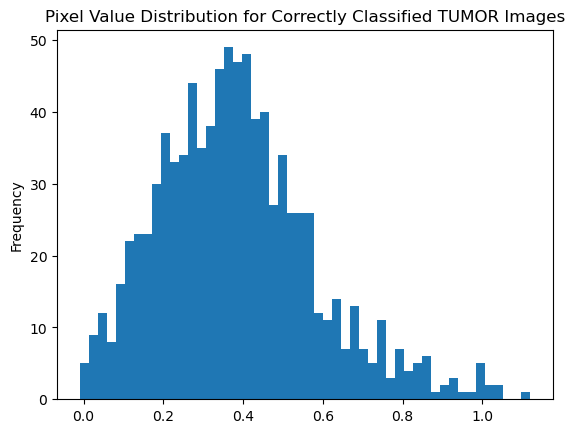

1.3896868546142649


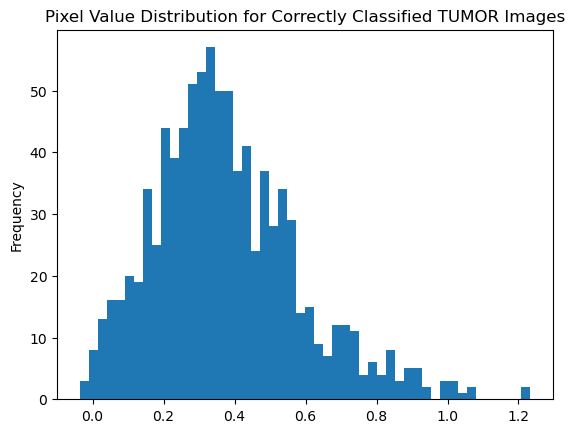

0.6694513710958567


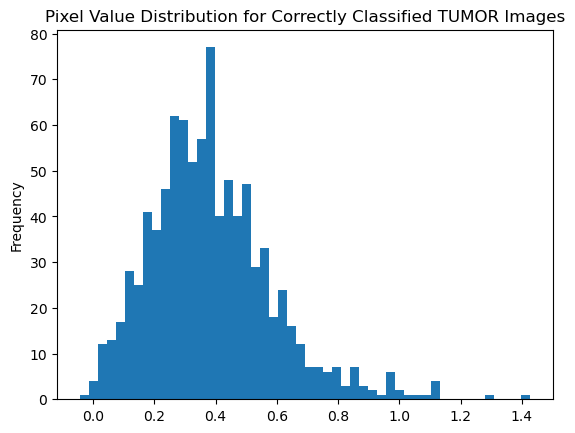

1.0420868887935475


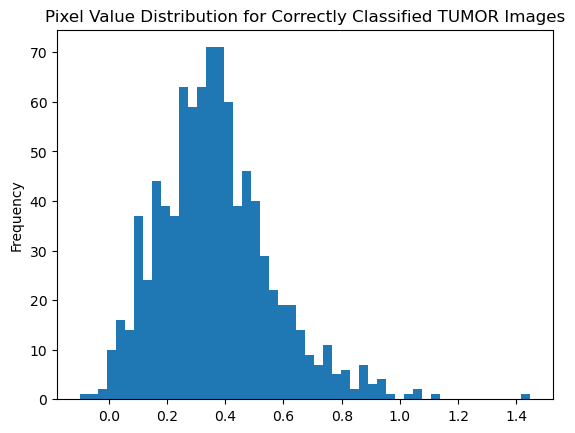

1.6890008406371804


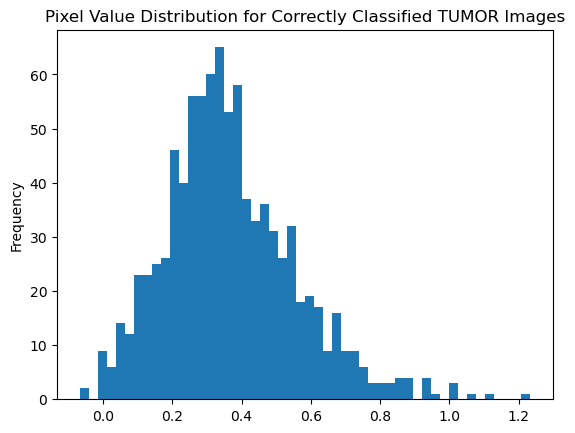

0.8656723512383317


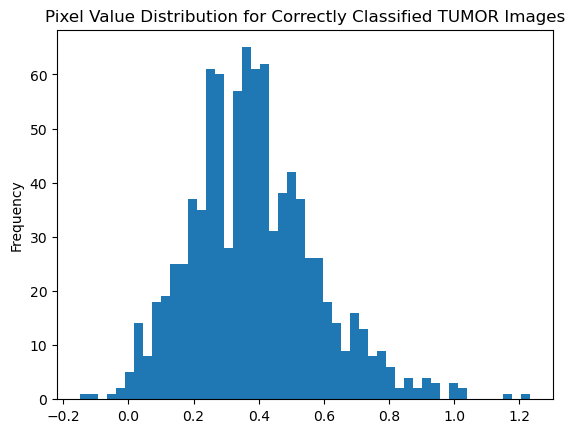

2.1188076558852584


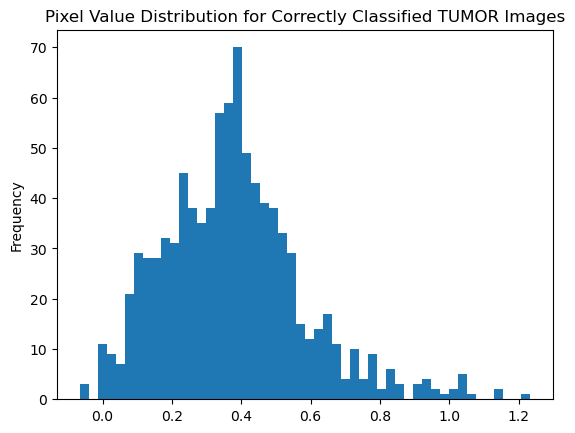

0.7700992922162011


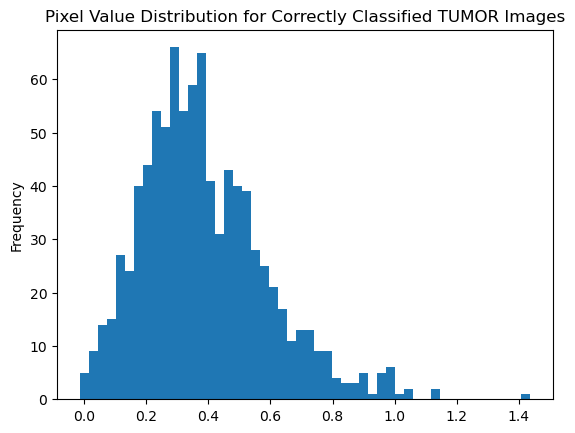

0.9206340502696979


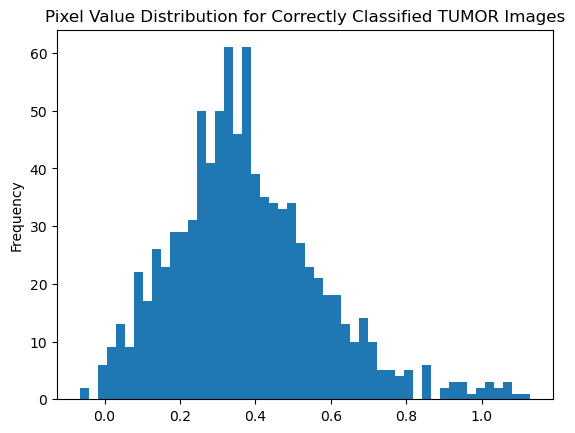

1.081701763731135


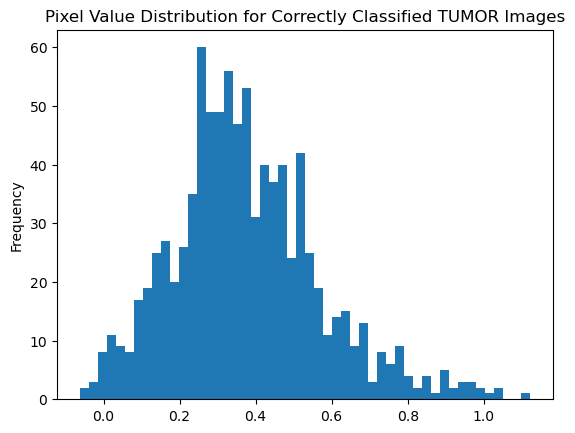

0.8848093622466129


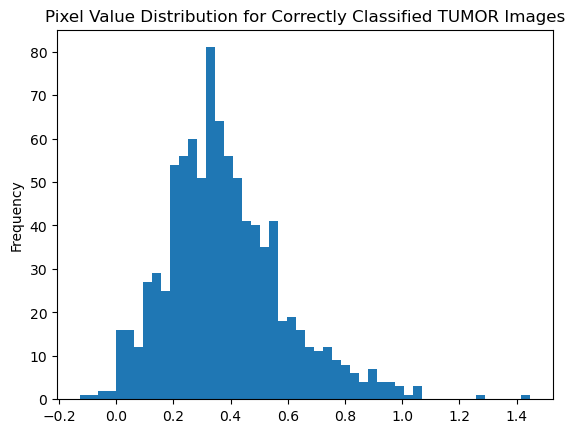

1.4108729945691776


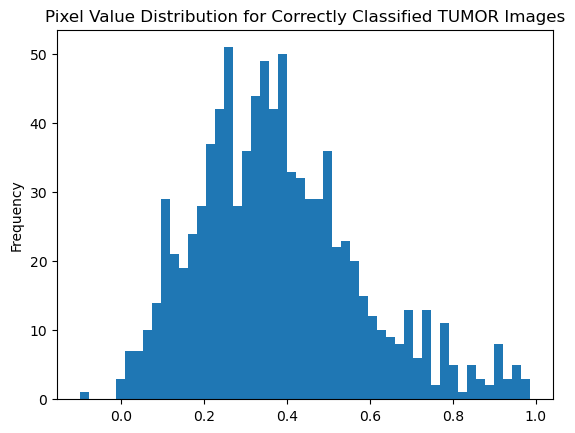

0.6063340948373885


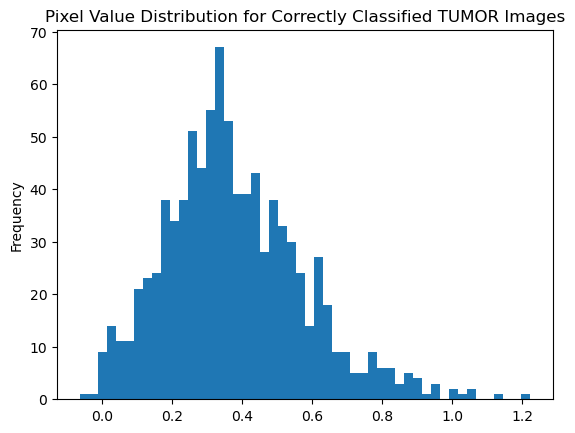

Average Fisher kurtosis:  0.8772295236870388


In [156]:
random.seed(42)
kurt = []
for i in range(14):
    print(kurtosis(random.sample(lst_ct,900), axis=0, fisher=True, bias=True))
    kurt.append(kurtosis(random.sample(lst_ct,900), axis=0, bias=True))
    pd.Series(random.sample(lst_ct,900)).plot(kind='hist', bins=50, 
                                              title='Pixel Value Distribution for Correctly Classified TUMOR Images')
    plt.show()

print('Average Fisher kurtosis: ',sum(kurt)/14)

#### Incorrectly Classified NORMAL

Fisher Kurtosis:  0.5103411388295291


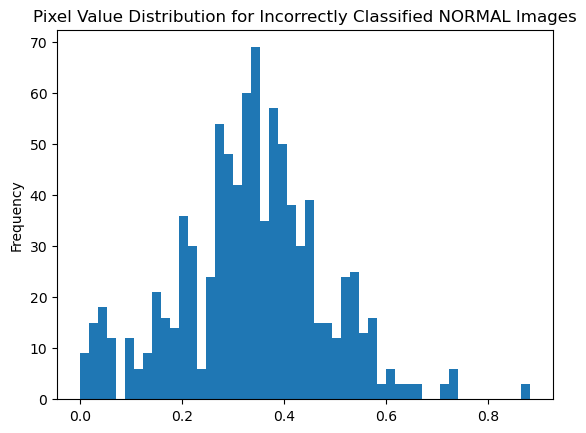

In [157]:
print('Fisher Kurtosis: ',kurtosis(lst_incn, axis=0, fisher=True, bias=True))
pd.Series(lst_incn).plot(kind='hist', bins=50, 
                                              title='Pixel Value Distribution for Incorrectly Classified NORMAL Images')
plt.show()

#### Incorrectly Classified TUMOR

2.7849153705380942


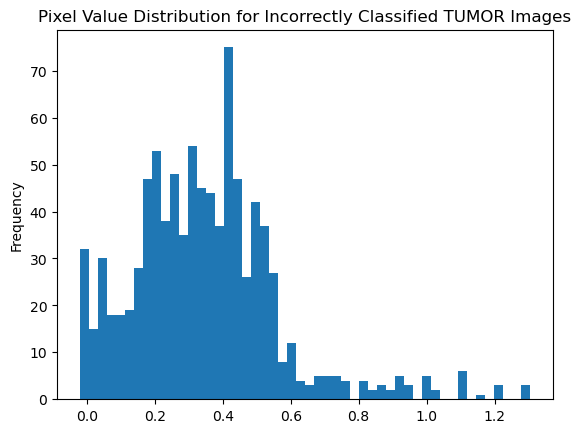

2.464951831645047


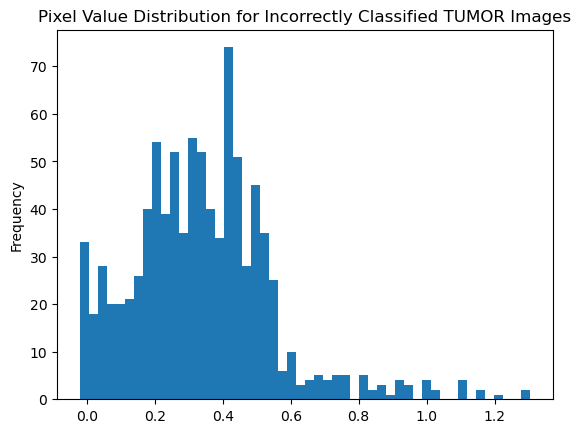

Average Fisher kurtosis:  2.4619807078746225


In [158]:
random.seed(42)
kurt = []
for i in range(2):
    print(kurtosis(random.sample(lst_inct,900), axis=0, fisher=True, bias=True))
    kurt.append(kurtosis(random.sample(lst_inct,900), axis=0, bias=True))
    pd.Series(random.sample(lst_inct,900)).plot(kind='hist', bins=50, 
                                              title='Pixel Value Distribution for Incorrectly Classified TUMOR Images')
    plt.show()

print('Average Fisher kurtosis: ',sum(kurt)/2)

### Discussion
1) The pixel distribution of the correctly classified normal had low kurtosis indicating either small white spots or low contrast areas.
2) The pixel distribution of the correctly classified tumor had higher kurtosis indicating either large white spots or high contrast areas.
3) The pixel distribution of the incorrectly classified normal had higher kurtosis than correctly classified normal indicating that highly contrasting regions are used to some degree in the model.
4) The pixel distribution of the incorrectly classified tumor had the highest kurtosis out of all.

Consider maximum values aswell...



### Investigating INCORRECTLY Classified Images from Test Data

INCORRECTLY CLASSIFIED TUMOR MRI


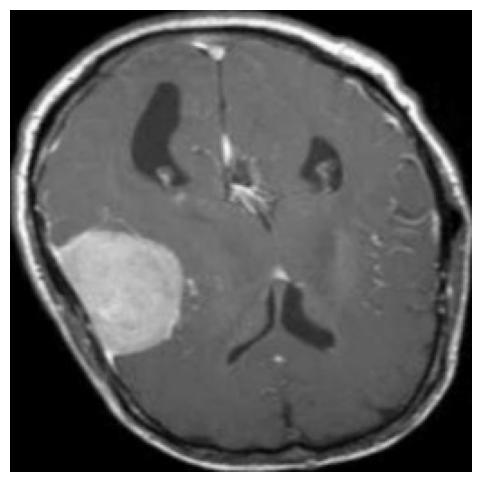

INCORRECTLY CLASSIFIED TUMOR MRI


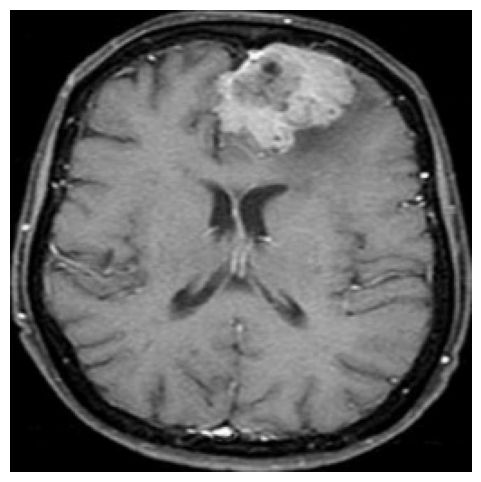

INCORRECTLY CLASSIFIED TUMOR MRI


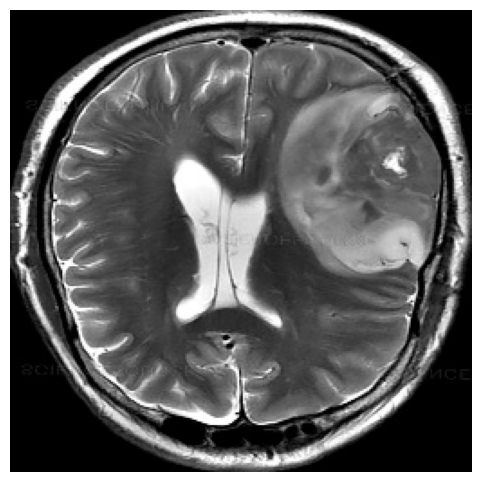

INCORRECTLY CLASSIFIED NORMAL MRI


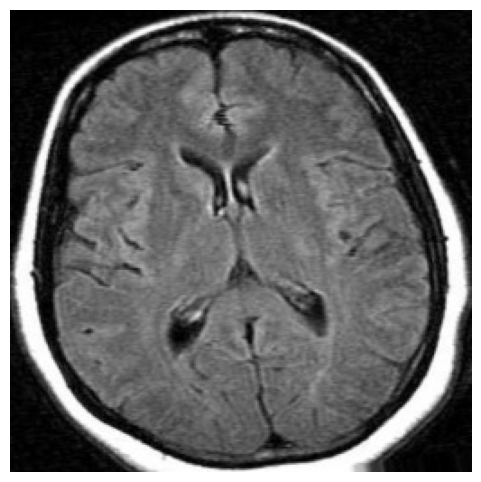

INCORRECTLY CLASSIFIED NORMAL MRI


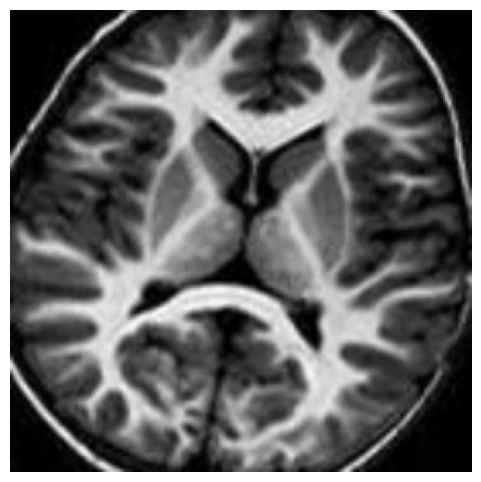

INCORRECTLY CLASSIFIED TUMOR MRI


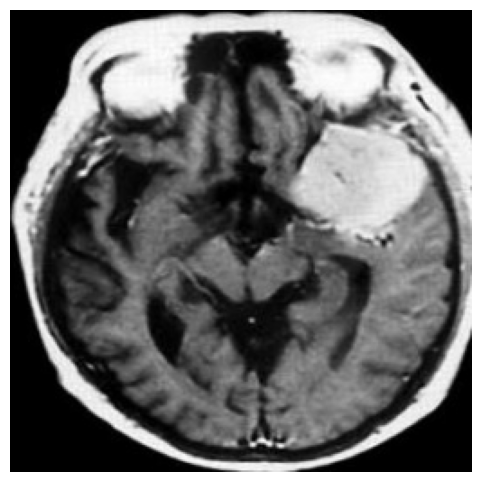

INCORRECTLY CLASSIFIED NORMAL MRI


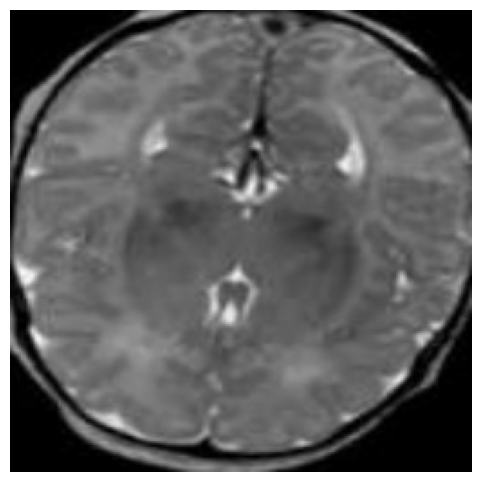

In [128]:
for i in incindex:
    if df_test_mm.iloc[i,1] == 0:
        print('INCORRECTLY CLASSIFIED NORMAL MRI')
        fig, ax = plt.subplots(figsize=(6,6))
        ax.imshow(X_test_nr[i])
        ax.axis('off')
        plt.show()
    
    elif df_test_mm.iloc[i,1] == 1:
        print('INCORRECTLY CLASSIFIED TUMOR MRI')
        fig, ax = plt.subplots(figsize=(6,6))
        ax.imshow(X_test_nr[i])
        ax.axis('off')
        plt.show()

### Investigating CORRECTLY Classified Images from Test Data

CORRECTLY CLASSIFIED NORMAL MRI


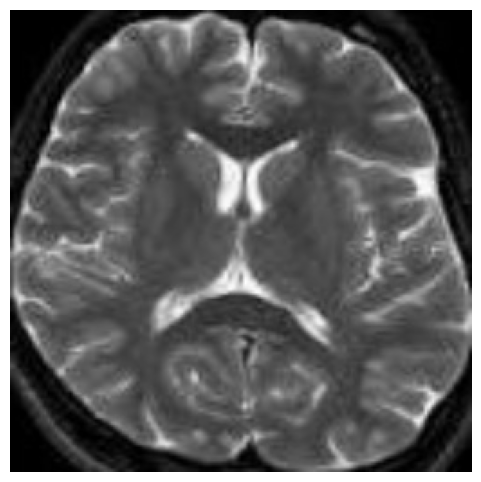

CORRECTLY CLASSIFIED TUMOR MRI


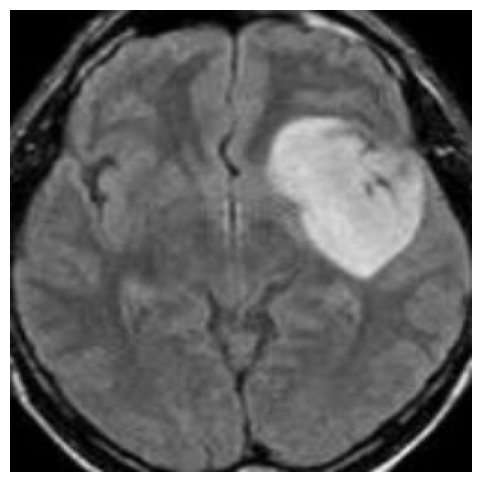

CORRECTLY CLASSIFIED NORMAL MRI


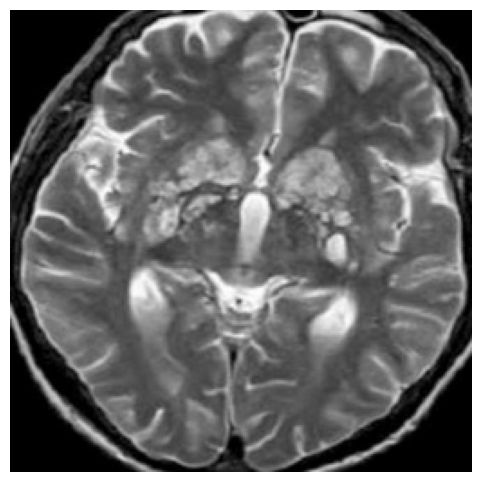

CORRECTLY CLASSIFIED TUMOR MRI


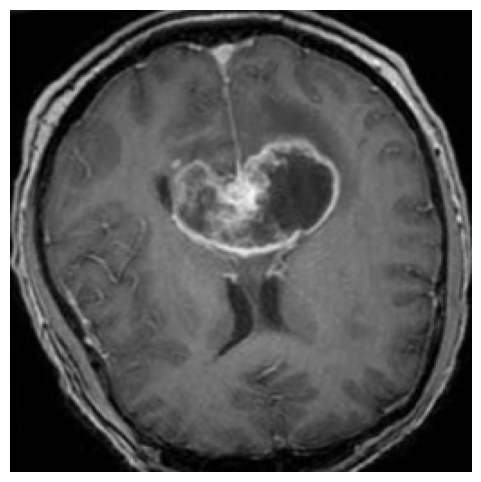

CORRECTLY CLASSIFIED TUMOR MRI


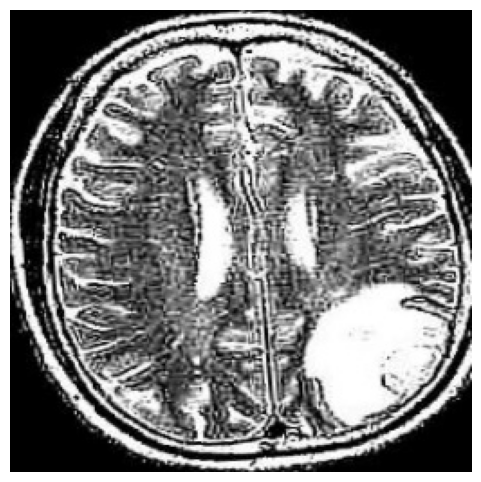

CORRECTLY CLASSIFIED NORMAL MRI


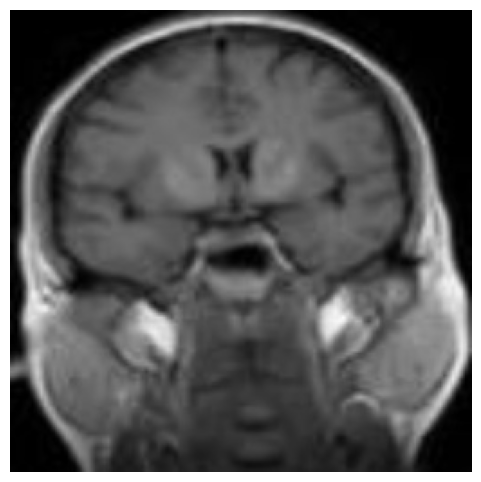

CORRECTLY CLASSIFIED TUMOR MRI


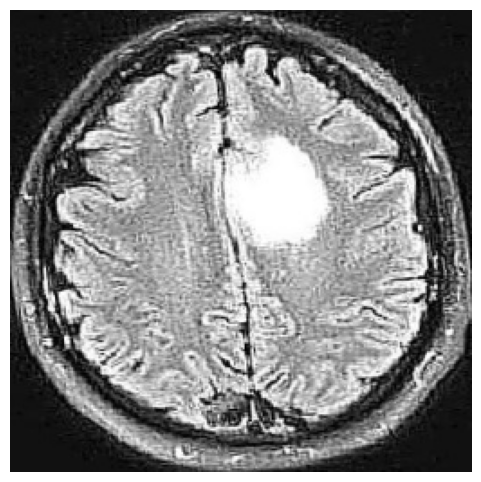

CORRECTLY CLASSIFIED TUMOR MRI


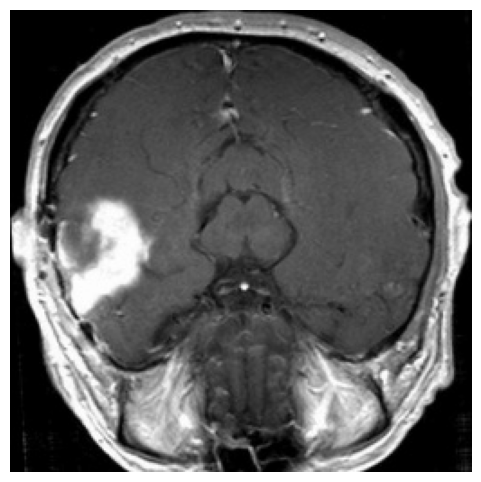

CORRECTLY CLASSIFIED TUMOR MRI


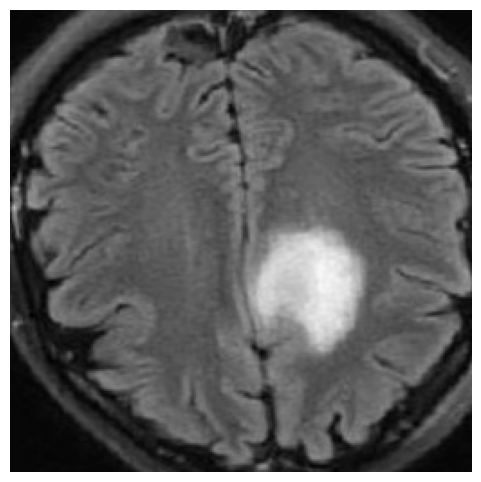

CORRECTLY CLASSIFIED TUMOR MRI


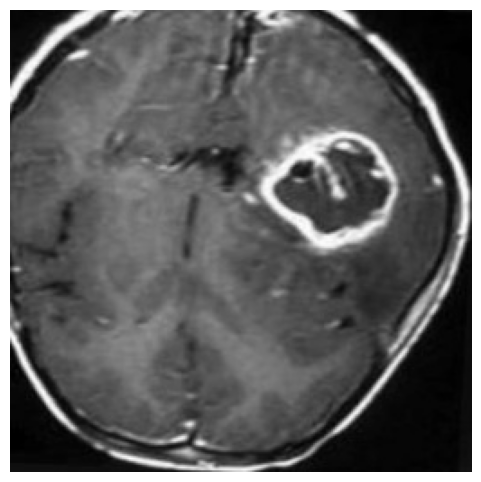

CORRECTLY CLASSIFIED TUMOR MRI


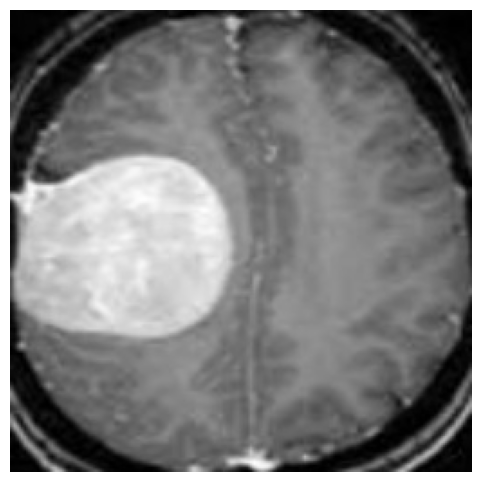

CORRECTLY CLASSIFIED TUMOR MRI


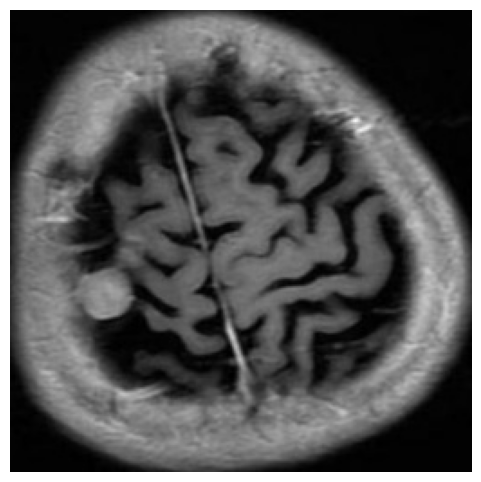

CORRECTLY CLASSIFIED TUMOR MRI


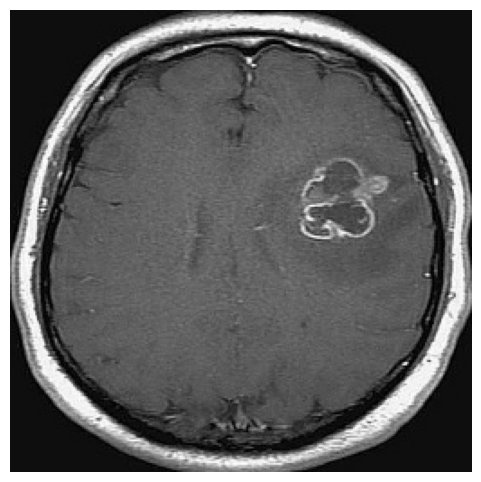

CORRECTLY CLASSIFIED NORMAL MRI


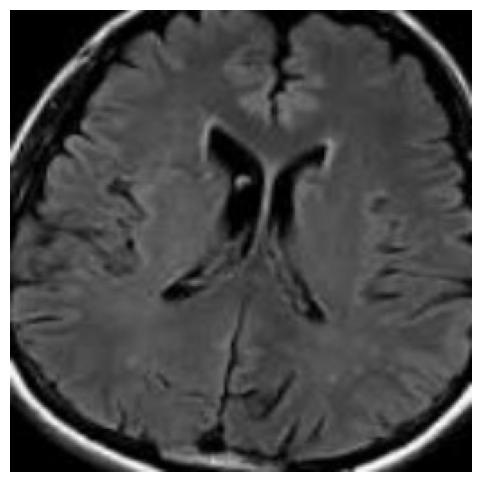

CORRECTLY CLASSIFIED TUMOR MRI


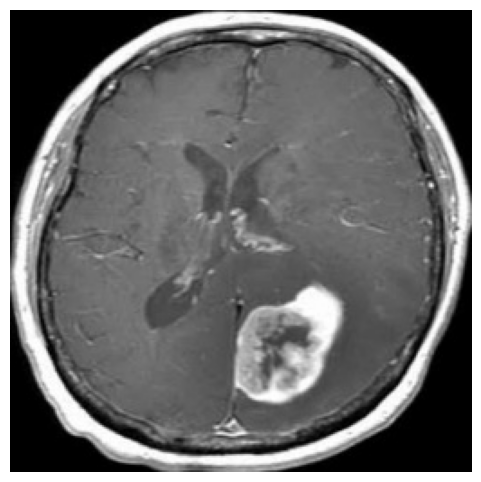

CORRECTLY CLASSIFIED TUMOR MRI


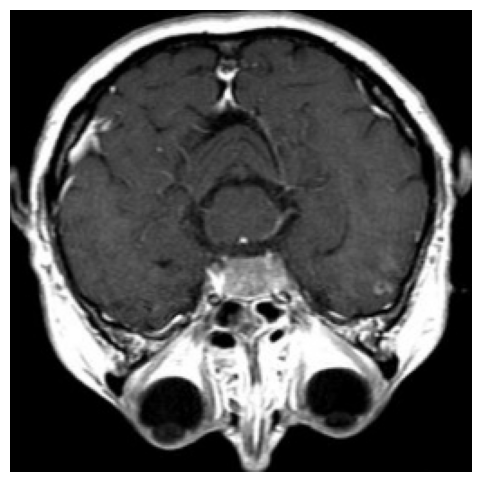

CORRECTLY CLASSIFIED TUMOR MRI


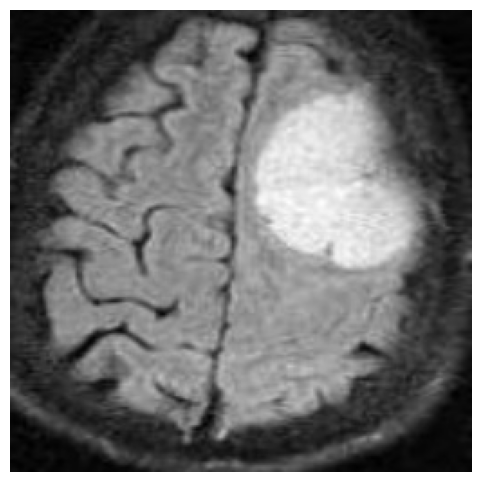

CORRECTLY CLASSIFIED NORMAL MRI


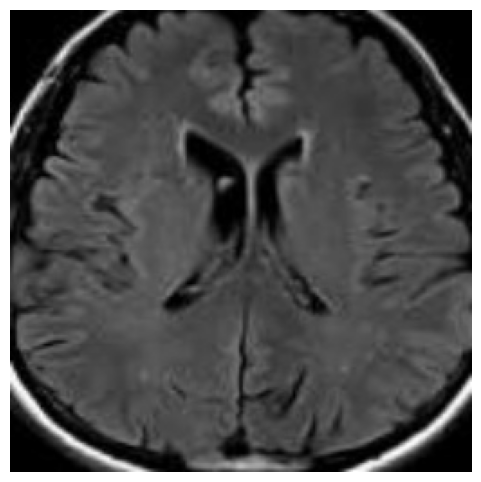

CORRECTLY CLASSIFIED NORMAL MRI


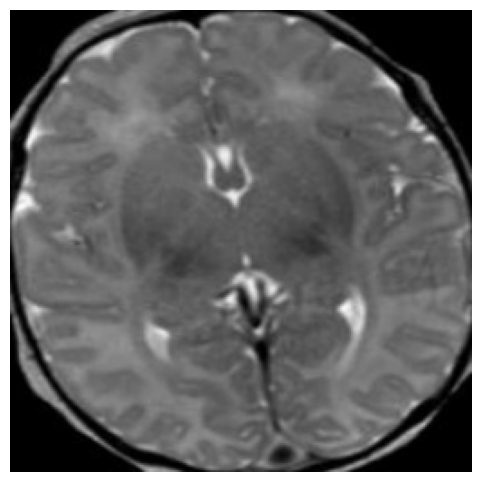

CORRECTLY CLASSIFIED TUMOR MRI


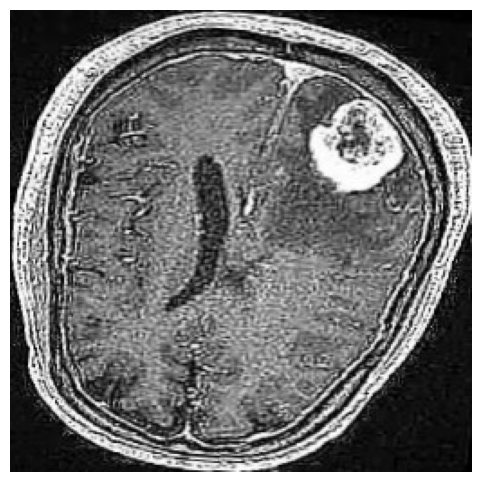

CORRECTLY CLASSIFIED NORMAL MRI


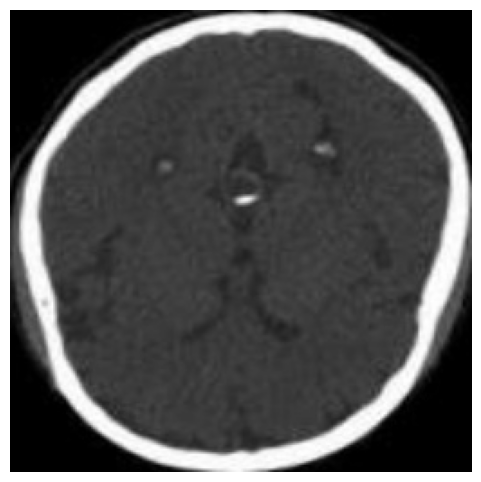

CORRECTLY CLASSIFIED TUMOR MRI


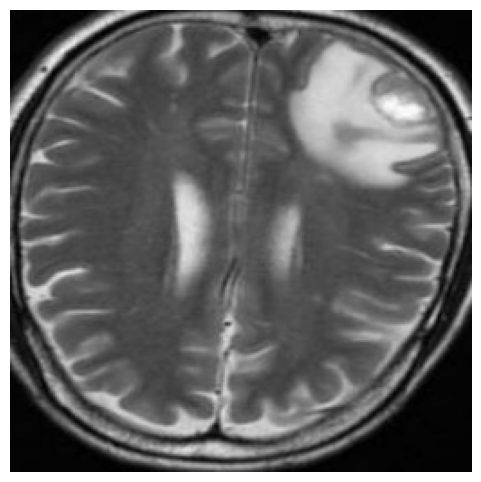

CORRECTLY CLASSIFIED NORMAL MRI


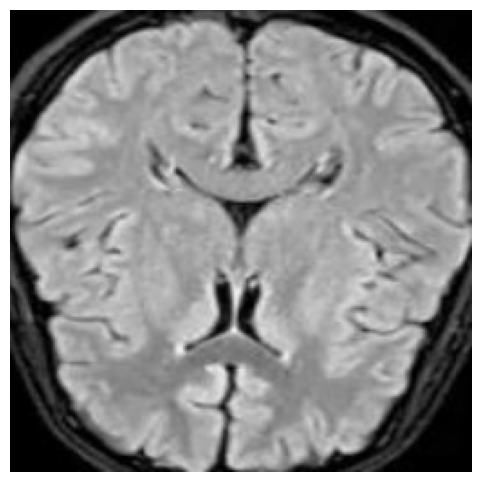

CORRECTLY CLASSIFIED NORMAL MRI


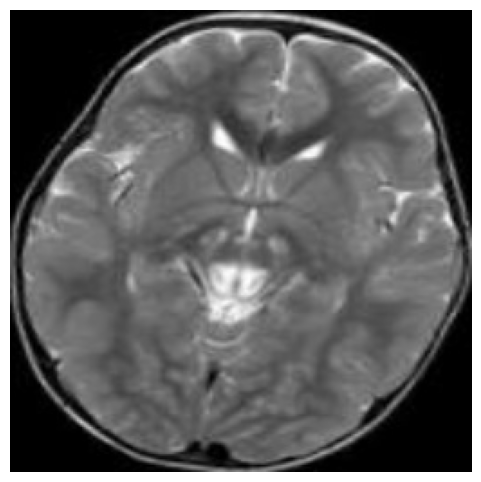

CORRECTLY CLASSIFIED TUMOR MRI


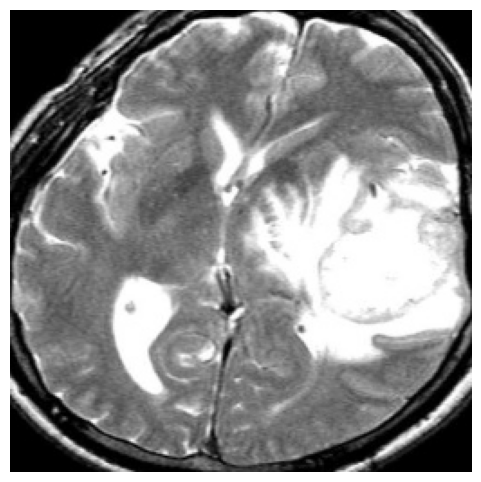

CORRECTLY CLASSIFIED NORMAL MRI


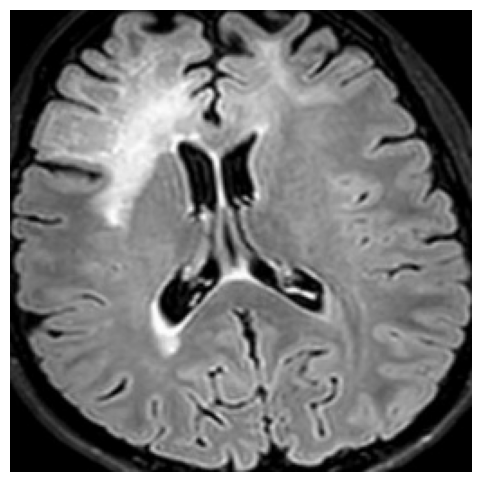

CORRECTLY CLASSIFIED TUMOR MRI


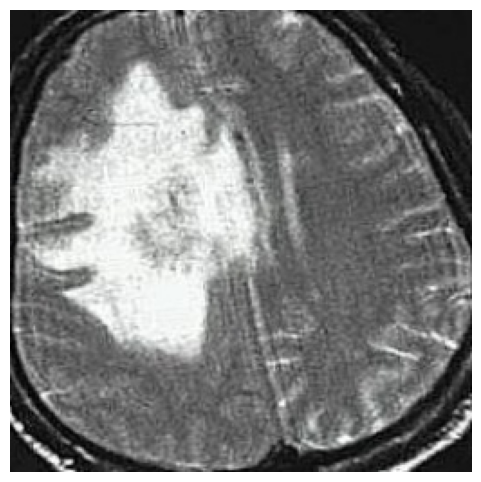

CORRECTLY CLASSIFIED TUMOR MRI


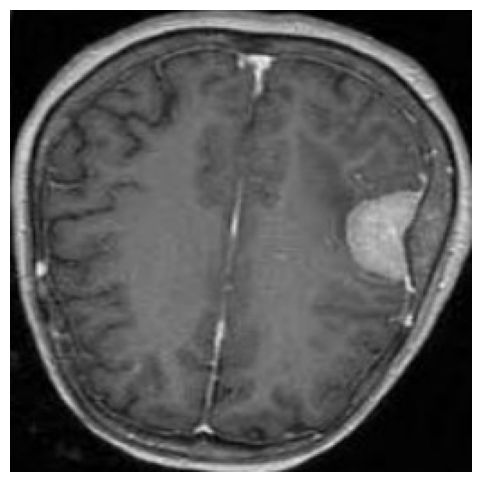

CORRECTLY CLASSIFIED TUMOR MRI


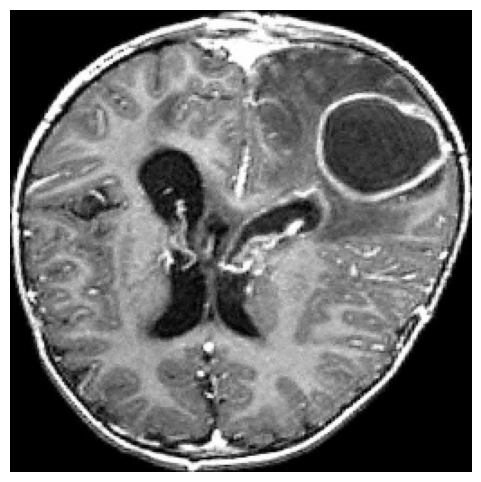

CORRECTLY CLASSIFIED TUMOR MRI


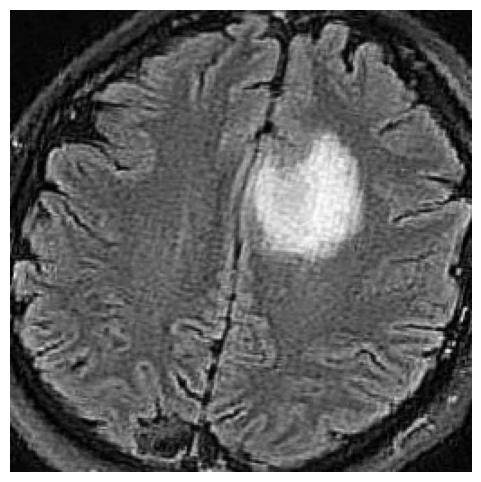

CORRECTLY CLASSIFIED TUMOR MRI


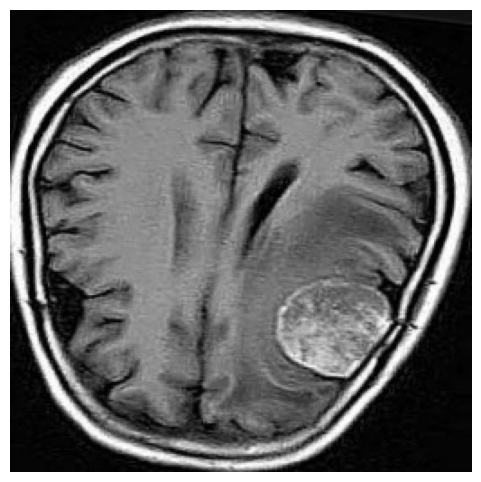

CORRECTLY CLASSIFIED NORMAL MRI


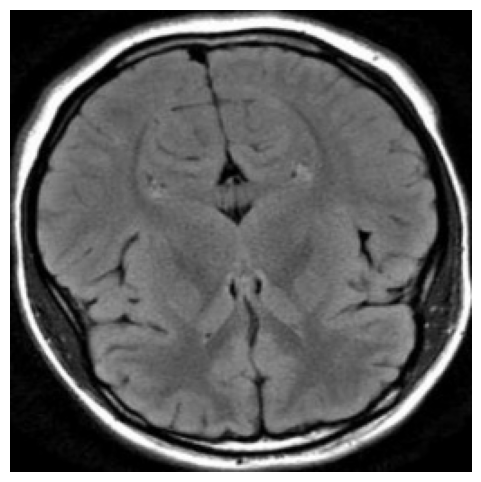

CORRECTLY CLASSIFIED TUMOR MRI


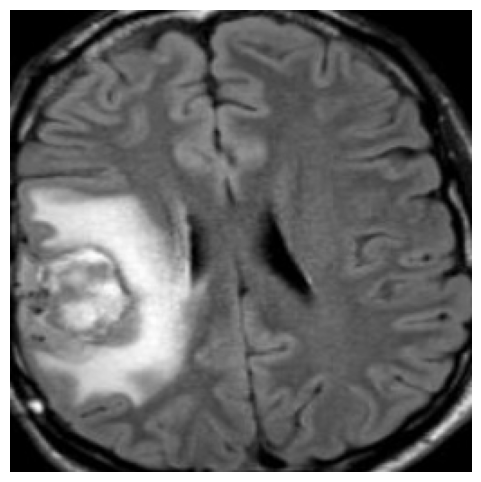

CORRECTLY CLASSIFIED TUMOR MRI


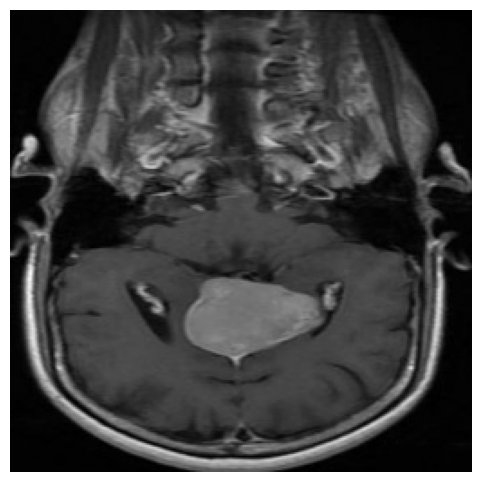

CORRECTLY CLASSIFIED NORMAL MRI


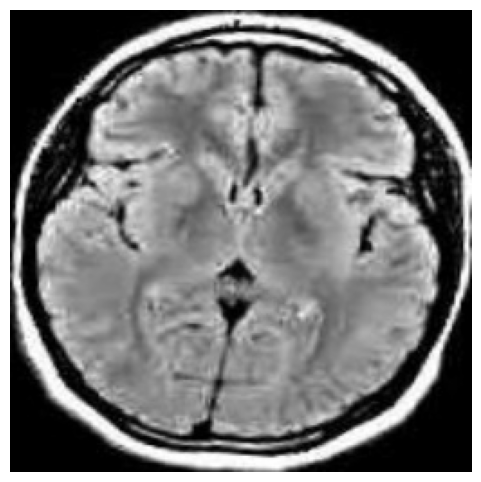

CORRECTLY CLASSIFIED NORMAL MRI


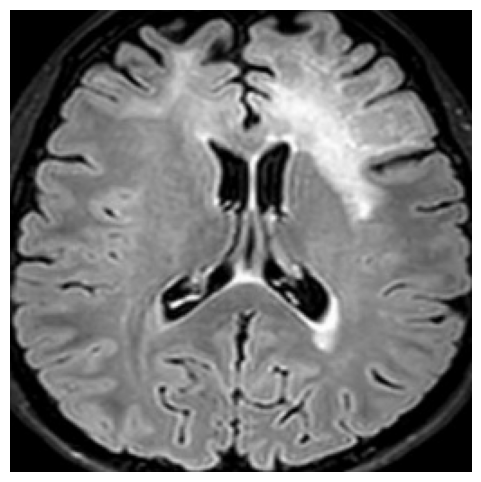

CORRECTLY CLASSIFIED TUMOR MRI


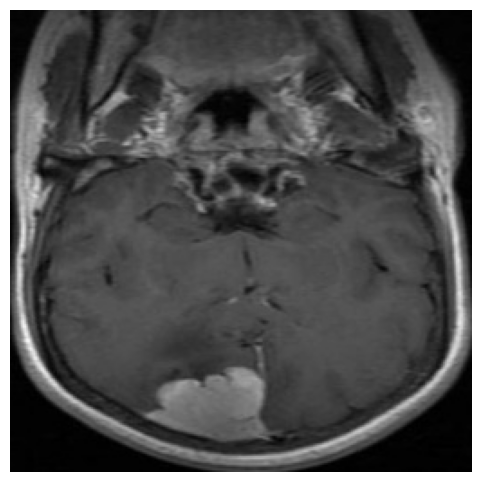

CORRECTLY CLASSIFIED TUMOR MRI


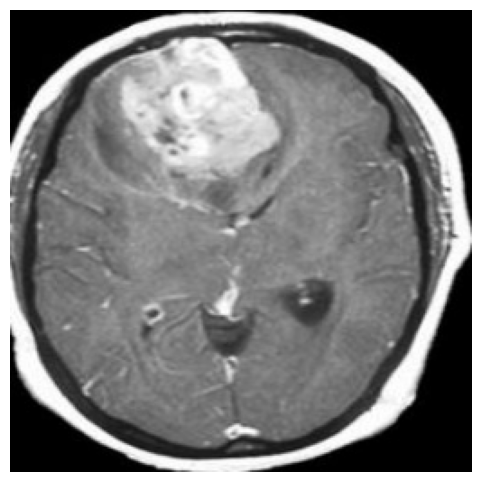

CORRECTLY CLASSIFIED NORMAL MRI


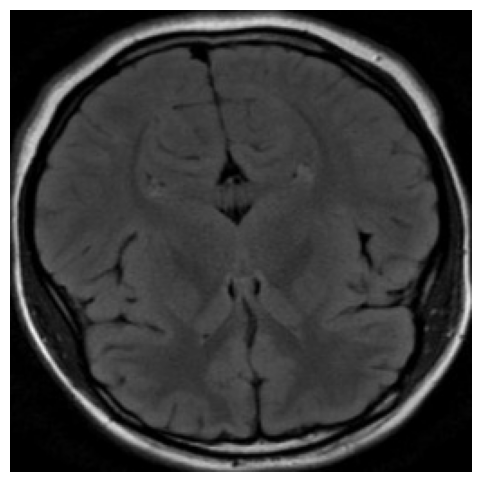

CORRECTLY CLASSIFIED NORMAL MRI


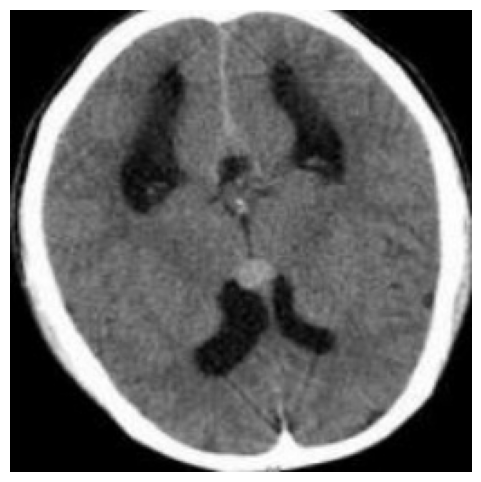

CORRECTLY CLASSIFIED TUMOR MRI


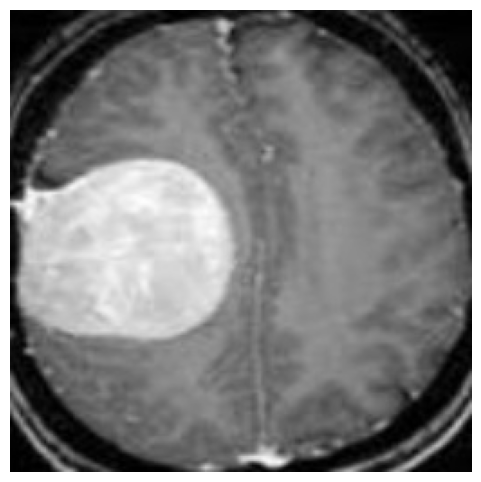

CORRECTLY CLASSIFIED NORMAL MRI


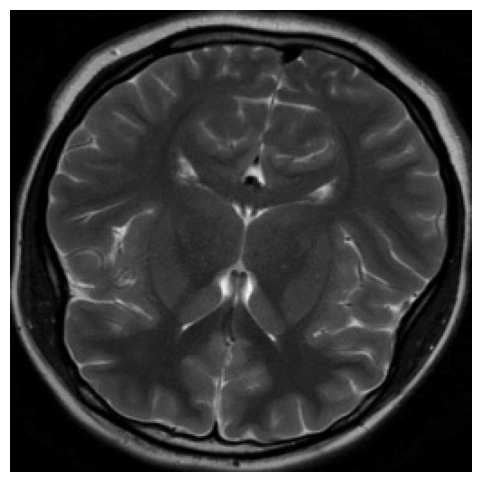

CORRECTLY CLASSIFIED NORMAL MRI


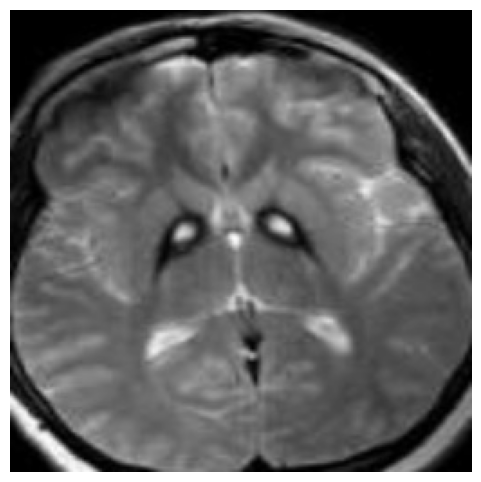

CORRECTLY CLASSIFIED TUMOR MRI


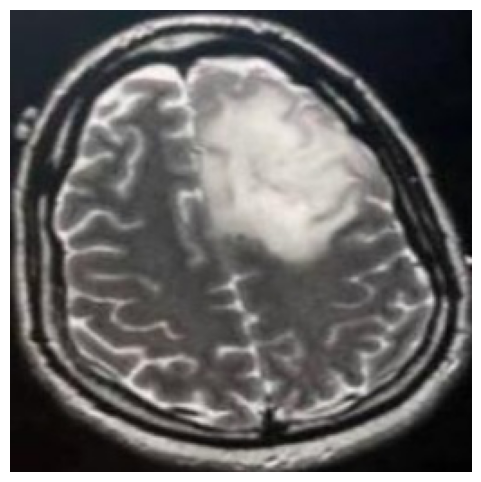

CORRECTLY CLASSIFIED TUMOR MRI


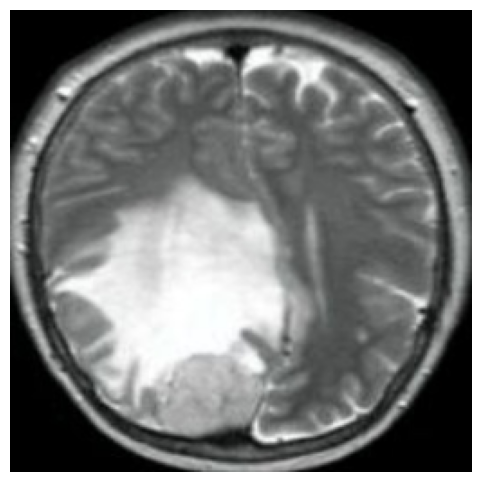

CORRECTLY CLASSIFIED TUMOR MRI


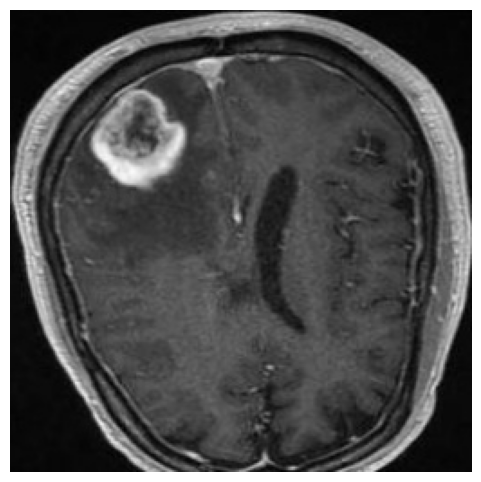

CORRECTLY CLASSIFIED NORMAL MRI


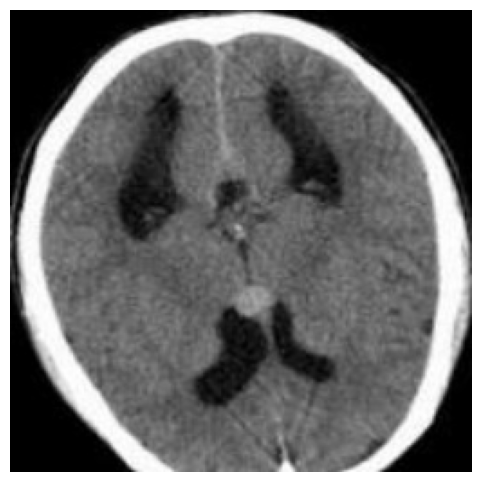

CORRECTLY CLASSIFIED TUMOR MRI


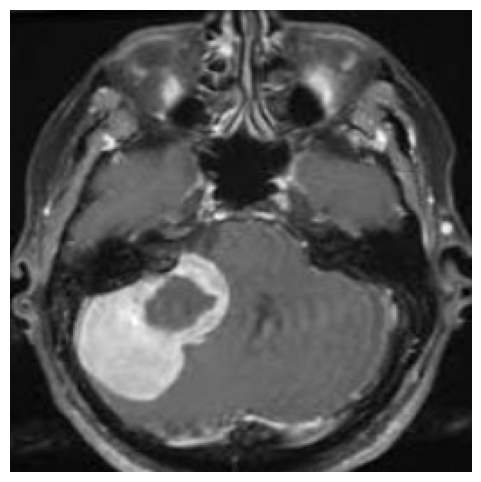

CORRECTLY CLASSIFIED TUMOR MRI


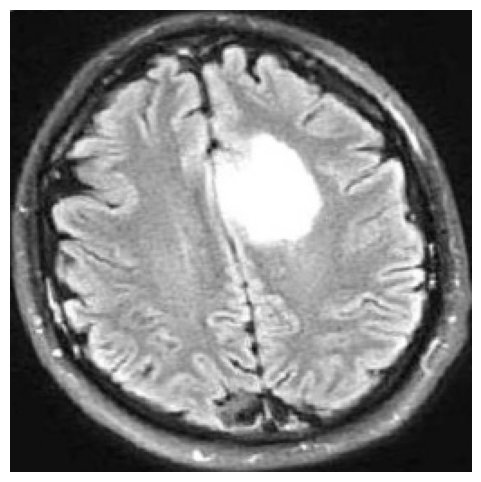

CORRECTLY CLASSIFIED NORMAL MRI


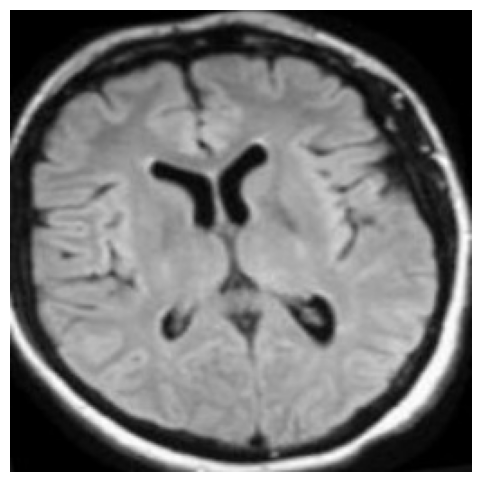

CORRECTLY CLASSIFIED TUMOR MRI


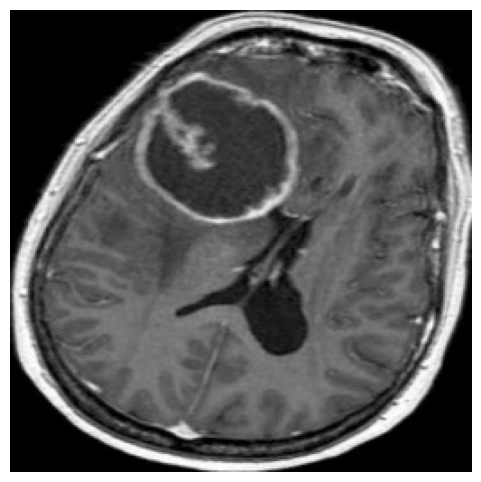

CORRECTLY CLASSIFIED NORMAL MRI


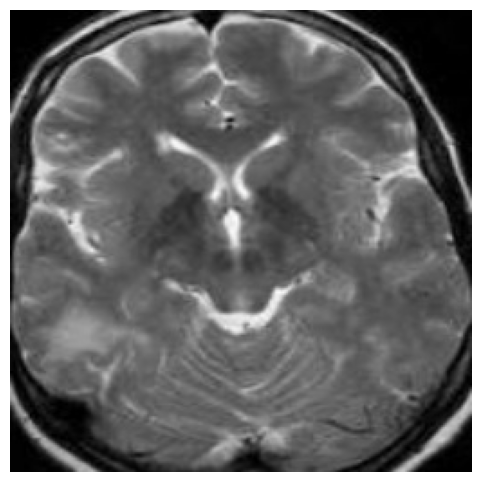

CORRECTLY CLASSIFIED TUMOR MRI


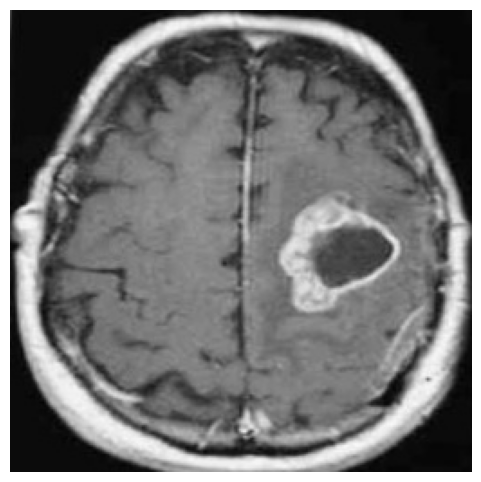

CORRECTLY CLASSIFIED TUMOR MRI


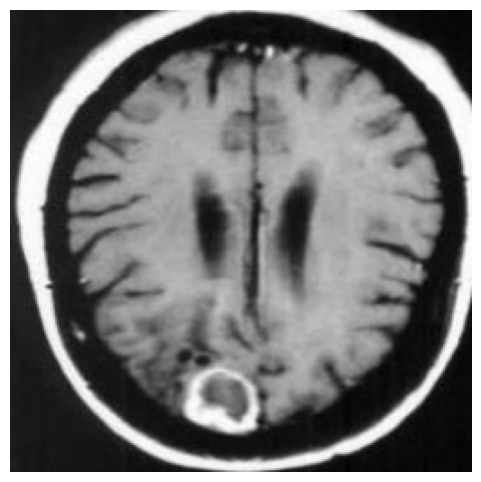

CORRECTLY CLASSIFIED NORMAL MRI


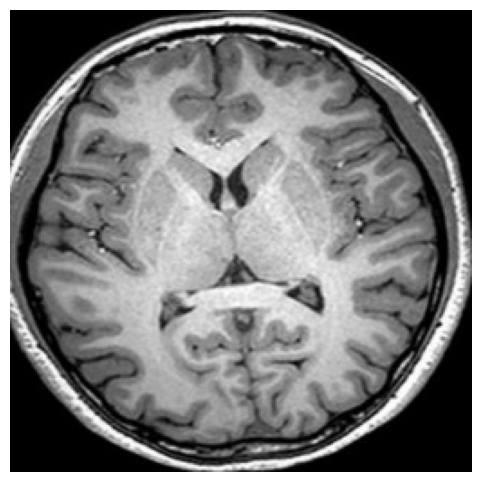

CORRECTLY CLASSIFIED TUMOR MRI


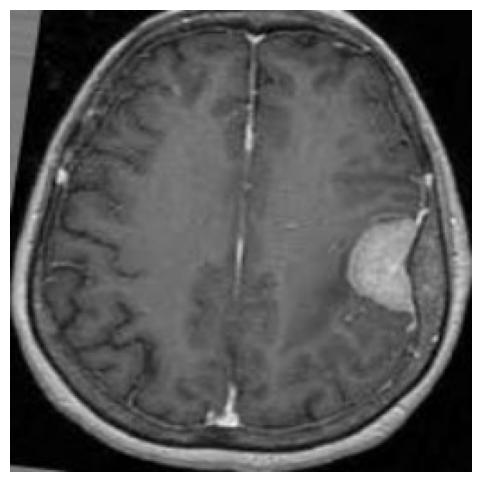

CORRECTLY CLASSIFIED NORMAL MRI


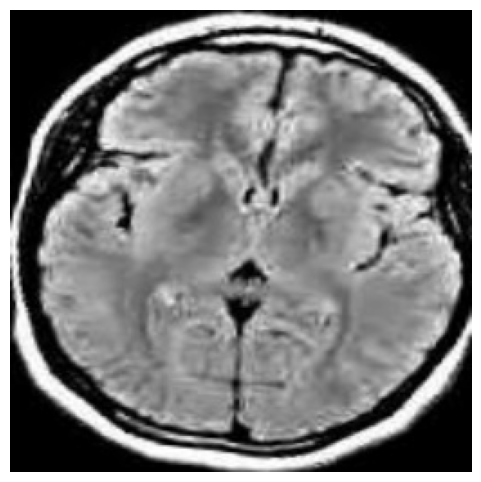

CORRECTLY CLASSIFIED NORMAL MRI


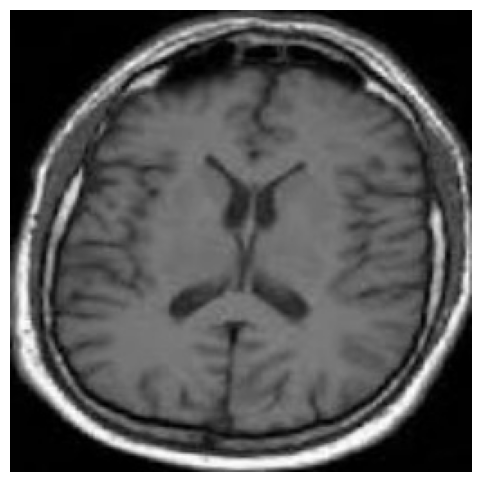

CORRECTLY CLASSIFIED TUMOR MRI


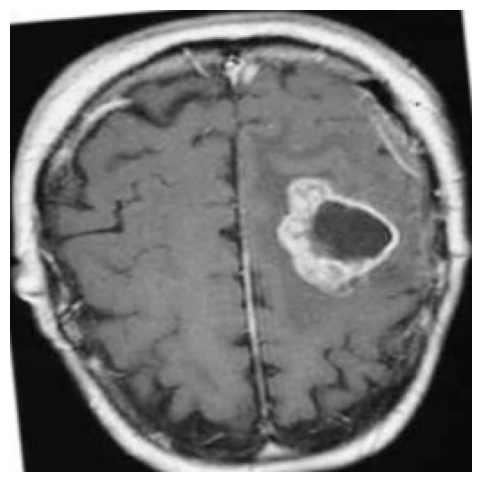

CORRECTLY CLASSIFIED NORMAL MRI


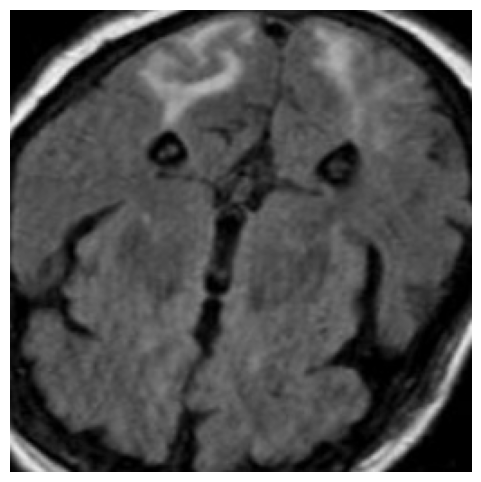

CORRECTLY CLASSIFIED NORMAL MRI


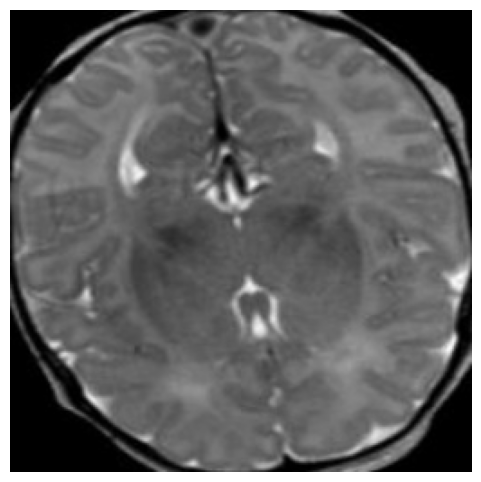

CORRECTLY CLASSIFIED TUMOR MRI


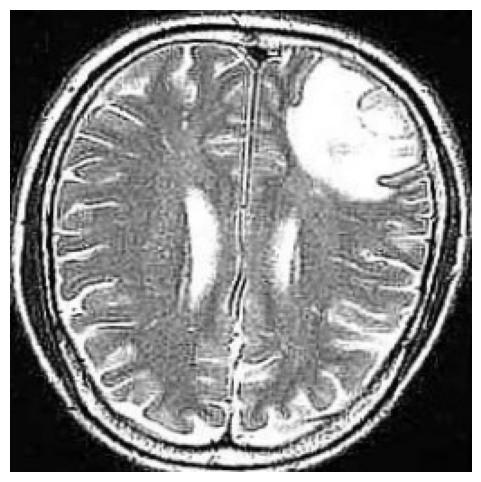

CORRECTLY CLASSIFIED TUMOR MRI


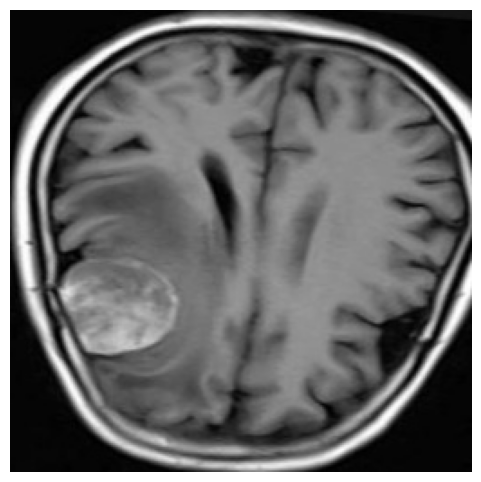

CORRECTLY CLASSIFIED NORMAL MRI


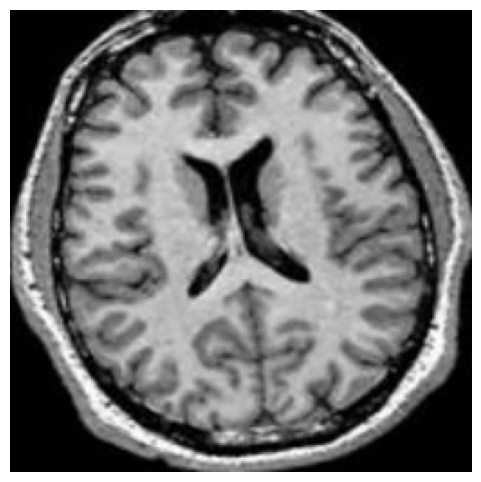

CORRECTLY CLASSIFIED TUMOR MRI


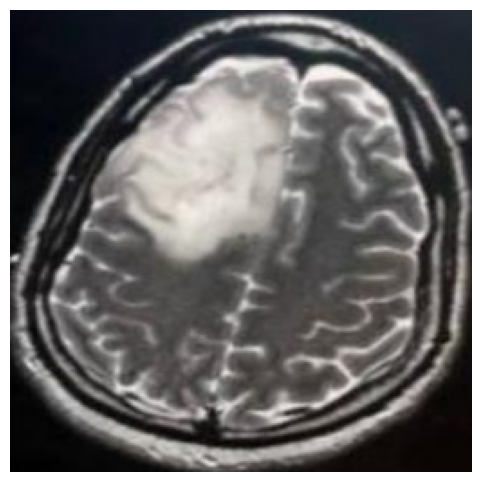

CORRECTLY CLASSIFIED TUMOR MRI


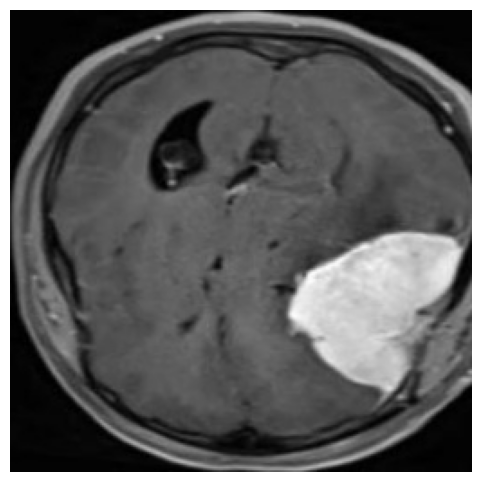

CORRECTLY CLASSIFIED NORMAL MRI


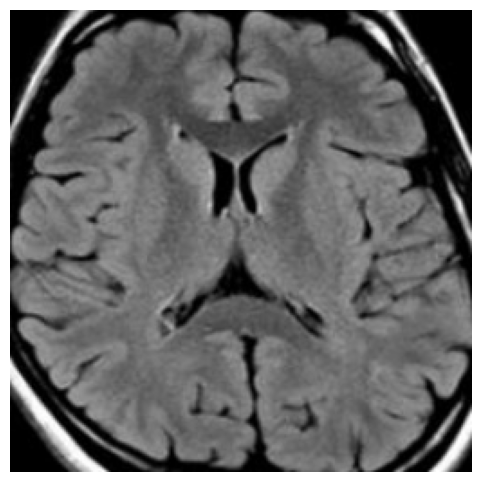

CORRECTLY CLASSIFIED NORMAL MRI


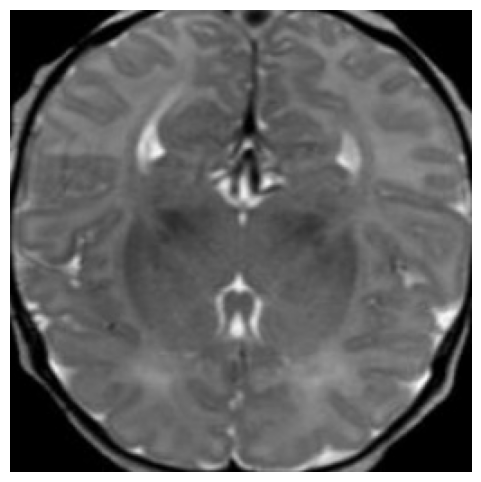

CORRECTLY CLASSIFIED TUMOR MRI


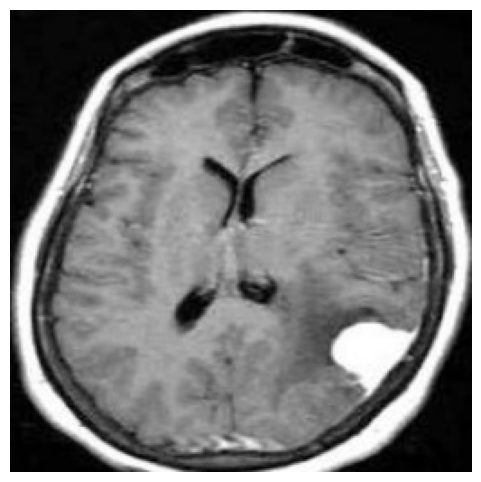

CORRECTLY CLASSIFIED NORMAL MRI


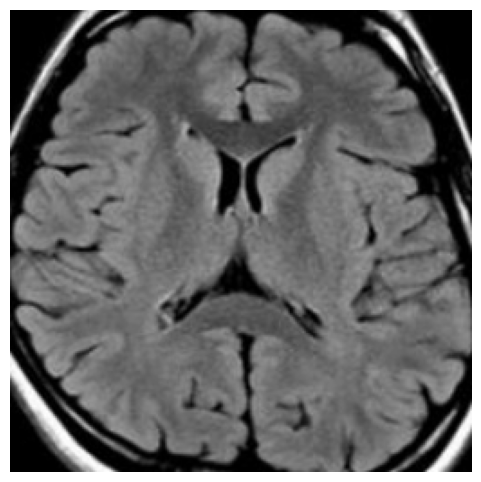

CORRECTLY CLASSIFIED TUMOR MRI


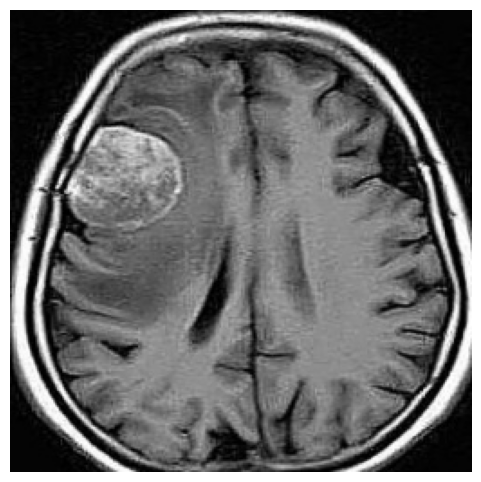

CORRECTLY CLASSIFIED NORMAL MRI


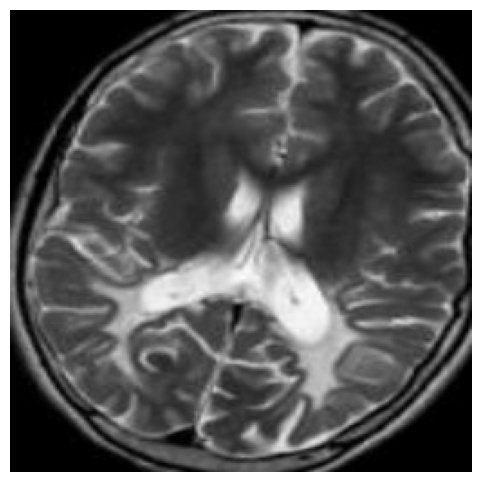

CORRECTLY CLASSIFIED NORMAL MRI


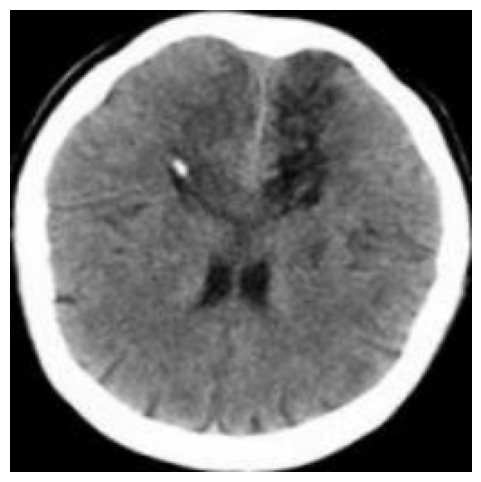

In [130]:
for i in cindex:
    if df_test_mm.iloc[i,1] == 0:
        print('CORRECTLY CLASSIFIED NORMAL MRI')
        fig, ax = plt.subplots(figsize=(6,6))
        ax.imshow(X_test_nr[i])
        ax.axis('off')
        plt.show()
    
    elif df_test_mm.iloc[i,1] == 1:
        print('CORRECTLY CLASSIFIED TUMOR MRI')
        fig, ax = plt.subplots(figsize=(6,6))
        ax.imshow(X_test_nr[i])
        ax.axis('off')
        plt.show()

### Discussion
Firstly, the previous notion of different plane of image affecting the classification of results is arguably not true. None of the misclassified images are in the coronal plane. The images of the test data that were correctly classified are in both transverse and coronal planes. 
Secondly, if you go further down the transverse plane or simply have coronal plane images you start seeing other struvtures that also appear as white spots. Inuitively, I proposed that this could misguide the classifier. A good case for this point cannot be made as there are many correctly classified images that present the deeper slices of the transverse plane and coronal images.

However, one contradiction to the latter point can be seen in the misclassified images (second to last) where it seems that the "tumor has posed as one of the eyeballs". The fact that the location of the tumor does not matter almost all the time is a good thing in practice becasue not all tumors appear in the areas of the brain where the tumor itself is clearly visible.

The only visible aspect that could partly misguide the classifier is the contrast of tumor to normal brain matter. In MOST cases of the correctly classified images, the tumor itself or the outline of the tumor is at high contrast compared to the surrounding matter. 

### Transparency of neural networks:
#### 1) https://www.sciencedirect.com/science/article/pii/S0010482521009057 
#### 2) https://scikit-learn.org/stable/auto_examples/neural_networks/plot_mnist_filters.html

#### Plotting the Node Weights between the first and second layer (resource 2)
Firstly, as the second resource mentions the more training iterations you have the more homogenous these weight maps become. Although as we can see in figure X below, some of the images are somewhat heterogenous highlighting areas on interest for the model. However, others are completely homogenous (e.g. bottom left).

This is not that usefull however becasue we would not want to focus on which areas of the image are of interest. The tumor can appear almost anywhere.


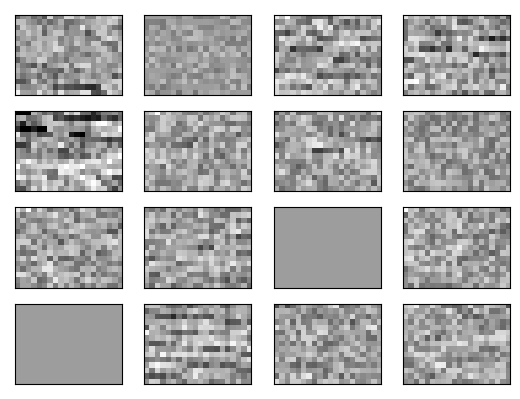

In [131]:
fig, axes = plt.subplots(4, 4)
# use global min / max to ensure all weights are shown on the same scale
vmin, vmax = clf.coefs_[0].min(), clf.coefs_[0].max()
for coef, ax in zip(clf.coefs_[0].T, axes.ravel()):
    ax.matshow(coef.reshape(15, 20), cmap=plt.cm.gray, vmin=0.5 * vmin, vmax=0.5 * vmax)
    ax.set_xticks(())
    ax.set_yticks(())

plt.show()

## 7) Conclusion
